# **Imports**

In [ ]:
!pip install pillow
!pip install augmentor
!pip install albumentations

     |████████████████████████████████| 631 kB 8.8 MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-py3-none-any.whl size=654020 sha256=84f9a2fa730ef96beb1988fe710412c8c2c2a3516f878dd59a732d2f5f9698be
  Stored in directory: /root/.cache/pip/wheels/89/72/98/3ebfdba1069a9a8eaaa7ae7265cfd67d63ef0197aaee2e5f9c
Successfully built imgaug
  Attempting uninstall: imgaug
    Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

import pylab as pl

from scipy.stats import normaltest
from scipy.stats import anderson
from scipy.stats import norm
from scipy import stats
from scipy.stats import shapiro

import statsmodels.stats.api as sms
from statsmodels.compat import lzip
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import het_breuschpagan

from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OneHotEncoder, FunctionTransformer, StandardScaler,PolynomialFeatures
from sklearn.compose import ColumnTransformer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import mean_absolute_error
from sklearn import metrics
from sklearn.model_selection import KFold, GridSearchCV, StratifiedKFold,cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import label_binarize

from tensorflow.estimator import LinearRegressor
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense

import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader, ConcatDataset
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset, random_split
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as transforms
import torchvision
import torch.optim as optim

from matplotlib.pyplot import imread, imshow, subplots, show
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers

import tensorflow
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.python.keras.models import Sequential
from tensorflow.keras import layers 
from tensorflow.keras import Model 
from tensorflow.keras import optimizers
from tensorflow.python.keras.layers import Dense, Flatten, GlobalAveragePooling2D

from os import listdir
from os.path import isfile, join

from tqdm.auto import tqdm
import os
from PIL import Image
import albumentations
import albumentations.pytorch
import cv2

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


# <center> **Regression**

## <center> **Predict the number of rented bikes aggregated by hour**

# Table of Contents

1. **[Description of features](#1)**
2. **[Functions](#2)**
3. **[Preprocessing](#3)**
	* [Dropping duplicates](#sub-heading1)
	* [Dealing with missing data](#sub-heading2)
	* [Feature engineering](#sub-heading3)
	* [Outliers](#sub-heading4)
4. **[EDA](#4)**
	* [Target variable](#sub-heading5)
	* [Numeric features](#sub-heading6)
	* [Distributions of categorical features](#sub-heading7)
	* [Multivariate analysis](#sub-heading8)
	* [Correlation](#sub-heading9)
	* [Correlation coefficients](#sub-heading)
5. **[Transformation](#5)**
	* [Encoding](#sub-heading)
	* [Log transformation](#sub-heading)
	* [Standartisation](#sub-heading)
	* [PCA](#sub-heading)
6. **[Split](#6)**
7. **[Models](#7)**
	* [PyTorch](#sub-heading)
	* [TensorFlow](#sub-heading)



In [ ]:
data = pd.read_csv('/content/drive/My Drive/DA/HW4/Data/AirQualityUCI.csv', sep=';',  na_values='-200')

In [ ]:
data.head().T

,0,1,2,3,4
Date,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004
Time,18.00.00,19.00.00,20.00.00,21.00.00,22.00.00
CO(GT),"2,6",2,"2,2","2,2","1,6"
PT08.S1(CO),1360,1292,1402,1376,1272
NMHC(GT),150,112,88,80,51
C6H6(GT),"11,9","9,4","9,0","9,2","6,5"
PT08.S2(NMHC),1046,955,939,948,836
NOx(GT),166,103,131,172,131
PT08.S3(NOx),1056,1174,1140,1092,1205
NO2(GT),113,92,114,122,116


# **Description of features**

In [ ]:
pd.read_csv('/content/drive/My Drive/DA/HW4/Data/data_descr.csv',
            delimiter=',', index_col=0,
            encoding='windows-1251')

,feature,description
id,,
0,Date,(DD/MM/YYYY)
1,Time,(HH.MM.SS)
2,CO(GT),True hourly averaged concentration CO in mg/m^3 (reference analyzer)
3,PT08.S1,(tin oxide) hourly averaged sensor response (nominally CO targeted)
4,NMHC(GT),True hourly averaged overall Non Metanic HydroCarbons concentration in microg/m^3 (reference analyzer)
5,C6H6(GT),True hourly averaged Benzene concentration in microg/m^3 (reference analyzer)
6,PT08.S2,(titania) hourly averaged sensor response (nominally NMHC targeted)
7,NOx(GT),True hourly averaged NOx concentration in ppb (reference analyzer)
8,PT08.S3,(tungsten oxide) hourly averaged sensor response (nominally NOx targeted)


In [ ]:
TARGET = 'C6H6(GT)'

# **Functions**

**Plotting histograms & transformations**

In [ ]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [ ]:
def draw_lognorm(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(np.log1p(data), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=np.log1p(data).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [ ]:
from scipy.special import boxcox1p

def draw_boxcox(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(boxcox1p(data, 0.25), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=boxcox1p(data, 0.25).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [ ]:
def count_skewness_kurtosis(data):
    print("Skewness: %f" % data.skew())
    print("Kurtosis: %f" % data.kurt())

In [ ]:
def draw_histograms(data, cols):
  count = 1
  for col in cols:
    ax_hist = plt.subplot(3,3,count,)
    sns.distplot(data[col], hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title(f"Distribution of {col}") 

    mean=data[col].mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()
    count += 1


**Numeric feat.**

In [ ]:
def get_numeric_analysis(data,col):
    skewness = data[col].skew()
    kurtosis = data[col].kurt()
    mean = data[col].mean()
    minval = data[col].min()
    maxval = data[col].max()
    st_dev = data[col].std()
    median = data[col].median()
    rangeval = maxval - minval
    points = mean-st_dev, mean+st_dev
    fig, axes = plt.subplots(1, 2,figsize=(6,5))
    data.boxplot(column=[col],  ax=axes[0])
    stats.probplot(data[col],plot=axes[1])
    fig.suptitle('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurtosis,2),
                                                                                                   round(skewness,2),
                                                                                                   (round(minval,2),round(maxval,2),round(rangeval,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)),fontsize="13")    

In [ ]:
def draw_num_scatter(data, cols):
  count = 1
  
  for col in cols:
    plt.figure(figsize=(15,9))
    plt.subplot(2,2,count,)
    plt.title(f'{col} Vs Target')
    plt.xlabel(f'{col}')
    plt.ylabel('Target')
    sns.scatterplot(x=data[col], y = data[TARGET])
    count += 1
    plt.show()

**Categorial feat.**

In [ ]:
def get_cat_analysis(data, cols):
  count = 1

  for col in cols:
    plt.figure(figsize=(9,8))
    plt.subplot(3,3,count,)
    plt.title(f'{col} Vs Target')
    plt.xlabel(f'{col}')
    plt.ylabel('Target')
    cat_list=data[col].unique()
    cat_average=data.groupby(col).mean()[TARGET]
    sns.barplot(x=cat_list, y=cat_average, palette="husl", data=data)
    count += 1
    plt.show()

**Methods to find outliers**

In [ ]:
def count_iqr(data):
  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1

  out = (data <(Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))
  for col in data.columns: 
    outer = (data[col] == True).sum()
    if outer != 0:
        print(f'{col} -> outliers: -> {outer}')

In [ ]:
def Zscore_outlier(df, feature_name):
    out= 0
    m = np.mean(df)
    sd = np.std(df)
    for i in df: 
        z = (i-m)/sd
        if np.abs(z) > 3: 
            out += 1
    print(f"{feature_name}:\nOutliers amount: {out}\n")

**Normality Tests**  
1) Shapiro-Wilk Test  
Tests whether a data sample has a Gaussian distribution.  

*Assumptions*  

Observations in each sample are independent and identically distributed (iid).  

*Interpretation*  

H0: the sample has a Gaussian distribution.  
H1: the sample does not have a Gaussian distribution.  

In [ ]:
def shapiro_normality_testing(data):
  stat, p = shapiro(data)
  print('stat=%.3f, p=%.3f' % (stat, p))
  if p > 0.05:
    print('Probably Gaussian')
  else:
    print('Probably not Gaussian')

**Plotting categor. features**

In [ ]:
def plot_cat_features(cat1:str, cat2:str):
    pl.subplot(2,2,1)
    n_poutcome = data[cat1].value_counts()
    genres = n_poutcome.index.values
    plt.stem(n_poutcome)
    plt.title(f'Frequency Distribution of {cat1}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat1}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()
    #
    pl.subplot(2,2,2)
    n_default = data[cat2].value_counts()
    genres = n_default.index.values
    plt.stem(n_default)
    plt.title(f'Frequency Distribution of {cat2}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat2}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()

**Target distrebutions (linear models)**

In [ ]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

**Different metrics**

In [ ]:
def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred, model, trainData, train_label):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

    mse_scorer = metrics.make_scorer(mse)
    rmse_scorer = metrics.make_scorer(rmse)
    mae_scorer = metrics.make_scorer(mae)
    R2_scorer = metrics.make_scorer(R2)
    MedAE_scorer = metrics.make_scorer(medae)
   
    mse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mse_scorer)
    rmse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=rmse_scorer)
    mae_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mae_scorer)
    R2_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=R2_scorer)
    MedAE_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=MedAE_scorer)

    print('*** Average cross-validation scores ***:')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(np.sum(mse_CV_score)/5,
                                                                         np.sum(rmse_CV_score)/5,
                                                                         np.sum(R2_CV_score)/5, 
                                                                         np.sum(mae_CV_score)/5,
                                                                         np.sum(MedAE_CV_score)/5))

    print('-'*30)

**Resudual analysis**

In [ ]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [ ]:
def test_goldfeldquandt(errors, testData):
  name = ['F statistic', 'p-value']
  test = sms.het_goldfeldquandt(errors, testData)
  print(lzip(name, test))

# **Preprocessing**

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         7765 non-null   object 
 3   PT08.S1(CO)    8991 non-null   float64
 4   NMHC(GT)       914 non-null    float64
 5   C6H6(GT)       9357 non-null   object 
 6   PT08.S2(NMHC)  8991 non-null   float64
 7   NOx(GT)        7718 non-null   float64
 8   PT08.S3(NOx)   8991 non-null   float64
 9   NO2(GT)        7715 non-null   float64
 10  PT08.S4(NO2)   8991 non-null   float64
 11  PT08.S5(O3)    8991 non-null   float64
 12  T              8991 non-null   object 
 13  RH             8991 non-null   object 
 14  AH             8991 non-null   object 
 15  Unnamed: 15    0 non-null      float64
 16  Unnamed: 16    0 non-null      float64
dtypes: float64(10), object(7)
memory usage: 1.2+ MB


### **Dropping duplicates**

Then I **drop duplicates** in Dataset.

In [ ]:
data.shape

(9471, 17)

In [ ]:
data.drop_duplicates(inplace=True)

In [ ]:
data.shape

(9358, 17)

* 113 duplicates were found & deleted.

### **Dealing with missing data**

Dropping columns - full of NaNs and having no description.

In [ ]:
data.drop(['Unnamed: 15',	'Unnamed: 16'],
           axis=1, inplace=True)
data.head(3).T

,0,1,2
Date,10/03/2004,10/03/2004,10/03/2004
Time,18.00.00,19.00.00,20.00.00
CO(GT),"2,6",2,"2,2"
PT08.S1(CO),1360,1292,1402
NMHC(GT),150,112,88
C6H6(GT),"11,9","9,4","9,0"
PT08.S2(NMHC),1046,955,939
NOx(GT),166,103,131
PT08.S3(NOx),1056,1174,1140
NO2(GT),113,92,114


Converting data types

In [ ]:
conv_to_float = ['CO(GT)', 'C6H6(GT)', 'T', 'RH', 'AH']
data = data.replace(',','.', regex=True)
for column in conv_to_float:
  data[column] = data[column].astype('float64')
data.head(3)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502


In [ ]:
data.dtypes

Date              object
Time              object
CO(GT)           float64
PT08.S1(CO)      float64
NMHC(GT)         float64
C6H6(GT)         float64
PT08.S2(NMHC)    float64
NOx(GT)          float64
PT08.S3(NOx)     float64
NO2(GT)          float64
PT08.S4(NO2)     float64
PT08.S5(O3)      float64
T                float64
RH               float64
AH               float64
dtype: object

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9358 entries, 0 to 9357
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         7765 non-null   float64
 3   PT08.S1(CO)    8991 non-null   float64
 4   NMHC(GT)       914 non-null    float64
 5   C6H6(GT)       9357 non-null   float64
 6   PT08.S2(NMHC)  8991 non-null   float64
 7   NOx(GT)        7718 non-null   float64
 8   PT08.S3(NOx)   8991 non-null   float64
 9   NO2(GT)        7715 non-null   float64
 10  PT08.S4(NO2)   8991 non-null   float64
 11  PT08.S5(O3)    8991 non-null   float64
 12  T              8991 non-null   float64
 13  RH             8991 non-null   float64
 14  AH             8991 non-null   float64
dtypes: float64(13), object(2)
memory usage: 1.1+ MB


I count all missing values and missing values in each column.

In [ ]:
data.isnull().sum()  # how many (total)

Date                1
Time                1
CO(GT)           1593
PT08.S1(CO)       367
NMHC(GT)         8444
C6H6(GT)            1
PT08.S2(NMHC)     367
NOx(GT)          1640
PT08.S3(NOx)      367
NO2(GT)          1643
PT08.S4(NO2)      367
PT08.S5(O3)       367
T                 367
RH                367
AH                367
dtype: int64

* ALL columns have missed values.
* This data contains many missing values, especially **NMHC(GT)** column (8444 from 9471). Probably, I'll delete this column later, afret checking it.   
* The next "winners" are **CO(GT), NOx(GT), NO2(GT)**. Have 1700+ missing values.



There are a lot of omissions on the **NMHC(GT)** feature(8444 out of 9471), so it **cannot be replaced with an average and not lose accuracy**. That's why i decided to delete it.

In [ ]:
data.drop('NMHC(GT)', axis=1, inplace=True)
data.head(3)

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502


**The most widely used methods to deal with missing data are:**  
1) create a new category for NaN values  
2) impute median/mode/mean(depends on data types) 
_______________________________________________
  
Of course, each method has its pros and cons, such:  
1)  
+: Simple and easy to implement for categorical variables/columns and preserves the variance.  
-: May create random data if the missing category is more.
Doesn’t give good results when missing data is a high percentage of the data.  

2)  
+: Simple and easy to implement.
-: Features having a max number of null values may bias prediction if replace with the most occurred category.
It distorts the relation of the most frequent label.

**Analyses of how to handle the missing data.**  

We'll consider that when more than/equal 50% of the data is missing, we should delete the corresponding variable and pretend it never existed. This means that we will not try any trick to fill the missing data in these cases. According to this, there is a set of variables that we should delete. 

**!** Firstly, I'll drop rows, where exist NaNs more than >= 8 (practically half). 
* In the end of DATASET we can observe a huge amount of rows - fully consist of missing data.

In [ ]:
total = data.isnull().sum().sort_values(ascending=False)
missing_data = pd.concat([total], axis=1, keys=['Total'])
missing_data.head(20)

,Total
NO2(GT),1643
NOx(GT),1640
CO(GT),1593
AH,367
RH,367
T,367
PT08.S5(O3),367
PT08.S4(NO2),367
PT08.S3(NOx),367
PT08.S2(NMHC),367


In [ ]:
inds = []
counter = 0
for i in range(len(data.index)):
  if data.iloc[i].isnull().sum() >= 10:
    counter += 1
    inds.append(i)
print('Rows with NaN >= 10: ', counter)

Rows with NaN >= 10:  45


In [ ]:
data.shape

(9358, 14)

In [ ]:
# data.dropna(thresh=10, inplace=True)
data.dropna(thresh=data.shape[1]-10, axis=0, inplace=True)

In [ ]:
data.shape

(9326, 14)

In [ ]:
total = data.isnull().sum().sort_values(ascending=False)
missing_data = pd.concat([total], axis=1, keys=['Total'])
missing_data.head(15)

,Total
NO2(GT),1611
NOx(GT),1608
CO(GT),1561
AH,335
RH,335
T,335
PT08.S5(O3),335
PT08.S4(NO2),335
PT08.S3(NOx),335
PT08.S2(NMHC),335


**Conclusion**  
* You may notice that the rows where there was more than half of the missing data are deleted.
* It is noticeable that all the omissions are almost in the same lines and the same number, perhaps you can try to explain the absence of such a large cluster of data by the fact that the devices failed at the end of the year/experiment, or at a certain time the concentration of the substance was so small that the sensors could not measure it.

In [ ]:
data.shape

(9326, 14)

In [ ]:
# summarize the number of rows with missing values for each column
for i in data.columns:
	# count number of rows with missing values
	n_miss = data[i].isnull().sum()
	perc = n_miss / data.shape[0] * 100
	print(f'Column: {i}\nAmount {n_miss}\n%{perc}\n')

Column: Date
Amount 0
%0.0

Column: Time
Amount 0
%0.0

Column: CO(GT)
Amount 1561
%16.738151404675104

Column: PT08.S1(CO)
Amount 335
%3.592108084923869

Column: C6H6(GT)
Amount 0
%0.0

Column: PT08.S2(NMHC)
Amount 335
%3.592108084923869

Column: NOx(GT)
Amount 1608
%17.242118807634572

Column: PT08.S3(NOx)
Amount 335
%3.592108084923869

Column: NO2(GT)
Amount 1611
%17.274286939738364

Column: PT08.S4(NO2)
Amount 335
%3.592108084923869

Column: PT08.S5(O3)
Amount 335
%3.592108084923869

Column: T
Amount 335
%3.592108084923869

Column: RH
Amount 335
%3.592108084923869

Column: AH
Amount 335
%3.592108084923869



Features *'NO2(GT)', 'NOx(GT)', 'CO(GT)', 'AH', 'RH', 'T', 'PT08.S5(O3)', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 
        'PT08.S2(NMHC)', 'PT08.S1(CO)'*  have  some missing data  (from 3 to 17 %),  I'm not sure, but think, that it is not a huge percentage and I can emplace missing data by using median value.  


In [ ]:
cols = ['NO2(GT)', 'NOx(GT)', 'CO(GT)', 'AH', 'RH', 'T', 'PT08.S5(O3)', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 
        'PT08.S2(NMHC)', 'PT08.S1(CO)']

for сolumn in cols:
    avarage = data.loc[:, сolumn].median(skipna = True)
    data.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}")   

NO2(GT): average value --> 109.0
NOx(GT): average value --> 180.0
CO(GT): average value --> 1.8
AH: average value --> 0.9954
RH: average value --> 49.6
T: average value --> 17.8
PT08.S5(O3): average value --> 963.0
PT08.S4(NO2): average value --> 1463.0
PT08.S3(NOx): average value --> 806.0
PT08.S2(NMHC): average value --> 909.0
PT08.S1(CO): average value --> 1063.0


In [ ]:
data.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

### **Feature engineering**

*Feature containes dates:*

* *date* - date of getting responses from an array of 5 metal oxide chemical sensors.

By themselves, dates will most likely not give anything when solving the regression problem. But from them you can get 3 potentially useful signs:
- **year** (2004 or 2005)
- **month** of taking measurements
- **day of the week** of taking measurements

In [ ]:
date = data['Date'].str.split('/')

Getting year

In [ ]:
from datetime import date

def get_year(my_date):
    my_date = my_date.split('/')
    return date(int(my_date[2]), int(my_date[1]),int(my_date[0])).year

In [ ]:
data['year'] = data.loc[:, 'Date'].apply(get_year)

In [ ]:
data['year'].value_counts()

2004    7079
2005    2247
Name: year, dtype: int64

Getting month

In [ ]:
def get_month(my_date):
    my_date = my_date.split('/')
    return date(int(my_date[2]), int(my_date[1]),int(my_date[0])).month

In [ ]:
data['month'] = data.loc[:, 'Date'].apply(get_month)

In [ ]:
data['month'].value_counts().sort_index()

1      744
2      672
3     1254
4      807
5      730
6      720
7      744
8      744
9      703
10     744
11     720
12     744
Name: month, dtype: int64

Getting day of a week

In [ ]:
import calendar

def get_day_of_week(my_date):
    my_date = my_date.split('/')
    my_date = date(int(my_date[2]), int(my_date[1]),int(my_date[0]))
    return calendar.day_name[my_date.weekday()] 

In [ ]:
data['day'] = data.loc[:, 'Date'].apply(get_day_of_week)

In [ ]:
data['day'].value_counts()

Thursday     1344
Saturday     1344
Sunday       1344
Friday       1344
Monday       1335
Tuesday      1314
Wednesday    1301
Name: day, dtype: int64

In [ ]:
data.drop('Date', axis=1, inplace=True)
data.head(3)

,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day
0,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004,3,Wednesday
1,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004,3,Wednesday
2,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004,3,Wednesday


Work with time

In [ ]:
data['Time'].unique()

array(['18.00.00', '19.00.00', '20.00.00', '21.00.00', '22.00.00',
       '23.00.00', '00.00.00', '01.00.00', '02.00.00', '03.00.00',
       '04.00.00', '05.00.00', '06.00.00', '07.00.00', '08.00.00',
       '09.00.00', '10.00.00', '11.00.00', '12.00.00', '13.00.00',
       '14.00.00', '15.00.00', '16.00.00', '17.00.00'], dtype=object)

In [ ]:
def get_day_time(hour):
  hour = hour.split('.')[0]
  if hour in [ '00', '01', '02', '03', '04', '05']:
    return 'night'
  elif hour in ['06', '07',  '08',  '09', '10', '11', '12']:
    return 'morning'
  elif hour in ['13', '14', '15',  '16', '17']:
    return 'day'
  elif hour in ['18', '19', '20', '21', '22', '23']:
    return 'evening'

In [ ]:
data['day_time'] = data.loc[:, 'Time'].apply(get_day_time)

data['day_time'].value_counts()

morning    2721
evening    2334
night      2328
day        1943
Name: day_time, dtype: int64

In [ ]:
data.drop(['Time'],
           axis=1, inplace=True)

### **Outliers**

IQR METHOD

In [ ]:
count_iqr(data)

CO(GT) -> outliers: -> 305
C6H6(GT) -> outliers: -> 30
T -> outliers: -> 7
month -> outliers: -> 744


Z-SCORE METHOD

In [ ]:
CAT = ['day_time', 'year', 'month', 'day']
NUMERICAL = data.select_dtypes(exclude=['category', 'object']).columns.tolist()
if TARGET in NUMERICAL:
    NUMERICAL.remove(TARGET)
    NUMERICAL.remove('year')
    NUMERICAL.remove('month')

In [ ]:
for col in NUMERICAL:
    Zscore_outlier(data[col], col)

CO(GT):
Outliers amount: 91

PT08.S1(CO):
Outliers amount: 70

PT08.S2(NMHC):
Outliers amount: 45

NOx(GT):
Outliers amount: 203

PT08.S3(NOx):
Outliers amount: 114

NO2(GT):
Outliers amount: 81

PT08.S4(NO2):
Outliers amount: 44

PT08.S5(O3):
Outliers amount: 48

T:
Outliers amount: 1

RH:
Outliers amount: 0

AH:
Outliers amount: 1



**Conclusion**
* I can delete outlier values if it is due to data entry error, data processing error or outlier observations are very small in numbers. I can also use trimming at both ends to remove outliers. 
* But deleting the observation is not a good idea when we have small dataset.

* Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.

So, later I would use some **transformation methods.**

# **EDA**

In [ ]:
data.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day,day_time
0,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004,3,Wednesday,evening
1,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004,3,Wednesday,evening
2,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004,3,Wednesday,evening
3,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004,3,Wednesday,evening
4,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004,3,Wednesday,evening


Descriptive statistics for numerical and categorical features.

In [ ]:
data.describe(include='all')

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day,day_time
count,9326.000000,9326.000000,9326.000000,9326.000000,9326.00000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326,9326
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,4
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Thursday,morning
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1344,2721
mean,0.121167,1098.510079,2.536693,938.070234,235.36232,834.434163,112.384516,1456.506541,1020.754235,18.299228,49.247341,1.024448,2004.240939,6.307420,NaN,NaN
std,19.910495,213.255277,39.775561,262.054731,195.38905,252.221787,44.021078,339.933498,391.419866,8.672554,17.003130,0.396532,0.427676,3.441579,NaN,NaN
min,-200.000000,647.000000,-200.000000,383.000000,2.00000,322.000000,2.000000,551.000000,221.000000,-1.900000,9.200000,0.184700,2004.000000,1.000000,NaN,NaN
25%,1.200000,941.000000,4.000000,742.000000,112.00000,665.000000,85.000000,1241.000000,741.000000,12.000000,36.500000,0.745500,2004.000000,3.000000,NaN,NaN
50%,1.800000,1063.000000,7.900000,909.000000,180.00000,806.000000,109.000000,1463.000000,963.000000,17.800000,49.600000,0.995400,2004.000000,6.000000,NaN,NaN
75%,2.600000,1222.000000,13.700000,1106.000000,285.00000,961.000000,133.000000,1662.750000,1257.000000,24.100000,61.900000,1.298625,2004.000000,9.000000,NaN,NaN


**Conclusion**  

* Since we are working with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. So, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

* To solve this problem, I later perform *STANDARDIZATION* of the data.

### **Target variable**

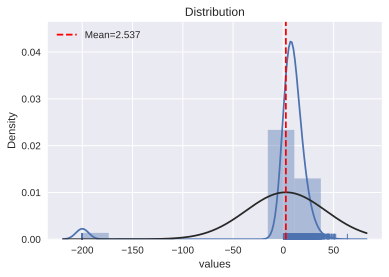

In [ ]:
draw_histogram(data[TARGET]) 

**Log transformation**

In [ ]:
draw_lognorm(data[TARGET])

Output hidden; open in https://colab.research.google.com to view.

* We see that the distribution seems to be more the normal one after lognorm transformation - it is more symmetrical now , domed, and  the variance turned out to be less. This is exactly what we assumed as the noise distribution.


**Testing normality**

In [ ]:
shapiro_normality_testing(data[TARGET])

stat=0.333, p=0.000
Probably not Gaussian


**Conclusion**
* This distribution is not normal.
* Before doing linear model, target should be log transformed.


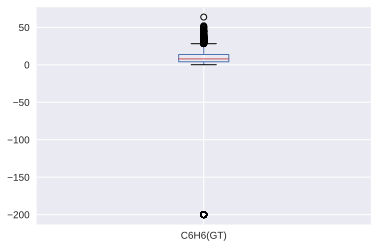

In [ ]:
data.boxplot(column=[TARGET])
plt.show()

**Conclusion** 
* This feature has many outlaiers, near 10+.
* The median is around 2.5, and 2.2 after log transformation.

### **Numeric features**

**CO(GT)**

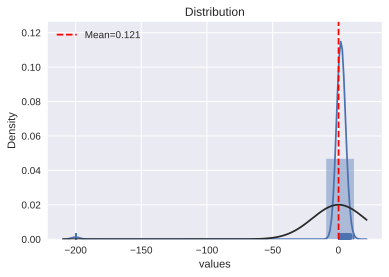

In [ ]:
draw_histogram(data['CO(GT)'])

In [ ]:
count_skewness_kurtosis(data['CO(GT)'])

Skewness: -9.908270
Kurtosis: 96.658558


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be log transformed.

**Log transformation**

In [ ]:
draw_lognorm(data['CO(GT)'])


Output hidden; open in https://colab.research.google.com to view.

**Testing normality**

In [ ]:
shapiro_normality_testing(data['CO(GT)'])

stat=0.106, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small left tail.

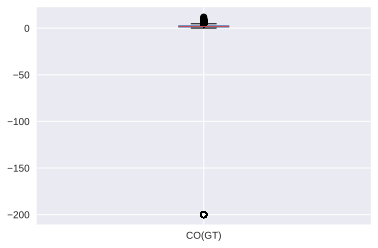

In [ ]:
data.boxplot(column=['CO(GT)'])

**Conclusion** 
* This feature has some outlaiers, from near 0.
* The median is around 0.1.

**PT08.S1(CO)**

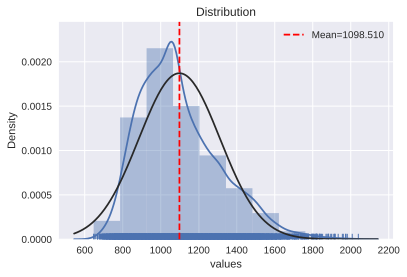

In [ ]:
draw_histogram(data['PT08.S1(CO)'])

In [ ]:
count_skewness_kurtosis(data['PT08.S1(CO)'])

Skewness: 0.787095
Kurtosis: 0.471594


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is not strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.

**Testing normality**

In [ ]:
shapiro_normality_testing(data['PT08.S1(CO)'])

stat=0.960, p=0.000
Probably not Gaussian


**Conclusion**:
* From about 1800 to 2200, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['PT08.S1(CO)'].describe()

count    9326.000000
mean     1098.510079
std       213.255277
min       647.000000
25%       941.000000
50%      1063.000000
75%      1222.000000
max      2040.000000
Name: PT08.S1(CO), dtype: float64

**Conclusion**

* For the *PT08.S1(CO)* attribute, it can be seen that the *MAX* value is 2040, while the *75% quartile* is 1200+.
The value 2040 is an *outlier*.
* Lets see at a *boxplot* to prove this.

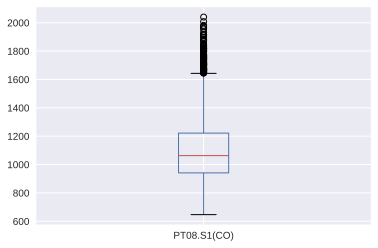

In [ ]:
data.boxplot(column=['PT08.S1(CO)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1700 to 2000+.
* The median is around 1100.


**PT08.S2(NMHC)**

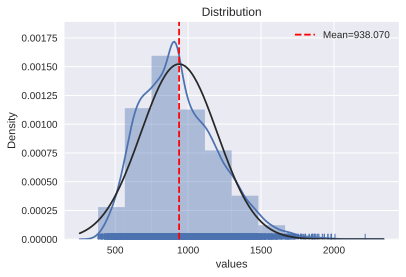

In [ ]:
draw_histogram(data['PT08.S2(NMHC)'])

In [ ]:
count_skewness_kurtosis(data['PT08.S2(NMHC)'])

Skewness: 0.583883
Kurtosis: 0.184036


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.

In [ ]:
shapiro_normality_testing(data['PT08.S2(NMHC)'])

stat=0.977, p=0.000
Probably not Gaussian


**Conclusion:**

* From about 1600 to 2000+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['PT08.S2(NMHC)'].describe()

count    9326.000000
mean      938.070234
std       262.054731
min       383.000000
25%       742.000000
50%       909.000000
75%      1106.000000
max      2214.000000
Name: PT08.S2(NMHC), dtype: float64

**Conclusion**

* For the *PT08.S2(NMHC)* attribute, it can be seen that the *MAX* value is 2000+, while the *75% quartile* is 1000+.
The value 2000+ is an *outlier*.
* Lets see at a *boxplot* to prove this.

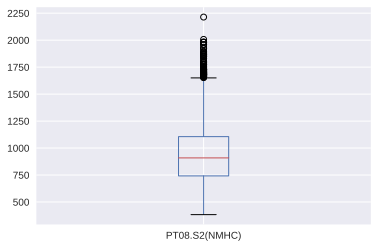

In [ ]:
data.boxplot(column=['PT08.S2(NMHC)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1750 to 2250.
* The median is around 940.


**NOx(GT)**

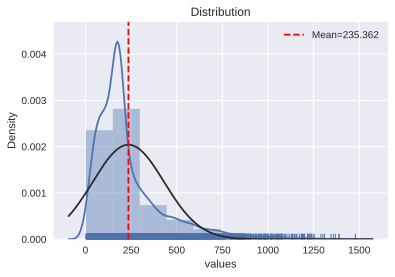

In [ ]:
draw_histogram(data['NOx(GT)'])

**Log transformation**

In [ ]:
draw_lognorm(data['NOx(GT)'])

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
count_skewness_kurtosis(data['NOx(GT)'])

Skewness: 2.009298
Kurtosis: 4.934986


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['NOx(GT)'])

stat=0.801, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 750 to 1500, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a left tail.

In [ ]:
data['NOx(GT)'].describe()

count    9326.00000
mean      235.36232
std       195.38905
min         2.00000
25%       112.00000
50%       180.00000
75%       285.00000
max      1479.00000
Name: NOx(GT), dtype: float64

**Conclusion**
* For the *NOx(GT)* attribute, it can be seen that the *MAX* value is 1479, while the *75% quartile* is 285.
The value 1479 is an *outlier*.
* Lets see at a *boxplot* to prove this.

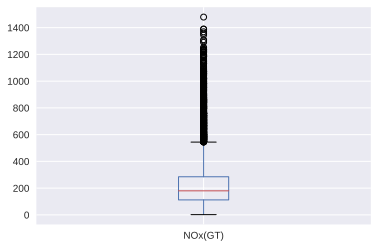

In [ ]:
data.boxplot(column=['NOx(GT)'])

**Conclusion**
* This feature has many outlaiers around 600+.
* The median is around 235.

**PT08.S3(NOx)**

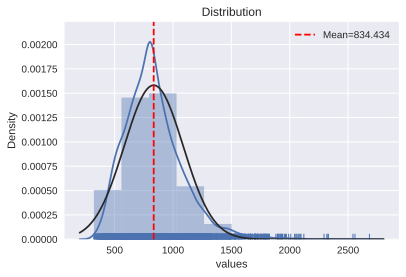

In [ ]:
draw_histogram(data['PT08.S3(NOx)'])

In [ ]:
count_skewness_kurtosis(data['PT08.S3(NOx)'])

Skewness: 1.133809
Kurtosis: 2.902439


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a long right tail.

**Testing normality**

In [ ]:
shapiro_normality_testing(data['PT08.S3(NOx)'])

stat=0.944, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 1500 to 2500+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['PT08.S3(NOx)'].describe()

count    9326.000000
mean      834.434163
std       252.221787
min       322.000000
25%       665.000000
50%       806.000000
75%       961.000000
max      2683.000000
Name: PT08.S3(NOx), dtype: float64

**Conclusion**
* For the *PT08.S3(NOx)* attribute, it can be seen that the *MAX* value is 2683, while the *75% quartile* is 969.
The value 2683 is an *outlier*.
* Lets see at a *boxplot* to prove this.

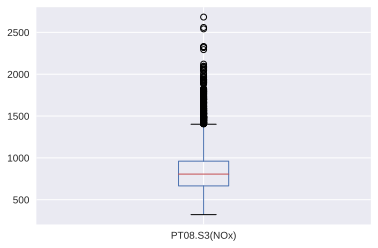

In [ ]:
data.boxplot(column=['PT08.S3(NOx)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1500+.
* The median is around 800.

**NO2(GT)**

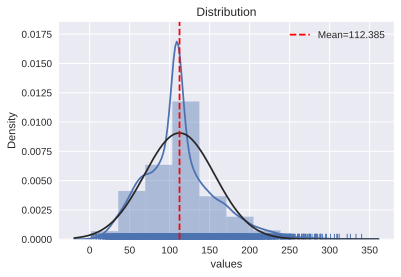

In [ ]:
draw_histogram(data['NO2(GT)'])

In [ ]:
count_skewness_kurtosis(data['NO2(GT)'])

Skewness: 0.730301
Kurtosis: 1.223602


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['NO2(GT)'])

stat=0.961, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 250 to 350, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['NO2(GT)'].describe()

count    9326.000000
mean      112.384516
std        44.021078
min         2.000000
25%        85.000000
50%       109.000000
75%       133.000000
max       340.000000
Name: NO2(GT), dtype: float64

**Conclusion**
* For the *NO2(GT)* attribute, it can be seen that the *MAX* value is 333, while the *75% quartile* is 132.
The value 333 is an *outlier*.
* Lets see at a *boxplot* to prove this.

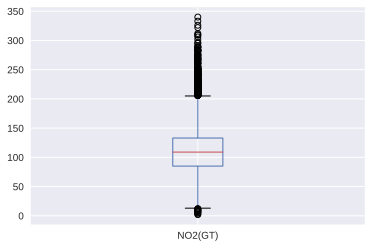

In [ ]:
data.boxplot(column=['NO2(GT)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 200 to 300+ and around 0 to 30.
* The median is around 111.

**PT08.S4(NO2)**

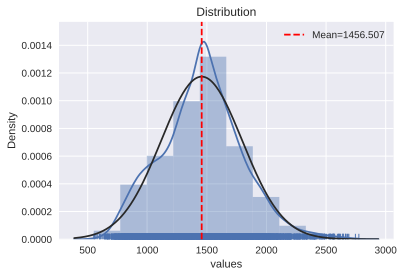

In [ ]:
draw_histogram(data['PT08.S4(NO2)'])

In [ ]:
count_skewness_kurtosis(data['PT08.S4(NO2)'])

Skewness: 0.207039
Kurtosis: 0.192034


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['PT08.S4(NO2)'])

stat=0.993, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2500 to 3000, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a small right tail.

In [ ]:
data['PT08.S4(NO2)'].describe()

count    9326.000000
mean     1456.506541
std       339.933498
min       551.000000
25%      1241.000000
50%      1463.000000
75%      1662.750000
max      2775.000000
Name: PT08.S4(NO2), dtype: float64

**Conclusion**
* For the *PT08.S4(NO2)* attribute, it can be seen that the *MAX* value is 2775, while the *75% quartile* is 1600+.
The value 2775 is an *outlier*.
* Lets see at a *boxplot* to prove this.

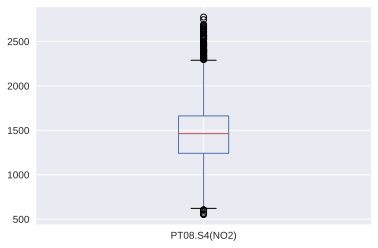

In [ ]:
data.boxplot(column=['PT08.S4(NO2)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2400+ and near 500.
* The median is around 1400.


**PT08.S5(O3)**

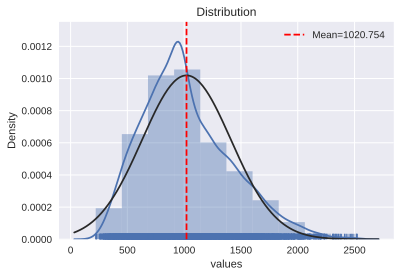

In [ ]:
draw_histogram(data['PT08.S5(O3)'])

In [ ]:
count_skewness_kurtosis(data['PT08.S5(O3)'])

Skewness: 0.655041
Kurtosis: 0.202398


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['PT08.S5(O3)'])

stat=0.970, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2500+ we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['PT08.S5(O3)'].describe()

count    9326.000000
mean     1020.754235
std       391.419866
min       221.000000
25%       741.000000
50%       963.000000
75%      1257.000000
max      2523.000000
Name: PT08.S5(O3), dtype: float64

**Conclusion**
* For the *PT08.S5(O3)* attribute, it can be seen that the *MAX* value is 2523, while the *75% quartile* is 1273.
The value 2523 is an *outlier*.
* Lets see at a *boxplot* to prove this.

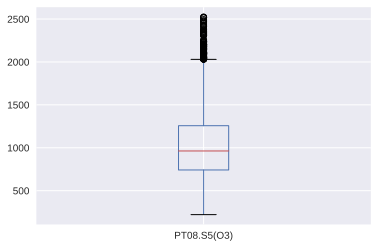

In [ ]:
data.boxplot(column=['PT08.S5(O3)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2000 to 2550.
* The median is around 1000.

**T**

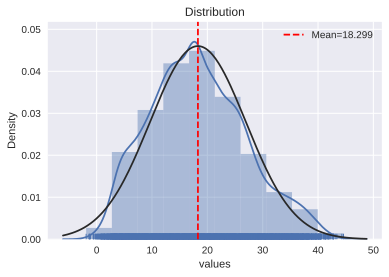

In [ ]:
draw_histogram(data['T'])

In [ ]:
count_skewness_kurtosis(data['T'])

Skewness: 0.321435
Kurtosis: -0.359395


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['T'])

stat=0.987, p=0.000
Probably not Gaussian


**Conclusion:**
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.


In [ ]:
data['T'].describe()

count    9326.000000
mean       18.299228
std         8.672554
min        -1.900000
25%        12.000000
50%        17.800000
75%        24.100000
max        44.600000
Name: T, dtype: float64

**Conclusion**
* For the *T* attribute, it can be seen that the *MAX* value is 44, while the *75% quartile* is 24.
The value 44 is an *outlier*.
* Lets see at a *boxplot* to prove this.

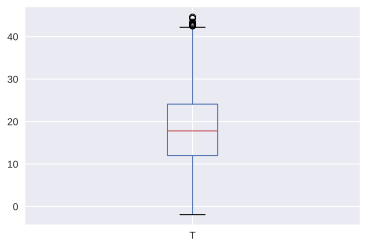

In [ ]:
data.boxplot(column=['T'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 45 to 47.
* The median is around 18.

**RH**

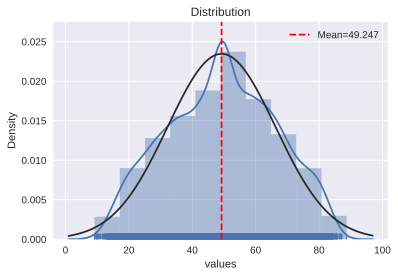

In [ ]:
draw_histogram(data['RH'])

In [ ]:
count_skewness_kurtosis(data['RH'])

Skewness: -0.040945
Kurtosis: -0.737010


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all.

**Testing normality**

In [ ]:
shapiro_normality_testing(data['RH'])

stat=0.987, p=0.000
Probably not Gaussian


**Conclusion:**
* Looking at destribution it is heard to say about outliers.
* The distribution resembles to be not a normal one.

In [ ]:
data['RH'].describe()

count    9326.000000
mean       49.247341
std        17.003130
min         9.200000
25%        36.500000
50%        49.600000
75%        61.900000
max        88.700000
Name: RH, dtype: float64

**Conclusion**
* For the *RH* attribute, it can be seen that the *MAX* value is 88, while the *75% quartile* is 62.
The value 88 is an *outlier*.
* Lets see at a *boxplot* to prove this.

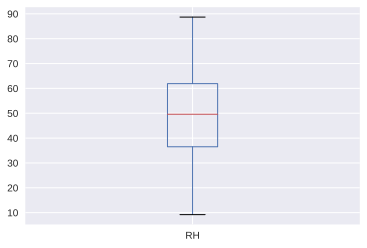

In [ ]:
data.boxplot(column=['RH'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* The median is around 49.

**AH**

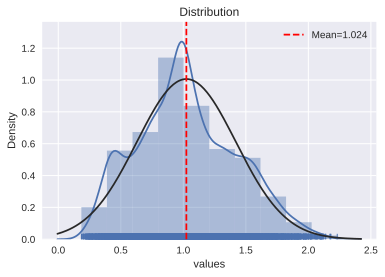

In [ ]:
draw_histogram(data['AH'])

In [ ]:
count_skewness_kurtosis(data['AH'])

Skewness: 0.264124
Kurtosis: -0.467337


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [ ]:
shapiro_normality_testing(data['AH'])

stat=0.986, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2.3+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [ ]:
data['AH'].describe()

count    9326.000000
mean        1.024448
std         0.396532
min         0.184700
25%         0.745500
50%         0.995400
75%         1.298625
max         2.231000
Name: AH, dtype: float64

**Conclusion**
* For the *AH* attribute, it can be seen that the *MAX* value is 2, while the *75% quartile* is 1.
The value 2 is an *outlier*.
* Lets see at a *boxplot* to prove this.

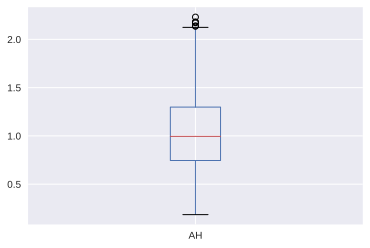

In [ ]:
data.boxplot(column=['AH'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2.5.
* The median is around 1.

### **Distributions of categorical features**

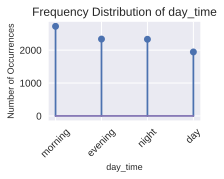

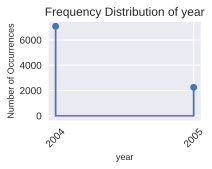

In [ ]:
plot_cat_features('day_time', 'year')

**Conclusion**  
* The "day_time" feature has the most observations at "morning" time (6:00-12:00).
* The "year" attribute has the most observations in "2004".

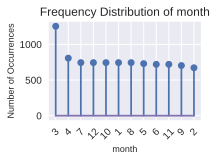

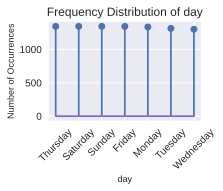

In [ ]:
plot_cat_features('month', 'day')

**Conclusion**
* The "month" attribute has the most observations in the "3" month (March).
* The "day" attribute has practicaly the same distribution for each day.

### **Multivariate analysis**
Analysis of variables I thought which are important.

**The relationship between TARGET and year**

In [ ]:
data.groupby(['year'])['C6H6(GT)'].mean()

year
2004    4.769586
2005   -4.497864
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by year')

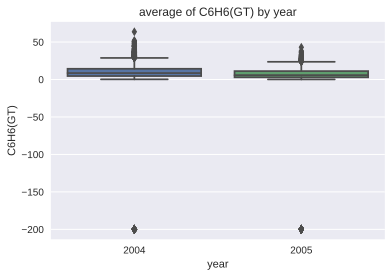

In [ ]:
ax = sns.boxplot(x='year',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by year')

In [ ]:
ym_targ = data.groupby(['year', 'month']).agg({TARGET:np.mean})
ym_targ

C6H6(GT)
year month           
2004 3       9.932745
     4       2.499583
     5      10.219041
     6      -0.519028
     7      10.316398
     8      -6.638978
     9      11.253627
     10     13.238306
     11     12.511806
     12    -13.027957
2005 1      -8.113172
     2     -15.966518
     3       8.449194
     4       4.285057

* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.
* So, that is why,  the years 2004-2005 have a different distribution of months and do not carry important information for further training of the model, so **it is worth removing this feature in the future.**


**The relationship between TARGET and day_time**

In [ ]:
data.groupby(['day_time'])['C6H6(GT)'].mean()

day_time
day        3.272362
evening    4.001414
morning    4.811099
night     -2.204167
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by day_time')

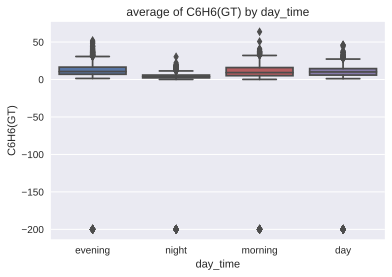

In [ ]:
ax = sns.boxplot(x='day_time',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by day_time')

**Conclusion**
* It can be noted that between 6:00-12:00 (morning) there were peaks in the measurements of the true hourly average concentration of benzene in micrograms/m3.
* The largest average value can be observed in the morning, day and evening.
* The smallest average is observed at night.
* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.

**The relationship between TARGET and month**

Text(0.5, 1.0, 'average of C6H6(GT) by month')

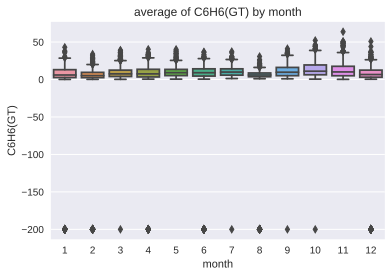

In [ ]:
ax = sns.boxplot(x='month',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by month')

In [ ]:
data.groupby(['month'])['C6H6(GT)'].sum()

month
1     -6036.2
2    -10729.5
3     11351.9
4      2172.5
5      7459.9
6      -373.7
7      7675.4
8     -4939.4
9      7911.3
10     9849.3
11     9008.5
12    -9692.8
Name: C6H6(GT), dtype: float64

**Conclusion**
* In October, November (10-11 months), there were the largest indicators of the substance.
* In February (2 month), the lowest indicators were the concentration of benzene in micrograms / m3.
* The largest average value can be observed in the 10th month(October).
* The smallest average is observed in the 8th month (August).
* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.


**The relationship between TARGET and day**

In [ ]:
data.groupby(['day'])['C6H6(GT)'].sum()

day
Friday      -5831.6
Monday       6572.2
Saturday     8097.5
Sunday       2569.0
Thursday      685.0
Tuesday      7303.7
Wednesday    4261.4
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by day of week')

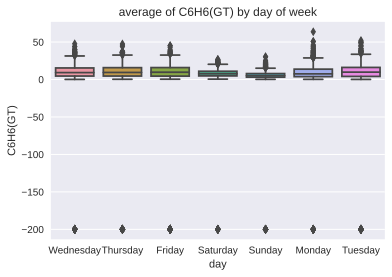

In [ ]:
ax = sns.boxplot(x='day',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by day of week')

**Conclusion**
* On Sundays, there was a lower concentration of benzene in the air, perhaps this is justified by the weekend, and less activity at factories, for example.
* The highest concentration of benzene in the air was observed from Tuesday to Thursday-working days.
* The largest average value can be observed from Tuesday to Fridays.
* The smallest average is observed on Sundays.

In [ ]:
print('average of C6H6(GT) by day & day_time')
print(data.groupby(['day', 'day_time'])['C6H6(GT)'].mean())

average of C6H6(GT) by day & day_time
day        day_time
Friday     day         -2.620714
           evening     -2.824702
           morning     -2.193112
           night       -9.788690
Monday     day          6.236823
           evening      7.922424
           morning      8.009694
           night       -2.707143
Saturday   day          5.736429
           evening      6.886012
           morning      8.768367
           night        2.203571
Sunday     day          1.996071
           evening      2.827976
           morning      0.924235
           night        2.076190
Thursday   day         -0.715714
           evening      3.404464
           morning      1.757653
           night       -2.819940
Tuesday    day          8.459273
           evening      2.824383
           morning     10.902597
           night       -0.409697
Wednesday  day          3.960886
           evening      6.997321
           morning      5.651330
           night       -4.050314
Name: C6H6(GT), dt

In [ ]:
print('average of C6H6(GT) by month & day_time')
print(data.groupby(['month', 'day_time'])['C6H6(GT)'].mean())

average of C6H6(GT) by month & day_time
month  day_time
1      day         -3.677419
       evening    -11.759677
       morning     -4.729493
       night      -12.110753
2      day        -16.456429
       evening    -16.017857
       morning    -14.208163
       night      -17.558333
3      day          9.699231
       evening     13.136164
       morning      9.645055
       night        3.660256
4      day          1.149701
       evening      6.012626
       morning      5.434874
       night       -2.468137
5      day         11.229032
       evening     12.398343
       morning     12.398131
       night        4.567222
6      day         -1.338000
       evening     -0.677778
       morning      5.493810
       night       -6.692778
7      day         10.083226
       evening     13.271505
       morning     12.894931
       night        4.547312
8      day         -9.707097
       evening     -7.537097
       morning     -4.429032
       night       -5.762366
9      day      

* The highest concentrations of benzene in the air are observed in the evening on all days and any months.

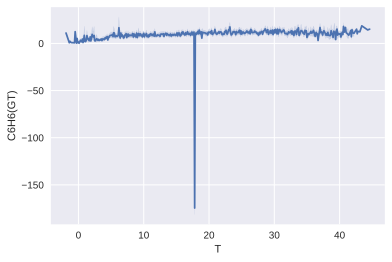

In [ ]:
sns.lineplot(data=data, x="T", y="C6H6(GT)")

* A slight increase in benzene indicators in the air is visible from 10 to 35 degrees
* At 42+ degrees, the indicators also grow.
* The lowest values of benzene at 0 degrees.
* Guess, that it's an outlier near 20 degrees.

### **Correlation**

* Evaluation of the pairwise dependencies of numerical features.
* Calculation and visualization of the correlation matrix.

In [ ]:
corr_features = NUMERICAL.copy()
corr_features.append('C6H6(GT)')
corr_features

['CO(GT)',
 'PT08.S1(CO)',
 'PT08.S2(NMHC)',
 'NOx(GT)',
 'PT08.S3(NOx)',
 'NO2(GT)',
 'PT08.S4(NO2)',
 'PT08.S5(O3)',
 'T',
 'RH',
 'AH',
 'C6H6(GT)']

In [ ]:
num_data = data.loc[:,corr_features]
corr_matrix = num_data.corr(method='spearman').round(4)
corr_matrix

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,C6H6(GT)
CO(GT),1.0000,0.7702,0.8196,0.7044,-0.7123,0.6685,0.5428,0.7578,0.0835,-0.0191,0.0596,0.7538
PT08.S1(CO),0.7702,1.0000,0.8877,0.6163,-0.8526,0.5790,0.6422,0.8934,0.0806,0.0914,0.1352,0.8411
PT08.S2(NMHC),0.8196,0.8877,1.0000,0.5966,-0.8475,0.5764,0.7457,0.8714,0.2757,-0.1240,0.1890,0.9461
NOx(GT),0.7044,0.6163,0.5966,1.0000,-0.6832,0.8148,0.1241,0.6880,-0.2557,0.1648,-0.1647,0.5478
PT08.S3(NOx),-0.7123,-0.8526,-0.8475,-0.6832,1.0000,-0.5984,-0.5326,-0.8606,-0.1189,-0.0829,-0.2164,-0.8038
NO2(GT),0.6685,0.5790,0.5764,0.8148,-0.5984,1.0000,0.1319,0.6168,-0.1632,-0.1089,-0.2801,0.5260
PT08.S4(NO2),0.5428,0.6422,0.7457,0.1241,-0.5326,0.1319,1.0000,0.5566,0.6140,-0.0681,0.6411,0.7069
PT08.S5(O3),0.7578,0.8934,0.8714,0.6880,-0.8606,0.6168,0.5566,1.0000,-0.0019,0.1271,0.0804,0.8261
T,0.0835,0.0806,0.2757,-0.2557,-0.1189,-0.1632,0.6140,-0.0019,1.0000,-0.5394,0.7014,0.2600
RH,-0.0191,0.0914,-0.1240,0.1648,-0.0829,-0.1089,-0.0681,0.1271,-0.5394,1.0000,0.1524,-0.1151


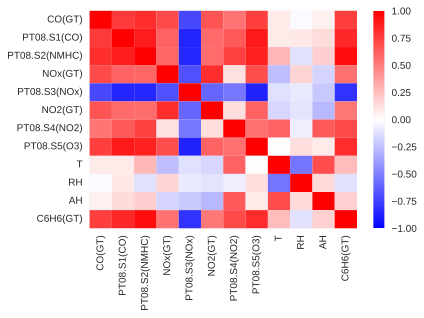

In [ ]:
sns.heatmap(corr_matrix, vmin=-1, vmax=1, cmap='bwr')

**Conclusion**  
* It is important to understand that if the variables are strongly related to each other, then this can affect the training of the model in a bad way. The model will not adequately, in particular the linear model, calculate the weights and parameters of the model.

* At first glance, it is possible to distinguish a pair of red squares, the greatest dependence is observed between these features. **'CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)'(srtong negative corr), 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)'**

* Target variable also highly correlated with practically all features, except 'RH'.
* The correlation between these features is extremely strong, which may indicate a situation of multicollinearity.

* It can be concluded that they give almost the same information, so multicollinearity really takes place.

### **Correlation coefficients**

See multicollinearity between some features:

**'PT08.S1(CO)' & 'PT08.S2(NMHC)'**

In [ ]:
np.corrcoef(data['PT08.S1(CO)'], data['PT08.S2(NMHC)'])

array([[1.        , 0.89298663],
       [0.89298663, 1.        ]])

* This correlation is 0.89, a strong positive correlation, let’s take a look at a scatter chart.

In [ ]:
sns.pairplot(data.loc[:, ['PT08.S1(CO)', 'PT08.S2(NMHC)']])

Output hidden; open in https://colab.research.google.com to view.

* Can observe some outliers.

**NOx(GT) & NO2(GT)**

In [ ]:
np.corrcoef(data['NOx(GT)'], data['NO2(GT)'])

array([[1.        , 0.76075219],
       [0.76075219, 1.        ]])

* This correlation is 0.76, a positive correlation, let’s take a look at a scatter chart.

In [ ]:
sns.pairplot(data.loc[:, ['NOx(GT)', 'NO2(GT)']])

Output hidden; open in https://colab.research.google.com to view.

**'PT08.S1(CO)' & 'PT08.S5(O3)'**

In [ ]:
  np.corrcoef(data['PT08.S1(CO)'], data['PT08.S5(O3)'])

array([[1.        , 0.89940966],
       [0.89940966, 1.        ]])

* This correlation is 0.899, a strong positive correlation, let’s take a look at a scatter chart.

In [ ]:
sns.pairplot(data.loc[:, ['PT08.S1(CO)', 'PT08.S5(O3)']])

Output hidden; open in https://colab.research.google.com to view.

**Conclusion**  
* There are srting correlations between features, hence conclude the presence of multicollinearity in the data.

See spearman r coeff between target & some features:

**Target & PT08.S1(CO)**

In [ ]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S1(CO)'])

SpearmanrResult(correlation=0.8411356336188819, pvalue=0.0)

This correlation is 0.84, a strong positive correlation.

**Target & PT08.S2(NMHC)**

In [ ]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S2(NMHC)'])

SpearmanrResult(correlation=0.9461491561634096, pvalue=0.0)

This correlation is practically 0.95, a positive correlation.

**Target & NOx(GT)**

In [ ]:
stats.spearmanr(data['C6H6(GT)'], data['NOx(GT)'])

SpearmanrResult(correlation=0.5478462371598455, pvalue=0.0)

This correlation is 0.5. It's not a very strong positive correlation.

**Target & NO2(GT)**

In [ ]:
stats.spearmanr(data['C6H6(GT)'], data['NO2(GT)'])

SpearmanrResult(correlation=0.526041029355615, pvalue=0.0)

This correlation is 0.53. It's not a very strong positive correlation.

**Target & PT08.S4(NO2)**

In [ ]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S4(NO2)'])

SpearmanrResult(correlation=0.7069396220904087, pvalue=0.0)

This correlation is 0.7, a strong positive correlation.

**Conclusion**  
* The highest correlation with target have *'PT08.S2(NMHC)', 'PT08.S1(CO)'* and *'PT08.S4(NO2)'* features.
* From the above correlation heatmap, we can observe that the variables: 'PT08.S2(NMHC)', 'PT08.S1(CO)', 'PT08.S4(NO2)' and TARGET are highly correlated (searman coefficient> 0.7) with each other.

# **Transformation**

### **Encoding**

In [ ]:
# dropping was proved earlier
data.drop(['year'],
           axis=1, inplace=True)
data.head(3)

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,month,day,day_time
0,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,3,Wednesday,evening
1,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,3,Wednesday,evening
2,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,3,Wednesday,evening


In [ ]:
data = pd.get_dummies(data, columns = ['day_time', 'month', 'day'])
data.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,day_time_day,day_time_evening,day_time_morning,day_time_night,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,day_Friday,day_Monday,day_Saturday,day_Sunday,day_Thursday,day_Tuesday,day_Wednesday
0,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
3,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9326 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            9326 non-null   float64
 1   PT08.S1(CO)       9326 non-null   float64
 2   C6H6(GT)          9326 non-null   float64
 3   PT08.S2(NMHC)     9326 non-null   float64
 4   NOx(GT)           9326 non-null   float64
 5   PT08.S3(NOx)      9326 non-null   float64
 6   NO2(GT)           9326 non-null   float64
 7   PT08.S4(NO2)      9326 non-null   float64
 8   PT08.S5(O3)       9326 non-null   float64
 9   T                 9326 non-null   float64
 10  RH                9326 non-null   float64
 11  AH                9326 non-null   float64
 12  day_time_day      9326 non-null   uint8  
 13  day_time_evening  9326 non-null   uint8  
 14  day_time_morning  9326 non-null   uint8  
 15  day_time_night    9326 non-null   uint8  
 16  month_1           9326 non-null   uint8  


### **Log transformation**  




In EDA part I note that features *'CO(GT), 'NOx(GT)' and TARGET* should be log transformed.

In [ ]:
cols_to_log = ['CO(GT)', 'NOx(GT)', TARGET]

for col in cols_to_log:
  data[col] = np.log1p(data[col])

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9326 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            9235 non-null   float64
 1   PT08.S1(CO)       9326 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     9326 non-null   float64
 4   NOx(GT)           9326 non-null   float64
 5   PT08.S3(NOx)      9326 non-null   float64
 6   NO2(GT)           9326 non-null   float64
 7   PT08.S4(NO2)      9326 non-null   float64
 8   PT08.S5(O3)       9326 non-null   float64
 9   T                 9326 non-null   float64
 10  RH                9326 non-null   float64
 11  AH                9326 non-null   float64
 12  day_time_day      9326 non-null   uint8  
 13  day_time_evening  9326 non-null   uint8  
 14  day_time_morning  9326 non-null   uint8  
 15  day_time_night    9326 non-null   uint8  
 16  month_1           9326 non-null   uint8  


In [ ]:
data.dropna(subset = [TARGET], inplace=True)

In [ ]:
for сolumn in ['CO(GT)']:
    avarage = data.loc[:, сolumn].median(skipna = True)
    data.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}") 

CO(GT): average value --> 1.0296194171811583


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8991 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            8991 non-null   float64
 1   PT08.S1(CO)       8991 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     8991 non-null   float64
 4   NOx(GT)           8991 non-null   float64
 5   PT08.S3(NOx)      8991 non-null   float64
 6   NO2(GT)           8991 non-null   float64
 7   PT08.S4(NO2)      8991 non-null   float64
 8   PT08.S5(O3)       8991 non-null   float64
 9   T                 8991 non-null   float64
 10  RH                8991 non-null   float64
 11  AH                8991 non-null   float64
 12  day_time_day      8991 non-null   uint8  
 13  day_time_evening  8991 non-null   uint8  
 14  day_time_morning  8991 non-null   uint8  
 15  day_time_night    8991 non-null   uint8  
 16  month_1           8991 non-null   uint8  


### **Box-Cox**
* I also tried to use box-cox data transformation to avoid heteroscedasticity in the data, as one of the techniques, but the *Breush-Pagan* and *Goldfeld Quandt* tests showed that heteroscedasticity is preserved even when using this technique.
* In conclusion, I will describe the techniques that you can also try to use to improve the model and confirm the reliability of the results.



In [ ]:
# from scipy.special import boxcox1p
# cols = ['PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'NO2(GT)','PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH', 'CO(GT)', TARGET,'NOx(GT)' ]
# for column in cols:
#   data[column] = boxcox1p(data[column],0.25)

### **Standartisation**

Since we work with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. Thus, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

To solve this problem, I STANDARDIZE the data before analyzing it.

In [ ]:
std_scaler = StandardScaler()
df = pd.DataFrame(std_scaler.fit_transform(data), columns=data.columns, index=data.index)

### **PCA**  
* PCA solves the issue of eigenvectors/values. We apply PCA to remove colinearity during the training phase of linear regression and neural networks. PCA resembles a low-dimensional representation of the observations that explains a good fraction of the variance .
* We can use PCA to reduce the number of variables, avoid multicollinearity, or have too many predictors relative to the number of observations. PCA is a linear combination of the p features, and taking these linear combinations of the measurements is essential to reduce the number of plots necessary for visual analysis while retaining most of the information present in the data.
* Feature reduction is an essential preprocessing step in machine learning. Therefore, PCA is an essential step of preprocessing and very useful for compression and noise removal in the data. It reduces the dimensionality of a dataset by finding a new set of variables smaller than the original set of variables.


* We do not need it for dimesionality reduction of course, as our model is not that complex, We need to remove the multicollinearity problem in our data.

* We are going to feed in our standardized predictor variables into the the PCA transformation and get a set of uncorrelated features.

In [ ]:
from sklearn.decomposition import PCA

cols = ['PCA' + str(i) for i in range(1,35)]
pca = PCA(n_components=34)
X = df.drop(TARGET,axis=1)
X_pca = pca.fit_transform(X)
df_std_pca = pd.DataFrame(X_pca,columns=cols, index=df.index)
df_std_pca[TARGET] = df[TARGET]

* Lets look at the correlation matrix now.

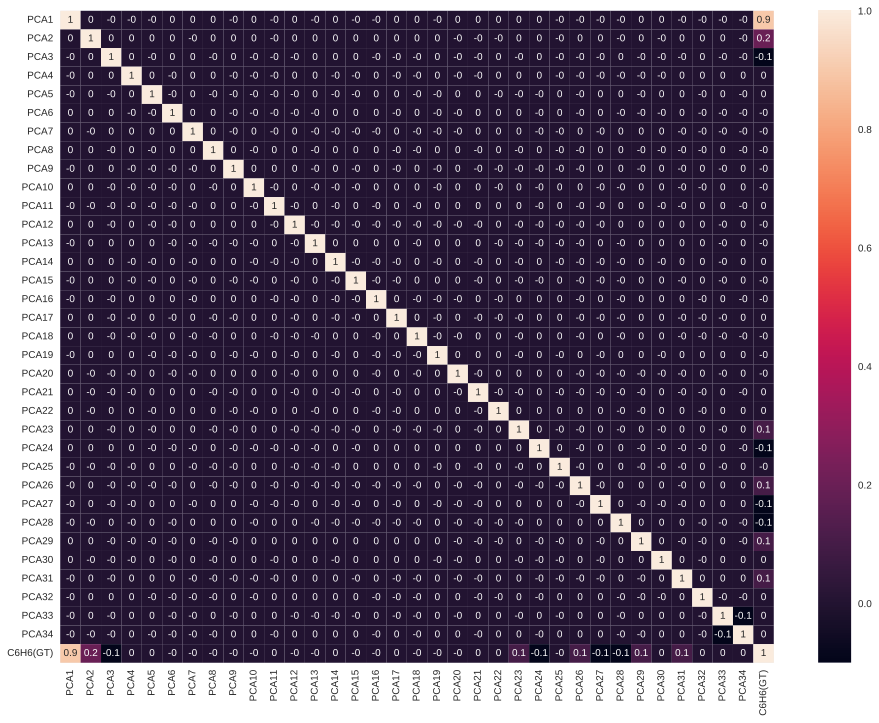

In [ ]:
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(111)
sns.heatmap(df_std_pca.corr().round(1),annot=True)

* As you can see there is no correlation between predictor variables, thus removing multicollinearity.
* The reason correlation between predictor variable and target varaiable is in sorted order is because, PCA takes all the explained variation and puts it into first components, and repeats the process. The new feature are in no way related to the old ones, therfore it would be wrong to use the same name for them.
* PCA is often used to make the data Anonymous as it makes the data completely different from the original one, while still keeping the information in the data intact.

**Distribution of our features after applying PCA**

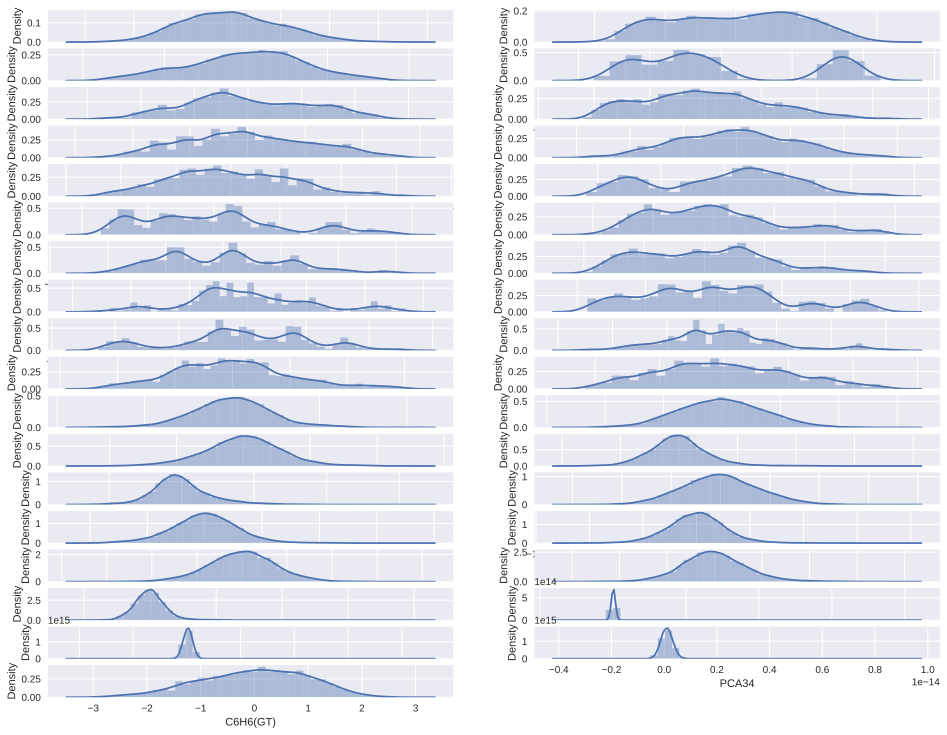

In [ ]:
pos = 1
fig = plt.figure(figsize=(16,24))
for i in df_std_pca.columns:
    ax = fig.add_subplot(34,2,pos)
    pos = pos + 1
    sns.distplot(df_std_pca[i],ax=ax)

# **Split**

In [ ]:
from sklearn.model_selection import train_test_split

(trainData, 
 testData, 
 train_label, 
 test_label) = train_test_split(df_std_pca.drop(TARGET,
                                            axis=1),
                                            df_std_pca[TARGET],
                                            test_size=0.2,
                                            random_state=42)

print('Size of train set:', trainData.shape)
print('Size of test set:', testData.shape)

print('\nClass distribution on train:',
      train_label.value_counts(normalize=True),
      '\nClass distribution on test:', 
      test_label.value_counts(normalize=True),
      sep='\n')

Size of train set: (7192, 34)
Size of test set: (1799, 34)

Class distribution on train:
-1.224704    0.009733
-0.948502    0.009316
-0.827960    0.009177
-1.114854    0.009177
-1.343593    0.009038
               ...   
 2.462726    0.000139
 2.141618    0.000139
 2.477493    0.000139
 2.029913    0.000139
 1.837443    0.000139
Name: C6H6(GT), Length: 391, dtype: float64

Class distribution on test:
-1.566443    0.010561
-0.203746    0.010561
-0.027227    0.010561
-1.187152    0.009450
-0.448669    0.009450
               ...   
 1.688174    0.000556
 2.551939    0.000556
 1.333527    0.000556
 1.747797    0.000556
 1.842011    0.000556
Name: C6H6(GT), Length: 302, dtype: float64


* Make sure that the distribution of the target variable (C6H6(GT)) is the same in both parts.

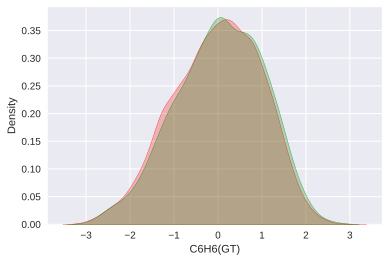

In [ ]:
fig = sns.kdeplot(train_label, shade=True, color="r")
fig = sns.kdeplot(test_label, shade=True, color="g")
plt.show()

In [ ]:
trainData.shape

(7192, 34)

# **Models**

## **PyTorch**

**Train, Test, Val**

In [ ]:
inputs = torch.from_numpy( np.array(trainData, dtype='float32'))
targets = torch.from_numpy( np.array(train_label, dtype='float32'))

In [ ]:
inputs.shape

torch.Size([7192, 34])

In [ ]:
dataset = TensorDataset(inputs, targets)

In [ ]:
num_rows = len(trainData)

In [ ]:
val_percent = 0.1 # between 0.1 and 0.2
val_size = int(num_rows * val_percent)
print(val_size)
train_size = num_rows - val_size
print(train_size)

train_ds, val_ds = random_split(dataset,[train_size, val_size]) # Use the random_spli

719
6473


In [ ]:
batch_size = 64

In [ ]:
train_loader = DataLoader(train_ds, batch_size, shuffle=True)
val_loader = DataLoader(val_ds, batch_size)

**Model**

In [ ]:
class LinearRegressionModel(nn.Module):
   def __init__(self, input_size, hidden_size, output_size):
        super().__init__()
        self.hidden = torch.nn.Linear(input_size, hidden_size)  
        self.predict = torch.nn.Linear(hidden_size, output_size)
        
   def forward(self, x):
        x = F.relu(self.hidden(x))    
        x = self.predict(x)                                
        return x

   def training_step(self, batch):
        inputs, targets = batch 
        # Generate predictions
        out = self(inputs)          
        # Calcuate loss
        loss = F.l1_loss(out, targets)                
        return loss

   def validation_step(self, batch):
        inputs, targets = batch
        # Generate predictions
        out = self(inputs)
        # Calculate loss
        loss = F.l1_loss(out, targets) 
        acc = accuracy(out,targets)                   
        return {'val_loss': loss.detach(), 'val_acc':acc}

   def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        batch_accuracy = [x['val_acc'] for x in outputs]
        epoch_accuracy = torch.stack(batch_accuracy).mean()
        return {'val_loss': epoch_loss.item(), 'val_acc':epoch_accuracy.item()}

  
   def epoch_end(self, epoch, result, num_epochs):
      if (epoch+1) % 50 == 0 or epoch == num_epochs-1:
          print("Epoch [{}], val_loss: {:.4f}".format(epoch+1, result['val_loss'], result['val_acc']))

In [ ]:
def accuracy(output,labels):
  _,preds =torch.max(output,dim=1)
  return torch.tensor(torch.sum(preds==labels).item()/len(preds))

In [ ]:
input_size = 34
hidden_size = 30
output_size = 1

In [ ]:
lr_model = LinearRegressionModel(input_size,hidden_size, output_size)

Defining function to train and validate the model

In [ ]:
def evaluate(model, val_loader):
    model.eval() #
    with torch.no_grad(): #
      outputs = [model.validation_step(batch) for batch in val_loader]
      return model.validation_epoch_end(outputs)

def train(epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.SGD):  # train
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train() #
        for batch in train_loader:
            loss = model.training_step(batch)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        model.epoch_end(epoch, result, epochs)
        history.append(result)

    return history

In [ ]:
history = [evaluate(lr_model,val_loader)]
print(history)

[{'val_loss': 0.8027560710906982, 'val_acc': tensor(0.)}]


**Training model**

In [ ]:
epochs = 300
lr = 0.01

history += train(epochs, lr, lr_model, train_loader, val_loader)

Epoch [50], val_loss: 0.7873
Epoch [100], val_loss: 0.7874
Epoch [150], val_loss: 0.7873
Epoch [200], val_loss: 0.7870
Epoch [250], val_loss: 0.7874
Epoch [300], val_loss: 0.7873


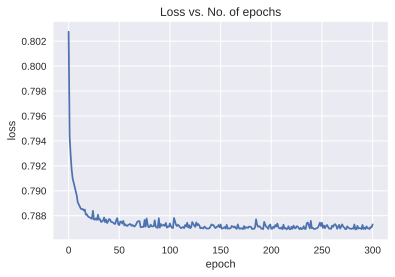

In [ ]:
losses = [x['val_loss'] for x in history]
plt.plot(losses, '-x')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.title('Loss vs. No. of epochs');

Not good at all, this model doesn't make loss close to zero.

**Make predictions**

In [ ]:
input_x_test = torch.from_numpy(np.array(testData, dtype='float32'))

test_predictions = lr_model(input_x_test.float()).data.numpy()

In [ ]:
test_predictions_df = pd.DataFrame(test_predictions, columns=['predictions'])

test_label.reset_index(drop=True, inplace=True)
test_predictions_df.reset_index(drop=True, inplace=True)

test_labels_with_predictions_df = pd.concat([test_label, test_predictions_df], axis=1)

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

**Metrics**

In [ ]:
def calculate_errors_and_r2(y_true, y_pred):
  mean_squared_err = (mean_squared_error(y_true, y_pred))
  root_mean_squared_err = np.sqrt(mean_squared_err)
  mae = (mean_absolute_error(y_true, y_pred))
  r2 = round(r2_score(y_true, y_pred)*100,0)
  return mean_squared_err, root_mean_squared_err, mae, r2

In [ ]:
test_mean_squared_error, test_root_mean_squared_error,test_mae, test_r2_score_percentage = calculate_errors_and_r2(test_label, test_predictions)

In [ ]:
print('Test Data MSE = ', test_mean_squared_error)
print('Test Data RMSE = ', test_root_mean_squared_error)
print('Test Data MAE = ', test_mae)
print('Test Data R2 = ', test_r2_score_percentage)

Test Data MSE =  0.9552411577483298
Test Data RMSE =  0.977364393534126
Test Data MAE =  0.7953096675283525
Test Data R2 =  3.0


### **Conclusion**  

The predictive ability of this model is very poor.  Scores are extremely bad. I think it's worth working better with the layers of the model and choosing a more optimal one learning rate. **Much better results** were achieved in solving this problem when building a model byusing **TenserFlow**.

### **Comparison with ML models and with scores in the ML version of this work**  

* If we compare with ML regression models, then the scores there turned out to be much better than on this model. We see that this model does not know how to predict.

* *** Average cross-validation scores ***:  
MSE:   0.052758459415694625  
RMSE:  0.22941001185650373  
MAE:   0.1591849854296098 
R2:    0.9453104726388908  
 



## **TensorFlow**

I implement a DNN model (regression problem).  

There is a "hidden" nonlinear layers in the model. This model will contain several layers more than the linear model:  

Normalization (normalizer) is used as a layer normalization.  
One non-linear layer, Dance layers with relu activation functions of non-linearity.  
Linear Dense layer of a single output number.  

In [ ]:
normalizer = tf.keras.layers.Normalization(axis=-1)

In [ ]:
def build_and_compile_model(norm):
  model = tf.keras.Sequential([
      norm,
      layers.Dense(30, activation='relu'),
      layers.Dense(1)
  ])

  model.compile(loss='mean_absolute_error',
                optimizer=tf.keras.optimizers.Adam(0.001))
  return model

In [ ]:
dnn_model = build_and_compile_model(normalizer)

**Model training**

In [ ]:
%%time
history = dnn_model.fit(
    trainData,
    train_label,
    validation_split=0.2,
    verbose=0, epochs=100)

CPU times: user 30.3 s, sys: 2.88 s, total: 33.1 s
Wall time: 41.3 s


In [ ]:
def plot_loss(history):
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.ylim([0, 1])
  plt.xlabel('Epoch')
  plt.ylabel('Error')
  plt.legend()
  plt.grid(True)

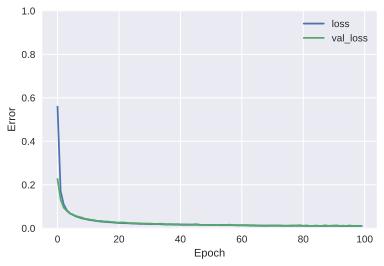

In [ ]:
plot_loss(history)

The training of the model was successful, the loss function is almost at zero.

In [ ]:
x = tf.linspace(0.0, 2, 3)
y = dnn_model.predict(x)

In [ ]:
def plot_pred(x, y):
  plt.scatter(trainData['PCA1'], train_label, label='Data')
  plt.plot(x, y, color='k', label='Predictions')
  plt.xlabel('target')
  plt.ylabel('PCA1')
  plt.legend()

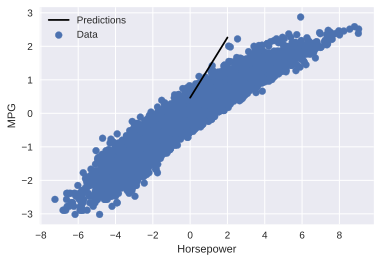

In [ ]:
plot_pred(x, y)

**Prediction**

In [ ]:
test_results = dnn_model.evaluate(testData, test_label, verbose=0)

**Mean absolute error**

In [ ]:
test_results   

0.011265937238931656

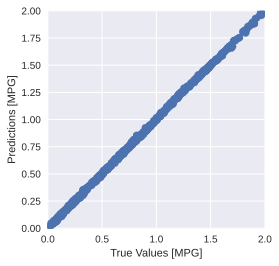

In [ ]:
test_predictions = dnn_model.predict(testData).flatten()

a = plt.axes(aspect='equal')
plt.scatter(test_label, test_predictions)
plt.xlabel('True Values [MPG]')
plt.ylabel('Predictions [MPG]')
lims = [0, 2]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)

It seems that the model predicts quite well. MAE's results are extremely good.

Checking error distribution:

In [ ]:
error = test_predictions - test_label

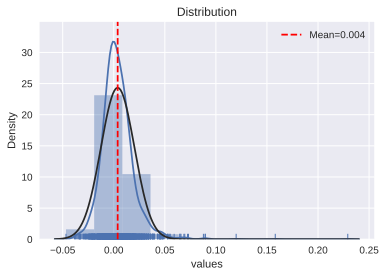

In [ ]:
draw_histogram(error)

The distribution looks like normal, although it has a long right tail, which is not good, but the average value is close to zero.

**Save model**

In [ ]:
dnn_model.save('/content/drive/My Drive/DA/HW11/Data/Models/dnn_model')

INFO:tensorflow:Assets written to: /content/drive/My Drive/DA/HW11/Data/Models/dnn_model/assets


### **Conclusion**  

The predictive ability of this model is extremely high. Evaluation metrics show great results. MAE score is close to zero.

### **Comparison with ML models and with scores in the ML version of this work**  

* If we compare with ML regression models, then the scores there turned out to be a little worse than on this model. We see that this model predicts better.  

**New model res**

* MAE: 0.011265937238931656

**ML regression model:**  

* MAE:   0.1591849854296098 

 



## **General conclusion**

* Heteroscedasticity was found in the data, which is bad for the regression model. Heteroscedasticity, the violation of homoscedasticity, occurs when we don’t have Why it can happen: Our model may be giving too much weight to a subset of the data, particularly where the error variance was the largest.

**What it will affect:** Significance tests for coefficients due to the standard errors being biased. Additionally, the confidence intervals will be either too wide or too narrow.

**How to detect it:** Plot the residuals and see if the variance appears to be uniform.

**How to fix it:** Heteroscedasticity  can be solved either by using weighted least squares regression instead of the standard OLS. One way to get rig of this thing is to penalize the points at larger variances. If we are seeking a linear fit to the data, the points with the larger noise/errors should be of lower influence than the points that lie close together. Enter weighted least squares (WLS) – in this method, the weights for each datapoint is scaled inversely as a function of its variance, thereby achieving the above goal.
Or transforming either the dependent or highly skewed variables. Performing a box-cox or a log transformation on the dependent variable is not a bad place to start.

---------------------------------------------------------

The PCA algorithm was used to eliminate multicollinearity.

**Results:** 

* The best results on both the train and the test with a slight difference in performance were shown by *TenserFlow Model*. Moreover, this model coped better with this task then the ML models.


**TEST**

MAE: 0.011265937238931656

------------------------------------

I also think that it is possible to improve the simple linear model and other models with weaker indicators, with the help of more fine-tuning of parameters like learning rate and hidden layers.

#<center>  **Classification**

## <center> **Thyroid Disease Data Set**


# Table of Contents

1. **[Functions](#1)**
2. **[Preprocessing](#2)**
	* [Dropping duplicates](#sub-heading1)
	* [Dealing with missing data](#sub-heading2)
	* [Type of a features](#sub-heading3)
	* [Outliers](#sub-heading4)
3. **[EDA](#3)**
	* [Target variable](#sub-heading5)
	* [Numeric features](#sub-heading6)
	* [Distributions of categorical features](#sub-heading7)
	* [Multivariate analysis](#sub-heading8)
	* [Correlation](#sub-heading9)
	* [Correlation coefficients](#sub-heading)
4. **[Transformation](#4)**
	* [Target encoding](#sub-heading)
	* [Split](#sub-heading)
	* [Pipline](#sub-heading)
	* [SMOTE](#sub-heading)
5. **[Split](#5)**
6. **[SMOTE](#6)**
7. **[Models](#7)**
	* [PyTorch](#sub-heading)
	* [TensorFlow](#sub-heading)




In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data = pd.read_csv('/content/drive/My Drive/DA/HW5/dataset_57_hypothyroid.csv', sep=',', na_values='?')

In [ ]:
TARGET = 'Class'

## **Functions**

**Plotting histograms & transformations**

In [ ]:
from scipy.special import boxcox1p

def draw_boxcox(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(boxcox1p(data, 0.25), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=boxcox1p(data, 0.25).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [ ]:
def draw_cuberoot(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE cube root transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot((data**(1/3)), hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution AFTER cube root transformation")
    plt.xlabel("values")
    mean=(data**(1/3)).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

**Plotting categor. features**

In [ ]:
def plot_cat_features(cat1:str, cat2:str):
    pl.subplot(2,2,1)
    n_poutcome = data[cat1].value_counts()
    genres = n_poutcome.index.values
    plt.stem(n_poutcome)
    plt.title(f'Frequency Distribution of {cat1}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat1}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()
    #
    pl.subplot(2,2,2)
    n_default = data[cat2].value_counts()
    genres = n_default.index.values
    plt.stem(n_default)
    plt.title(f'Frequency Distribution of {cat2}')
    plt.ylabel('Number of Occurrences', fontsize=9)
    plt.xlabel(f'{cat2}', fontsize=9)
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()

**Quality evaluation**


In [ ]:
!ls

%cd /content/drive/My Drive/DA/HW5/

from plot_cm import plot_confusion_matrix

best_checkpoint  drive	sample_data
/content/drive/My Drive/DA/HW5


In [ ]:
from plot_roc import plot_roc

In [ ]:
def calc_metrics(test_label, preds):
    classes_names = ['negative', 'compensated_hypothyroid', 'primary_hypothyroid']
    num_classes = 3

    plot_confusion_matrix(cm=metrics.confusion_matrix(test_label, preds),
                          target_names=classes_names,
                          normalize=False)
    
    print("Accuracy:",
          round(metrics.accuracy_score(test_label, preds), 5),
        '\nBalanced accuracy:',
        round(metrics.balanced_accuracy_score(test_label, preds), 5), 
        '\nMulticlass f1-score:',
        '\n    micro:', round(metrics.f1_score(test_label, preds, average='micro'), 5),
        '\n    macro:', round(metrics.f1_score(test_label, preds, average='macro'), 5),
        '\n    weighted:', round(metrics.f1_score(test_label, preds, average='weighted'), 5))

    print('\n\nClassification report:\n')
    print(metrics.classification_report(test_label, preds, digits=5))

In [ ]:
# classes_names = ['0', '1']

**ROC AUC**

In [ ]:
def count_roc_auc(model, testData, test_label, num_classes, classes_names):
    preds_prob = model.predict_proba(testData)


    print('ROC AUC:',
         '\n    macro:', round(metrics.roc_auc_score(test_label, preds_prob, multi_class='ovr', average='macro'), 5),
         '\n    weighted:', round(metrics.roc_auc_score(test_label, preds_prob, multi_class='ovr', average='weighted'), 5))

    test_label_bin = label_binarize(test_label, classes=np.arange(num_classes))

    plot_roc(test_label_bin, preds_prob, target_names=classes_names)

## **Preprocessing**

Looking at data

In [ ]:
data.head().T

,0,1,2,3,4
age,41,23,46,70,70
sex,F,F,M,F,F
on_thyroxine,f,f,f,t,f
query_on_thyroxine,f,f,f,f,f
on_antithyroid_medication,f,f,f,f,f
sick,f,f,f,f,f
pregnant,f,f,f,f,f
thyroid_surgery,f,f,f,f,f
I131_treatment,f,f,f,f,f
query_hypothyroid,f,f,f,f,f


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3772 entries, 0 to 3771
Data columns (total 30 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   age                        3771 non-null   float64
 1   sex                        3622 non-null   object 
 2   on_thyroxine               3772 non-null   object 
 3   query_on_thyroxine         3772 non-null   object 
 4   on_antithyroid_medication  3772 non-null   object 
 5   sick                       3772 non-null   object 
 6   pregnant                   3772 non-null   object 
 7   thyroid_surgery            3772 non-null   object 
 8   I131_treatment             3772 non-null   object 
 9   query_hypothyroid          3772 non-null   object 
 10  query_hyperthyroid         3772 non-null   object 
 11  lithium                    3772 non-null   object 
 12  goitre                     3772 non-null   object 
 13  tumor                      3772 non-null   objec

* See a lot of missing values.

### **Dropping duplicates**

Then I drop duplicates in Dataset.

In [ ]:
data.shape

(3772, 30)

In [ ]:
data.drop_duplicates(inplace=True)
data.shape

(3711, 30)

* 61 duplicates were found & deleted.

### **Dealing with missing data**

Total amount of NaNs:

In [ ]:
data.isnull().sum().sum()

5702

Each column with amount of NaNs:

In [ ]:
data.isna().sum()

age                             1
sex                           149
on_thyroxine                    0
query_on_thyroxine              0
on_antithyroid_medication       0
sick                            0
pregnant                        0
thyroid_surgery                 0
I131_treatment                  0
query_hypothyroid               0
query_hyperthyroid              0
lithium                         0
goitre                          0
tumor                           0
hypopituitary                   0
psych                           0
TSH_measured                    0
TSH                           309
T3_measured                     0
T3                            709
TT4_measured                    0
TT4                           171
T4U_measured                    0
T4U                           327
FTI_measured                    0
FTI                           325
TBG_measured                    0
TBG                          3711
referral_source                 0
Class         

* Only 8 features (from 30) have missed values.
* These features contain many missing values, especially **TBG** column --> 3711 from 3711 (all). It has to be deleted later.
* **T3** has also many missing values (709 from 3771).   

The **TBG** feature is fully missed, so it **cannot be replaced with an average and not lose accuracy**. That's why I decided to delete it.

In [ ]:
data.drop('TBG', axis=1, inplace=True)
data.head(3)

,age,sex,on_thyroxine,query_on_thyroxine,on_antithyroid_medication,sick,pregnant,thyroid_surgery,I131_treatment,query_hypothyroid,query_hyperthyroid,lithium,goitre,tumor,hypopituitary,psych,TSH_measured,TSH,T3_measured,T3,TT4_measured,TT4,T4U_measured,T4U,FTI_measured,FTI,TBG_measured,referral_source,Class
0,41.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,f,t,1.30,t,2.5,t,125.0,t,1.14,t,109.0,f,SVHC,negative
1,23.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,f,t,4.10,t,2.0,t,102.0,f,NaN,f,NaN,f,other,negative
2,46.0,M,f,f,f,f,f,f,f,f,f,f,f,f,f,f,t,0.98,f,NaN,t,109.0,t,0.91,t,120.0,f,other,negative


**The most widely used methods to deal with missing data are:**  
1) create a new category for NaN values  
2) impute median/mode/mean(depends on data types) 
_______________________________________________
  
Of course, each method has its pros and cons, such:  
1)  
+: Simple and easy to implement for categorical variables/columns and preserves the variance.  
-: May create random data if the missing category is more.
Doesn’t give good results when missing data is a high percentage of the data.  

2)  
+: Simple and easy to implement.
-: Features having a max number of null values may bias prediction if replace with the most occurred category.
It distorts the relation of the most frequent label.

**Analyses of how to handle the missing data.**

We'll consider that when more than/equal 70% of the data is missing, we should delete the corresponding variable and pretend it never existed. This means that we will not try any trick to fill the missing data in these cases. According to this, there is a set of variables that we should delete.

**!** Firstly, I'll drop rows, where exist NaNs more than >= 20 (more than half).

In [ ]:
inds = []
counter = 0
for i in range(len(data.index)):
  if data.iloc[i].isnull().sum() >= 20:
    counter += 1
    inds.append(i)
print('Rows with NaN >= 20: ', counter)

Rows with NaN >= 20:  0


* There are no rows in which there are extremely many gaps in the data.

In [ ]:
# summarize the number of rows with missing values for each column
for i in data.columns:
    # count number of rows with missing values
    n_miss = data[i].isnull().sum()
    perc = n_miss / data.shape[0] * 100
	
    if n_miss != 0:
        print(f'Column: {i}\nAmount {n_miss}\n%{perc}\n')

Column: age
Amount 1
%0.026946914578280787

Column: sex
Amount 149
%4.015090272163837

Column: TSH
Amount 309
%8.326596604688763

Column: T3
Amount 709
%19.105362436001077

Column: TT4
Amount 171
%4.607922392886015

Column: T4U
Amount 327
%8.811641067097817

Column: FTI
Amount 325
%8.757747237941256



Features *age, sex, TSH, T3,  TT4, T4U, FTI*  have  some missing data  (from 1 to 19 %),  I'm not sure, but think, that it is not a huge percentage and I can emplace missing data by using median value.  


In [ ]:
df = data.copy(deep=True)

In [ ]:
mf_imputer = SimpleImputer(strategy='most_frequent')

df['sex'] = mf_imputer.fit_transform(df[['sex']])

**Multivariate feature imputation - Multivariate imputation by chained equations (MICE)**

A strategy for imputing missing values by modeling each feature with missing values as a function of other features in a round-robin fashion. It performns multiple regressions over random sample ofthe data, then takes the average ofthe multiple regression values and uses that value to impute the missing value.

In [ ]:
mice_imputer = IterativeImputer()
cols_nan = ['age', 'TSH', 'T3', 'TT4', 'T4U', 'FTI' ]

for col in cols_nan:
  df[col] = mice_imputer.fit_transform(df[[col]])

In [ ]:
df.isnull().sum().sum()

0

* MICE is more powerful than the usage of median, for example, so I decided to use it here ti fill in missing values.

## **Type of a features**

In [ ]:
NUMERICAL = df.select_dtypes(exclude=['category', 'object']).columns.tolist()

In [ ]:
CATEGORICAL = list(data.select_dtypes(include=['object']).columns)
CATEGORICAL

['sex',
 'on_thyroxine',
 'query_on_thyroxine',
 'on_antithyroid_medication',
 'sick',
 'pregnant',
 'thyroid_surgery',
 'I131_treatment',
 'query_hypothyroid',
 'query_hyperthyroid',
 'lithium',
 'goitre',
 'tumor',
 'hypopituitary',
 'psych',
 'TSH_measured',
 'T3_measured',
 'TT4_measured',
 'T4U_measured',
 'FTI_measured',
 'TBG_measured',
 'referral_source',
 'Class']

In [ ]:
n_categories = [(x, data[x].nunique()) for x in CATEGORICAL]
n_categories

[('sex', 2),
 ('on_thyroxine', 2),
 ('query_on_thyroxine', 2),
 ('on_antithyroid_medication', 2),
 ('sick', 2),
 ('pregnant', 2),
 ('thyroid_surgery', 2),
 ('I131_treatment', 2),
 ('query_hypothyroid', 2),
 ('query_hyperthyroid', 2),
 ('lithium', 2),
 ('goitre', 2),
 ('tumor', 2),
 ('hypopituitary', 2),
 ('psych', 2),
 ('TSH_measured', 2),
 ('T3_measured', 2),
 ('TT4_measured', 2),
 ('T4U_measured', 2),
 ('FTI_measured', 2),
 ('TBG_measured', 1),
 ('referral_source', 5),
 ('Class', 4)]

## **Outliers**

**IQR method**

In [ ]:
count_iqr(df)

age -> outliers: -> 6
TSH -> outliers: -> 67
T3 -> outliers: -> 49
T4U -> outliers: -> 90


**Z-SCORE method**

In [ ]:
for col in NUMERICAL:
    Zscore_outlier(df[col], col)

age:
Outliers amount: 1

TSH:
Outliers amount: 39

T3:
Outliers amount: 54

TT4:
Outliers amount: 51

T4U:
Outliers amount: 74

FTI:
Outliers amount: 75



**Conclusion**
* Analyzing the emissions, in general, there are not very many of them.
* I can delete outlier values if it is due to data entry error, data processing error or outlier observations are very small in numbers. I can also use trimming at both ends to remove outliers. 
* But deleting the observation is not a good idea when we have small dataset.

* Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.

So, later I'll use some **transformation methods.**

## **EDA**

Descriptive statistics for numerical and categorical features.

In [ ]:
df.describe(include='all')

,age,sex,on_thyroxine,query_on_thyroxine,on_antithyroid_medication,sick,pregnant,thyroid_surgery,I131_treatment,query_hypothyroid,query_hyperthyroid,lithium,goitre,tumor,hypopituitary,psych,TSH_measured,TSH,T3_measured,T3,TT4_measured,TT4,T4U_measured,T4U,FTI_measured,FTI,TBG_measured,referral_source,Class
count,3711.000000,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711,3711.000000,3711,3711.000000,3711,3711.000000,3711,3711.000000,3711,3711.000000,3711,3711,3711
unique,NaN,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,NaN,2,NaN,2,NaN,2,NaN,2,NaN,1,5,4
top,NaN,F,f,f,f,f,f,f,f,f,f,f,f,f,f,f,t,NaN,t,NaN,t,NaN,t,NaN,t,NaN,f,other,negative
freq,NaN,2573,3247,3661,3669,3564,3658,3658,3652,3477,3477,3693,3677,3615,3710,3527,3402,NaN,3002,NaN,3540,NaN,3384,NaN,3386,NaN,3711,2140,3420
mean,51.860377,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.087820,NaN,2.013504,NaN,108.328475,NaN,0.994989,NaN,110.480715,NaN,NaN,NaN
std,20.120872,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.481473,NaN,0.744307,NaN,34.774903,NaN,0.186671,NaN,31.605819,NaN,NaN,NaN
min,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.005000,NaN,0.050000,NaN,2.000000,NaN,0.250000,NaN,2.000000,NaN,NaN,NaN
25%,36.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.585000,NaN,1.700000,NaN,89.000000,NaN,0.890000,NaN,94.000000,NaN,NaN,NaN
50%,54.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.600000,NaN,2.013504,NaN,105.000000,NaN,0.990000,NaN,110.000000,NaN,NaN,NaN
75%,67.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.500000,NaN,2.300000,NaN,123.000000,NaN,1.070000,NaN,122.000000,NaN,NaN,NaN


**Conclusion**  

* Since we are working with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. So, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

* To solve this problem, I later perform *STANDARDIZATION* of the data.

* Also, I think that it is strange for feature age - containe number 455, so we have to deal with it. 

In [ ]:
df['age'].value_counts()

59.000000     95
60.000000     90
70.000000     88
73.000000     81
55.000000     79
              ..
455.000000     1
51.860377      1
6.000000       1
5.000000       1
4.000000       1
Name: age, Length: 94, dtype: int64

* It is likely that this is a typo and the age should be 45, it is easy to fix.

I am correcting 455 to 45:

In [ ]:
i = df.index[df['age'] == 455].tolist()

df.at[i, 'age'] = 45
df['age'].value_counts()

59.000000    95
60.000000    90
70.000000    88
73.000000    81
55.000000    79
             ..
51.860377     1
6.000000      1
4.000000      1
10.000000     1
5.000000      1
Name: age, Length: 93, dtype: int64

### **Target variable**

In [ ]:
df[TARGET].value_counts()

negative                   3420
compensated_hypothyroid     194
primary_hypothyroid          95
secondary_hypothyroid         2
Name: Class, dtype: int64

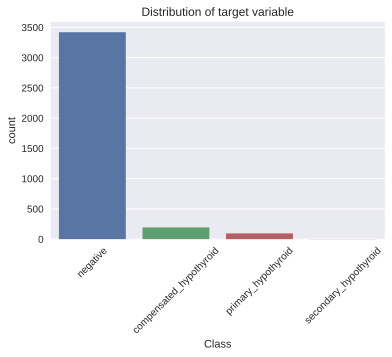

In [ ]:
sns.countplot(df[TARGET]);
plt.title('Distribution of target variable')
plt.xticks(rotation=45)
plt.show()

In [ ]:
sns.pairplot(df, hue='Class', plot_kws={'alpha':0.5})
plt.show()

Output hidden; open in https://colab.research.google.com to view.

* The target value in the dataset looks imbalanced as the number of negative samples is much higher than the other 3 classes.
* It is very bad that the ***secondary_hypothyroid*** class is represented by ***only 2 observations***, it will be *impossible to predict* it without adding data, so it needs to be *deleted*.

In [ ]:
i = df[df[TARGET] == 'secondary_hypothyroid'].index
df.drop(i, inplace=True)

**Conclusion**

* In the future, I'm going to use the *'SMOTE'* algorithm to avoid the problem of data imbalance.

* Since only two observations are presented in the "secondary_hypothyroid" class, it would be possible to try to duplicate two lines of data in the test and then, after applying "SMOTE", delete them from the train, but I am not sure that this approach is correct and that there will be no information leakage, I also can't give any guarantees, so I thought it necessary to delete this class at the moment, since there is a clear lack of data.

In [ ]:
df[TARGET].value_counts()

negative                   3420
compensated_hypothyroid     194
primary_hypothyroid          95
Name: Class, dtype: int64

### **Numeric features**

**age**

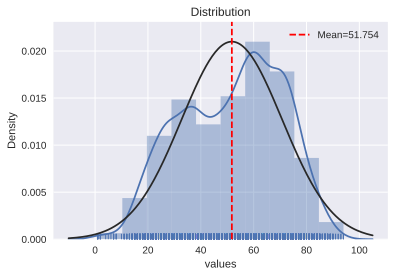

In [ ]:
draw_histogram(df['age'])

In [ ]:
count_skewness_kurtosis(df['age'])

Skewness: -0.219301
Kurtosis: -0.881686


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be log transformed.

**Log transformation**

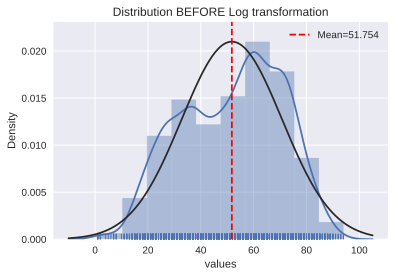

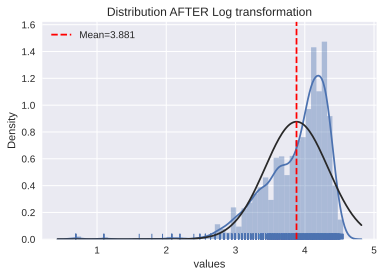

In [ ]:
draw_lognorm(df['age'])

**Testing normality**

In [ ]:
shapiro_normality_testing(df['age'])

stat=0.976, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small tails. However, the variance has become less.

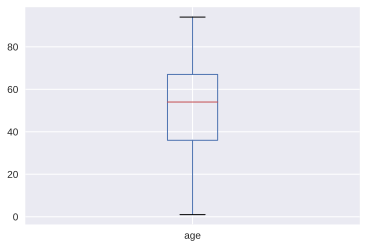

In [ ]:
df.boxplot(column=['age'])

**Conclusion** 
* This feature has a very small amount of outlaiers, near 500+.
* The median is around 52, and 4 after log transformation.

**TSH**

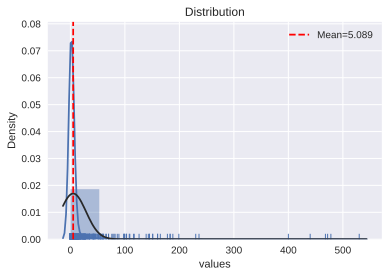

In [ ]:
draw_histogram(df['TSH'])

In [ ]:
df['TSH'].value_counts()

5.08782      309
0.20000      116
1.30000      105
1.10000       97
1.40000       91
            ... 
66.00000       1
440.00000      1
0.23000        1
236.00000      1
468.00000      1
Name: TSH, Length: 288, dtype: int64

In [ ]:
count_skewness_kurtosis(df['TSH'])

Skewness: 14.492950
Kurtosis: 259.840905


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long ringht tail.
* Data looks like needed to be log transformed.

**Log transformation**

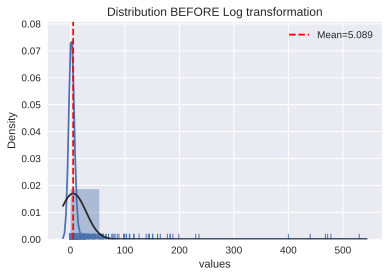

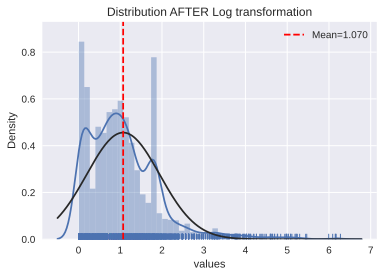

In [ ]:
draw_lognorm(df['TSH'])


**Testing normality**

In [ ]:
shapiro_normality_testing(df['TSH'])

stat=0.153, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right a little.
* However, the variance has become less, it's good.

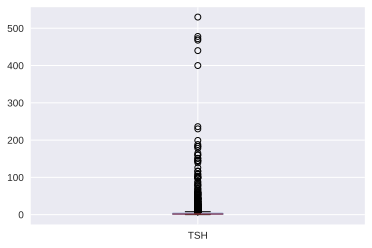

In [ ]:
df.boxplot(column=['TSH'])

**Conclusion** 
* This feature has a lot of outlaiers, from practically 0 to 500+.
* The median is around 5, and 0.6 after log transformation.

**T3**

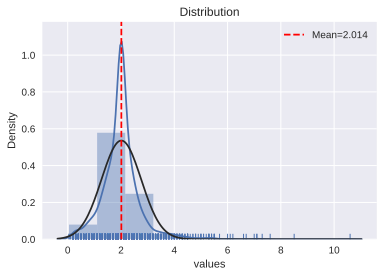

In [ ]:
draw_histogram(df['T3'])

In [ ]:
df['T3'].value_counts()

2.013504    709
2.000000    237
1.800000    207
2.200000    201
1.900000    189
           ... 
7.000000      1
8.500000      1
6.600000      1
4.900000      1
7.300000      1
Name: T3, Length: 70, dtype: int64

In [ ]:
count_skewness_kurtosis(df['T3'])

Skewness: 1.924589
Kurtosis: 12.902054


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long right tail.
* Data looks like needed to be log transformed, we observe many outliers between 4 and 10 values.

**Log transformation**

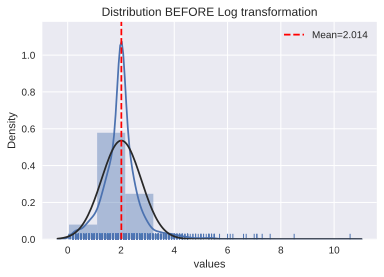

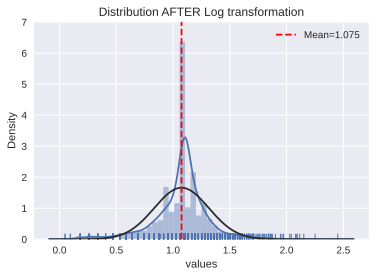

In [ ]:
draw_lognorm(df['T3'])

**Testing normality**

In [ ]:
shapiro_normality_testing(df['T3'])

stat=0.856, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a left tail.
* Moreover, the variance has become less.

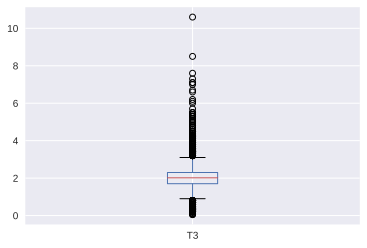

In [ ]:
df.boxplot(column=['T3'])

**Conclusion** 
* This feature has some outlaiers, from 3 to 10, and 0-1.
* The median is around 2, after log transform. it is 1+.

**TT4**

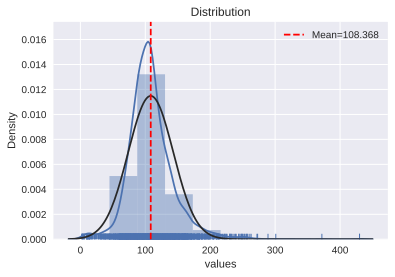

In [ ]:
draw_histogram(df['TT4'])

In [ ]:
count_skewness_kurtosis(df['TT4'])

Skewness: 1.304250
Kurtosis: 7.108845


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be transformed.

**Log transformation**

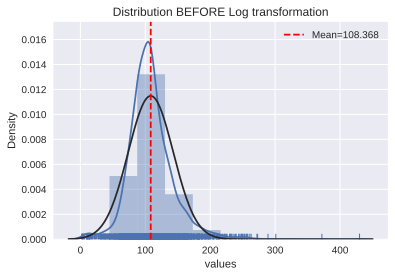

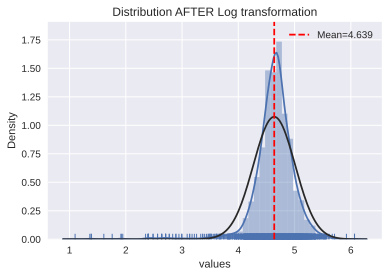

In [ ]:
draw_lognorm(df['TT4'])


**Testing normality**

In [ ]:
shapiro_normality_testing(df['TT4'])

stat=0.922, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small tails. * * Moreover, the variance has become less.

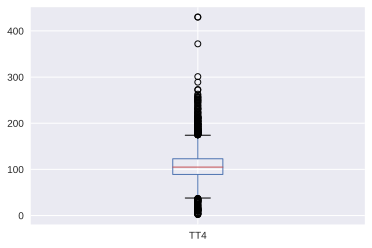

In [ ]:
df.boxplot(column=['TT4'])

**Conclusion** 
* This feature has many outlaiers, from 200 to 400+ and near 0.
* The median is around 108, after log transformaton - 4.6.

**T4U**

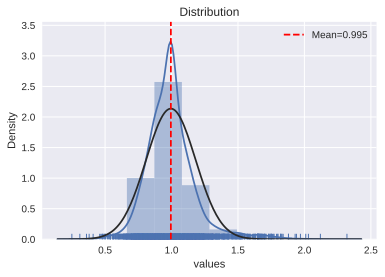

In [ ]:
draw_histogram(df['T4U'])

In [ ]:
count_skewness_kurtosis(df['T4U'])

Skewness: 1.290211
Kurtosis: 4.750950


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is biased a little !!!
* *Kurtosis* shows that the distribution is not flattened and has some tails.
* Data looks like needed to be transformed.

**Testing normality**

In [ ]:
shapiro_normality_testing(df['T4U'])

stat=0.915, p=0.000
Probably not Gaussian


**Log transformation**

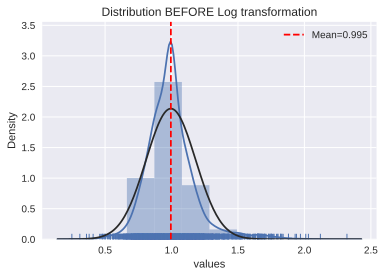

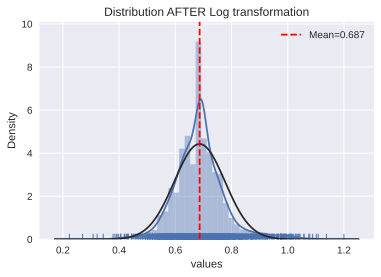

In [ ]:
draw_lognorm(df['T4U'])

**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small tails. * Moreover, the variance has become less!

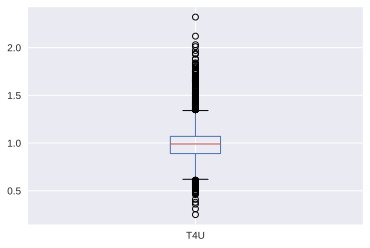

In [ ]:
df.boxplot(column=['T4U'])

**Conclusion** 
* This feature has some outlaiers, from near 0.5 and 1-2.0.
* The median is around 1, after transformation it's 0.6.

**FTI**

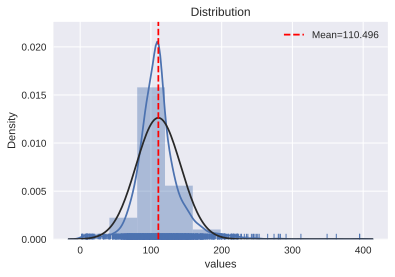

In [ ]:
draw_histogram(df['FTI'])

In [ ]:
count_skewness_kurtosis(df['FTI'])

Skewness: 1.409994
Kurtosis: 8.928941


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a tail.
* Data looks like needed to be log transformed.

**Testing normality**

In [ ]:
shapiro_normality_testing(df['FTI'])

stat=0.892, p=0.000
Probably not Gaussian


**Log transformation**

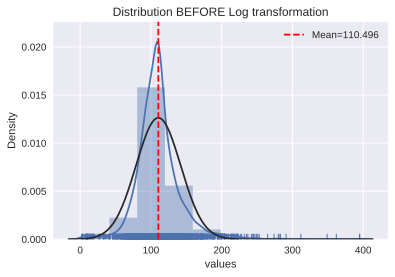

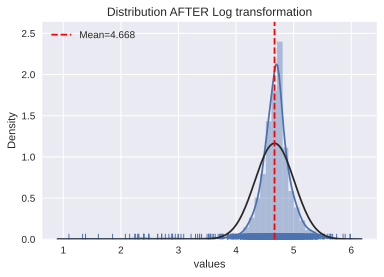

In [ ]:
draw_lognorm(df['FTI'])

**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small tails. However, the variance has become less.

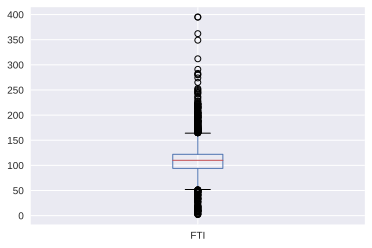

In [ ]:
df.boxplot(column=['FTI'])

**Conclusion** 
* This feature has many outlaiers, from near 0-50 and 150 to 400.
* The median is around 110, after transformation it's 5.

### **Distributions of categorical features**

**sex, on_thyroxine**

In [ ]:
df['sex'].value_counts()

F    2572
M    1137
Name: sex, dtype: int64

In [ ]:
df['on_thyroxine'].value_counts()

f    3245
t     464
Name: on_thyroxine, dtype: int64

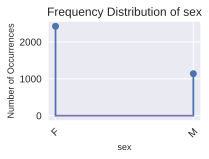

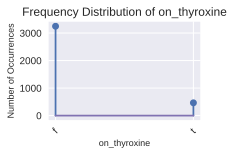

In [ ]:
plot_cat_features('sex', 'on_thyroxine')

**Conclusion**  
* The **"sex"** feature has more *female* observations.
* The **"on_thyroxine"** attribute has more *false* observations. There are almost 6 times more 'false' observations.

**'query_on_thyroxine', 'on_antithyroid_medication'**

In [ ]:
df['query_on_thyroxine'].value_counts()

f    3659
t      50
Name: query_on_thyroxine, dtype: int64

In [ ]:
df['on_antithyroid_medication'].value_counts()

f    3667
t      42
Name: on_antithyroid_medication, dtype: int64

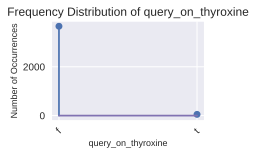

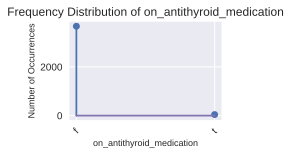

In [ ]:
plot_cat_features('query_on_thyroxine', 'on_antithyroid_medication')

**Conclusion**  
* The **"query_on_thyroxine"** feature has more *false* observations.
* The **"on_antithyroid_medication"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

**'sick', 'pregnant'**

In [ ]:
df['sick'].value_counts()

f    3562
t     147
Name: sick, dtype: int64

In [ ]:
df['pregnant'].value_counts()

f    3656
t      53
Name: pregnant, dtype: int64

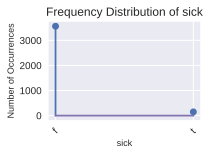

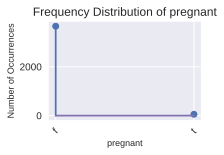

In [ ]:
plot_cat_features('sick', 'pregnant')

**Conclusion**  
* The **"sick"** feature has more *false* observations.
* The **"pregnant"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

* It is logical that the values of 'true' are much less, because pregnancy and illness are phenomena that do not prevail in most people.

**'thyroid_surgery', 'I131_treatment'**

In [ ]:
df['thyroid_surgery'].value_counts()

f    3656
t      53
Name: thyroid_surgery, dtype: int64

In [ ]:
df['I131_treatment'].value_counts()

f    3650
t      59
Name: I131_treatment, dtype: int64

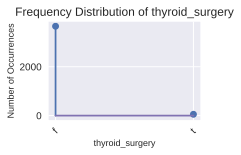

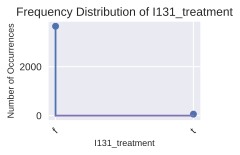

In [ ]:
plot_cat_features('thyroid_surgery', 'I131_treatment')

**Conclusion**  
* The **"thyroid_surgery"** feature has more *false* observations.
* The **"I131_treatment"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

* It is logical that the values of 'true' are much less, because these phenomena do not prevail in most people.

**'query_hypothyroid', 'query_hyperthyroid'**

In [ ]:
df['query_hypothyroid'].value_counts()

f    3476
t     233
Name: query_hypothyroid, dtype: int64

In [ ]:
df['query_hyperthyroid'].value_counts()

f    3475
t     234
Name: query_hyperthyroid, dtype: int64

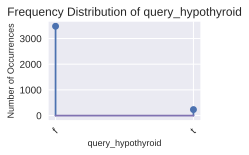

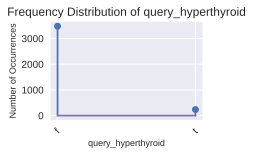

In [ ]:
plot_cat_features('query_hypothyroid', 'query_hyperthyroid')

**Conclusion**  
* The **"query_hypothyroid"** feature has more *false* observations.
* The **"query_hyperthyroid"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

* It is logical that the values of 'true' are much less, because these phenomena do not prevail in most people.

**'lithium', 'goitre'**

In [ ]:
df['lithium'].value_counts()

f    3691
t      18
Name: lithium, dtype: int64

In [ ]:
df['goitre'].value_counts()

f    3675
t      34
Name: goitre, dtype: int64

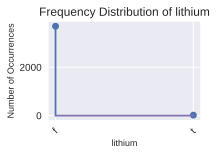

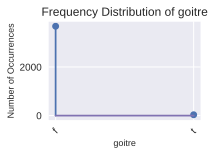

In [ ]:
plot_cat_features('lithium', 'goitre')

**Conclusion**  
* The **"lithium"** feature has more *false* observations.
* The **"goitre"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.


**'tumor', 'psych'**

In [ ]:
df['tumor'].value_counts()

f    3613
t      96
Name: tumor, dtype: int64

In [ ]:
df['psych'].value_counts()

f    3525
t     184
Name: psych, dtype: int64

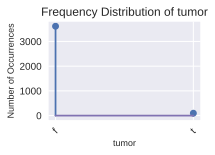

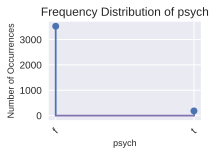

In [ ]:
plot_cat_features('tumor', 'psych')

**Conclusion**  
* The **"tumor"** feature has more *false* observations.
* The **"psych"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

* It is logical that the values of 'true' are much less, because pregnancy and these phenomena do not prevail in most people.

**'TSH_measured', 'T3_measured'**

In [ ]:
df['T3_measured'].value_counts()

t    3000
f     709
Name: T3_measured, dtype: int64

In [ ]:
df['TSH_measured'].value_counts()

t    3400
f     309
Name: TSH_measured, dtype: int64

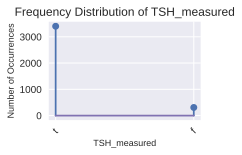

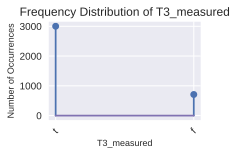

In [ ]:
plot_cat_features('TSH_measured', 'T3_measured')

**Conclusion**  
* The **"TSH_measured"** feature has more *false* observations.
* The **"T3_measured"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

**'TT4_measured', 'T4U_measured'**

In [ ]:
df['TT4_measured'].value_counts()

t    3538
f     171
Name: TT4_measured, dtype: int64

In [ ]:
df['T4U_measured'].value_counts()

t    3383
f     326
Name: T4U_measured, dtype: int64

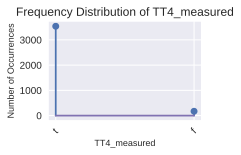

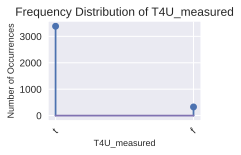

In [ ]:
plot_cat_features('TT4_measured', 'T4U_measured')

**Conclusion**  
* The **"sick"** feature has more *false* observations.
* The **"pregnant"** attribute has more *false* observations.

* There is a *sharp difference* in both features between true and false result. Both columns have many 'false' values and a very little amount of 'true' values.

**'FTI_measured', 'referral_source'**

In [ ]:
df['FTI_measured'].value_counts()

t    3385
f     324
Name: FTI_measured, dtype: int64

In [ ]:
df['referral_source'].value_counts()

other    2138
SVI      1034
SVHC      386
STMW      112
SVHD       39
Name: referral_source, dtype: int64

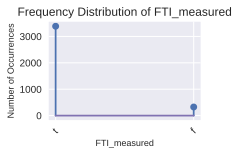

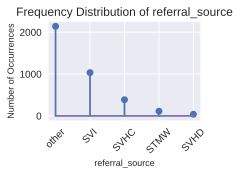

In [ ]:
plot_cat_features('FTI_measured', 'referral_source')

**Conclusion**  
* The **"FTI_measured"** feature has more *false* observations.
* The **"referral_source"** attribute has more *other* observations.

* There is a difference in 'FTI_measured' feature between true and false results. 
* In 'referral_source' column the smallest amount of  observations refers to 'SVHD', only 39.



**hypopituitary, TBG_measured**

In [ ]:
df['hypopituitary'].value_counts()

f    3708
t       1
Name: hypopituitary, dtype: int64

In [ ]:
df['TBG_measured'].value_counts()

f    3709
Name: TBG_measured, dtype: int64

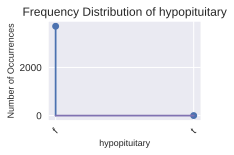

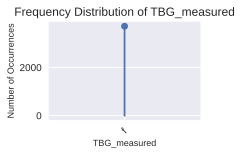

In [ ]:
plot_cat_features('hypopituitary', 'TBG_measured')

**Conclusion**  
* The **"hypopituitary"** feature has ***only one*** true observation.
* The **"TBG_measured"** attribute has ***only*** false observations.

* I think that these features do not make a special contribution to the further training of the model, so they should be **removed**.

**Conclusion**

* In this dataset there are some binary features, the gap in the values of which between 'true' and 'false 'is extremely large, for example: *3000+ -'false 'and 18 - 'true'.*


In [ ]:
new_df = df.copy(deep=True)

And get rid of multicollinearity

In [ ]:
new_df.drop(['hypopituitary', 'TBG_measured'],
         axis=1, inplace=True)
new_df.head(3)

,age,sex,on_thyroxine,query_on_thyroxine,on_antithyroid_medication,sick,pregnant,thyroid_surgery,I131_treatment,query_hypothyroid,query_hyperthyroid,lithium,goitre,tumor,psych,TSH_measured,TSH,T3_measured,T3,TT4_measured,TT4,T4U_measured,T4U,FTI_measured,FTI,referral_source,Class
0,41.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,t,1.30,t,2.500000,t,125.0,t,1.140000,t,109.000000,SVHC,negative
1,23.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,t,4.10,t,2.000000,t,102.0,f,0.994989,f,110.480715,other,negative
2,46.0,M,f,f,f,f,f,f,f,f,f,f,f,f,f,t,0.98,f,2.013504,t,109.0,t,0.910000,t,120.000000,other,negative


In [ ]:
new_df.drop(['TT4', 'FTI'], axis=1, inplace=True)

### **Multivariate analysis**

**The relationship between TARGET and age**

In [ ]:
df.groupby([TARGET])['age'].mean()

Class
compensated_hypothyroid    52.293814
negative                   51.769842
primary_hypothyroid        50.094737
Name: age, dtype: float64

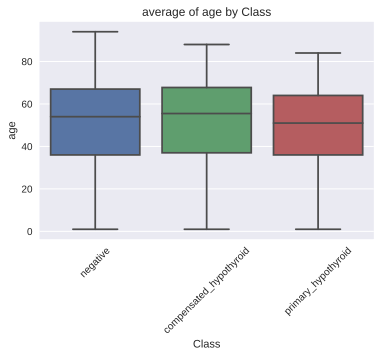

In [ ]:
ax = sns.boxplot(x=TARGET,y='age', data=df)
plt.xticks(rotation=45)
ax.set_title('average of age by Class')
plt.show()

**Conclusion**
* The average age is higher in people with 'compensated_hypothyroid' and is equal to 52 years.
* The 'negative' class has the greatest scope in years, but there are also more observations presented there.

**The relationship between TARGET and TSH**

Class
compensated_hypothyroid    13.867010
negative                    2.182394
primary_hypothyroid        91.813684
Name: TSH, dtype: float64


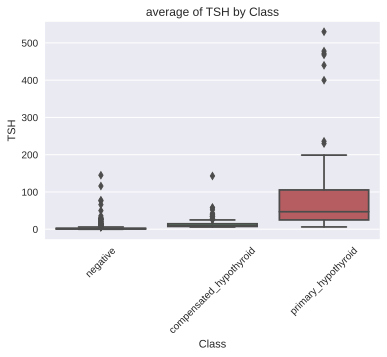

In [ ]:
print(df.groupby([TARGET])['TSH'].mean())

ax = sns.boxplot(x=TARGET,y='TSH', data=df)
plt.xticks(rotation=45)
ax.set_title('average of TSH by Class')
plt.show()

**Conclusion**
* The level of the hormone 'TSH' is the highest in the class 'primary_hypothyroid'.
* The level of the hormone 'TSH' is the lowest in the 'negative' class.
* It turns out that this is an extremely important factor for predictions of the 'primary_hypothyroid'class.

**The relationship between TARGET and FTI**

Class
compensated_hypothyroid     94.330784
negative                   113.376671
primary_hypothyroid         39.800684
Name: FTI, dtype: float64


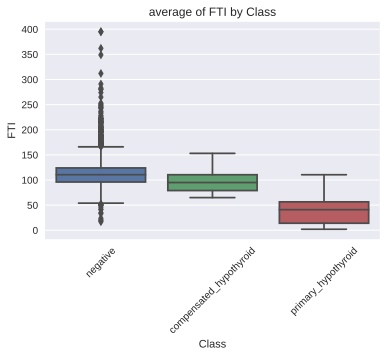

In [ ]:
print(df.groupby([TARGET])['FTI'].mean())

ax = sns.boxplot(x=TARGET,y='FTI', data=df)
plt.xticks(rotation=45)
ax.set_title('average of FTI by Class')
plt.show()

**Conclusion**
* The level of 'FTI' is the highest in the class 'negative'.
* The level of 'FTI' is the lowest in the 'primary_hypothyroid' class.
* It turns out that this is an important factor for predictions of the 'negative' class.

**The relationship between TARGET and T4U**

Class
compensated_hypothyroid    1.002757
negative                   0.993445
primary_hypothyroid        1.035841
Name: T4U, dtype: float64


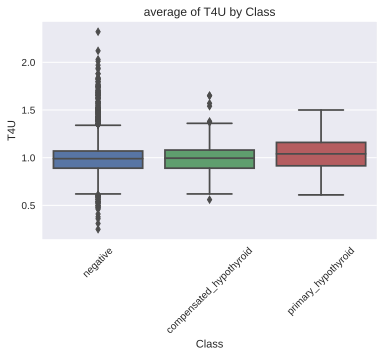

In [ ]:
print(df.groupby([TARGET])['T4U'].mean())

ax = sns.boxplot(x=TARGET,y='T4U', data=df)
plt.xticks(rotation=45)
ax.set_title('average of T4U by Class')
plt.show()


**Conclusion**
* The median level of 'T4U' in classes 'primary_hypothyroid' and  'compensated_hypothyroid' is practically equal.
* The median level of 'T4U' is the lowest in the 'negative' class.

**The relationship between TARGET and TT4**

Class
compensated_hypothyroid     92.101324
negative                   111.289920
primary_hypothyroid         36.397741
Name: TT4, dtype: float64


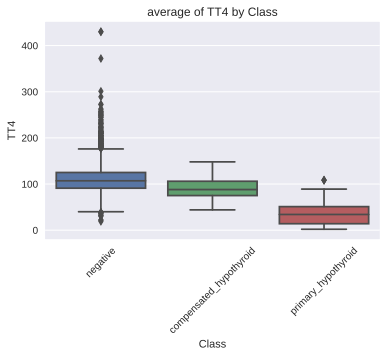

In [ ]:
print(df.groupby([TARGET])['TT4'].mean())

ax = sns.boxplot(x=TARGET,y='TT4', data=df)
plt.xticks(rotation=45)
ax.set_title('average of TT4 by Class')
plt.show()

**Conclusion**
* This feature is highly important for for predictions of the 'negative' class, because the median score is the highest here.

**The relationship between TARGET and T3**

Class
compensated_hypothyroid    1.799483
negative                   2.052103
primary_hypothyroid        1.064437
Name: T3, dtype: float64


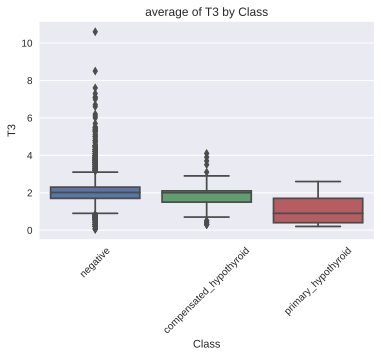

In [ ]:
print(df.groupby([TARGET])['T3'].mean())

ax = sns.boxplot(x=TARGET,y='T3', data=df)
plt.xticks(rotation=45)
ax.set_title('average of T3 by Class')
plt.show()

**Conclusion**
* Relations between  primary_hypothyroid class and T3: has the smallest median value and smallest number of features.
* "negative" class has many outliers here.

**The relationship between TARGET and sex**

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['sex'])
display(x)

sex,F,M
Class,,
compensated_hypothyroid,152,42
negative,2347,1073
primary_hypothyroid,73,22


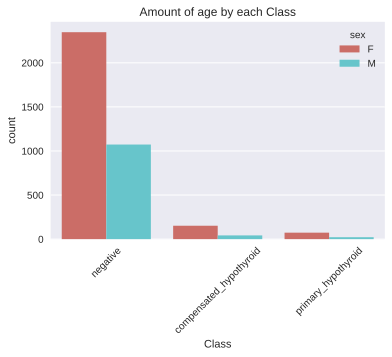

In [ ]:
sns.countplot(data=df, x=TARGET, hue="sex", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of age by each Class')
plt.show()

**Conclusion**
* There are more female representatives in all classes, most likely they are more susceptible to this disease.

**The relationship between TARGET and on_thyroxine**

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['on_thyroxine'])
display(x)

on_thyroxine,f,t
Class,,
compensated_hypothyroid,194,0
negative,2965,455
primary_hypothyroid,86,9


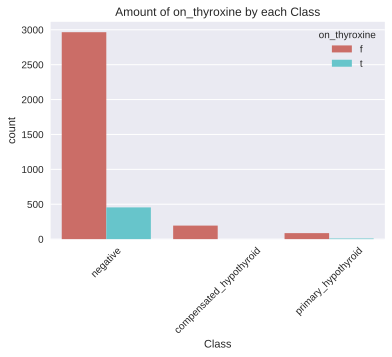

In [ ]:
sns.countplot(data=df, x=TARGET, hue="on_thyroxine", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of on_thyroxine by each Class')
plt.show()

**Conclusion**
* Most people in all classes do not have the hormone.
* The results of 'true' are clearly visible only in the negative and primary_hypothyroid classes.

**The relationship between TARGET and sick**

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['sick'])
display(x)

sick,f,t
Class,,
compensated_hypothyroid,183,11
negative,3284,136
primary_hypothyroid,95,0


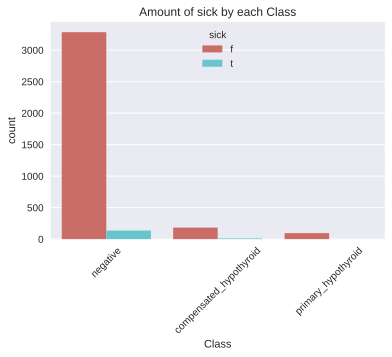

In [ ]:
sns.countplot(data=df, x=TARGET, hue="sick", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of sick by each Class')
plt.show()

**Conclusion**
* There are people who are sick in the negative class, but this class itself prevails in the data.
* Patients in the negative class are also visible.
* There are no patients in the negative class.

**The relationship between TARGET and query_hypothyroid**

query_hypothyroid,f,t
Class,,
compensated_hypothyroid,167,27
negative,3225,195
primary_hypothyroid,84,11


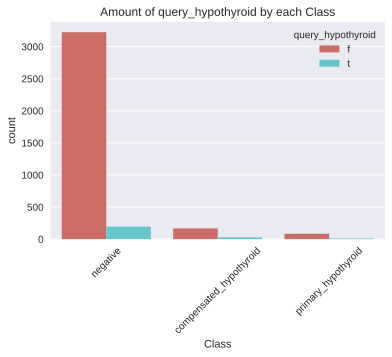

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['query_hypothyroid'])
display(x)

sns.countplot(data=df, x=TARGET, hue="query_hypothyroid", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of query_hypothyroid by each Class')
plt.show()

**Conclusion**
* There are people with query_hypothyroid in the negative class, but this class itself prevails in the data.
* People with query_hypothyroid in compensated_hypothyroid and primary_hypothyroid are practically on the same level.


**The relationship between TARGET and query_hyperthyroid**

query_hyperthyroid,f,t
Class,,
compensated_hypothyroid,182,12
negative,3201,219
primary_hypothyroid,92,3


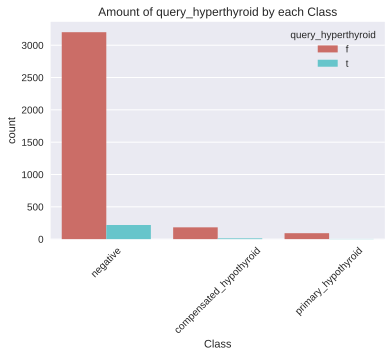

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['query_hyperthyroid'])
display(x)

sns.countplot(data=df, x=TARGET, hue="query_hyperthyroid", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of query_hyperthyroid by each Class')
plt.show()


**Conclusion**
* There are people with query_hyperthyroid in the negative class, but this class itself prevails in the data.
* People with query_hyperthyroid in compensated_hypothyroid and primary_hypothyroid are practically on the same level, very small amount.


**The relationship between TARGET and tumor**

tumor,f,t
Class,,
compensated_hypothyroid,188,6
negative,3332,88
primary_hypothyroid,93,2


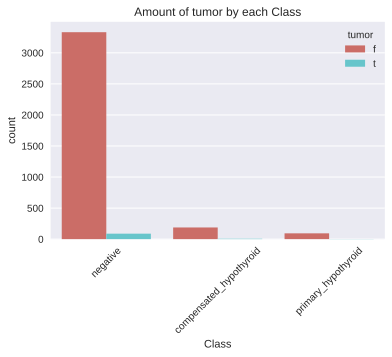

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['tumor'])
display(x)

sns.countplot(data=df, x=TARGET, hue="tumor", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of tumor by each Class')
plt.show()

**Conclusion**
* The biggest amount of people with tumor in the negative class. In other classes this feature practically abcense.



**The relationship between TARGET and psych**

psych,f,t
Class,,
compensated_hypothyroid,186,8
negative,3244,176
primary_hypothyroid,95,0


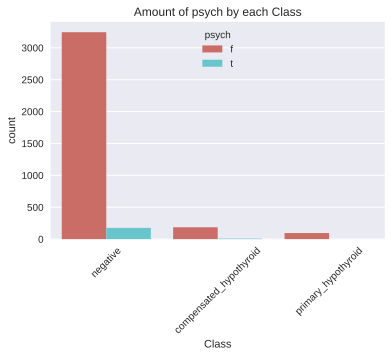

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['psych'])
display(x)

sns.countplot(data=df, x=TARGET, hue="psych", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of psych by each Class')
plt.show()

**Conclusion**
* There are people with psych in the negative class, but this class itself prevails in the data.
* People with psych in the primary_hypothyroid class is zero. 


**The relationship between TARGET and TSH_measured**

TSH_measured,f,t
Class,,
compensated_hypothyroid,0,194
negative,309,3111
primary_hypothyroid,0,95


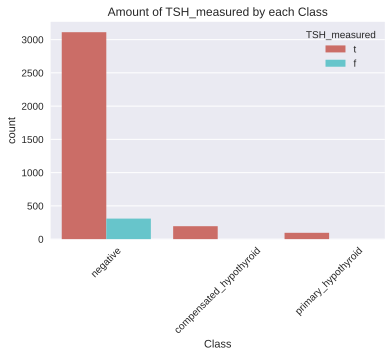

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['TSH_measured'])
display(x)

sns.countplot(data=df, x=TARGET, hue="TSH_measured", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of TSH_measured by each Class')
plt.show()

**Conclusion**
* It is a very important feature for each class, because there are a lot of true values. 


**The relationship between TARGET and T3_measured**

T3_measured,f,t
Class,,
compensated_hypothyroid,37,157
negative,663,2757
primary_hypothyroid,9,86


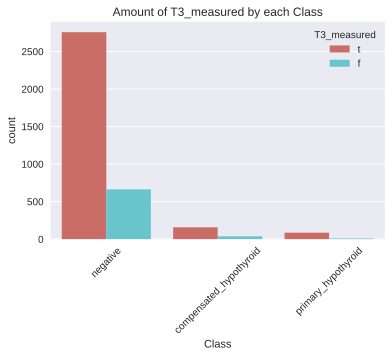

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['T3_measured'])
display(x)

sns.countplot(data=df, x=TARGET, hue="T3_measured", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of T3_measured by each Class')
plt.show()

**Conclusion**
* This measure is high in each class.

**The relationship between TARGET and TT4_measured**

TT4_measured,f,t
Class,,
compensated_hypothyroid,2,192
negative,166,3254
primary_hypothyroid,3,92


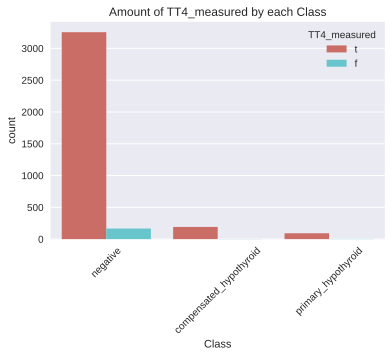

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['TT4_measured'])
display(x)

sns.countplot(data=df, x=TARGET, hue="TT4_measured", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of TT4_measured by each Class')
plt.show()

**Conclusion**
* There are a lot of people with TT4_measured in the negative class, but this class itself prevails in the data.
* More true values in each class.



**The relationship between TARGET and T4U_measured**

T4U_measured,f,t
Class,,
compensated_hypothyroid,17,177
negative,302,3118
primary_hypothyroid,7,88


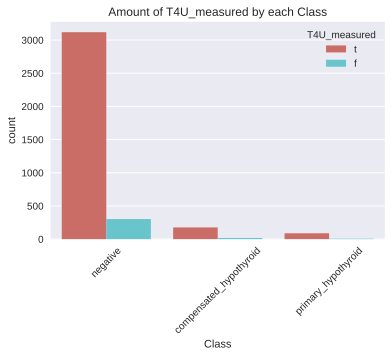

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['T4U_measured'])
display(x)

sns.countplot(data=df, x=TARGET, hue="T4U_measured", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of T4U_measured by each Class')
plt.show()

**Conclusion**
* Practically all features with different "_measures" - tere prevails true ansowers in each class.




**The relationship between TARGET and FTI_measured**

FTI_measured,f,t
Class,,
compensated_hypothyroid,17,177
negative,300,3120
primary_hypothyroid,7,88


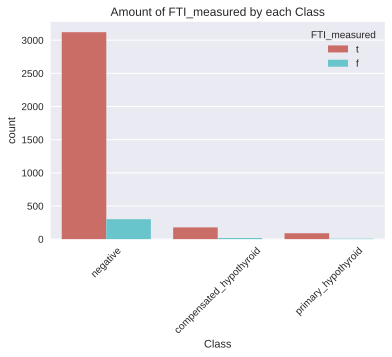

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['FTI_measured'])
display(x)

sns.countplot(data=df, x=TARGET, hue="FTI_measured", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of FTI_measured by each Class')
plt.show()

**Conclusion**
* Practically all features with different "_measures" - there prevails true ansowers in each class.


**The relationship between TARGET and referral_source**

referral_source,STMW,SVHC,SVHD,SVI,other
Class,,,,,
compensated_hypothyroid,4,10,3,58,119
negative,105,375,36,937,1967
primary_hypothyroid,3,1,0,39,52


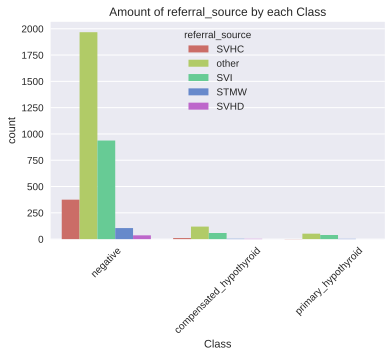

In [ ]:
x = pd.crosstab(df[TARGET], 
                df['referral_source'])
display(x)

sns.countplot(data=df, x=TARGET, hue="referral_source", palette="hls")
plt.xticks(rotation=45)
plt.title('Amount of referral_source by each Class')
plt.show()

**Conclusion**
* "Other" sources prevail in each class.
* Also, the source "SVI"is allocated in each class.

### **Correlation**

* Evaluation of the pairwise dependencies of numerical features.
* Calculation and visualization of the correlation matrix.

In [ ]:
NUMERICAL = df.select_dtypes(exclude=['category', 'object']).columns.tolist()

In [ ]:
num_data = df.loc[:,NUMERICAL]
corr_matrix = num_data.corr().round(4) 
corr_matrix

,age,TSH,T3,TT4,T4U,FTI
age,1.0000,-0.0590,-0.2290,-0.0427,-0.1720,0.0539
TSH,-0.0590,1.0000,-0.1473,-0.2618,0.0710,-0.2933
T3,-0.2290,-0.1473,1.0000,0.5098,0.4072,0.3086
TT4,-0.0427,-0.2618,0.5098,1.0000,0.4269,0.7795
T4U,-0.1720,0.0710,0.4072,0.4269,1.0000,-0.1743
FTI,0.0539,-0.2933,0.3086,0.7795,-0.1743,1.0000


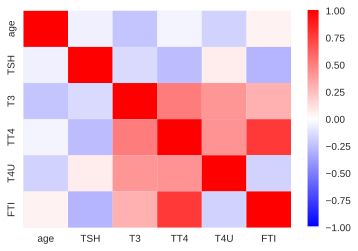

In [ ]:
sns.heatmap(corr_matrix, vmin=-1, vmax=1, cmap='bwr')

**Conclusion**:  
* It is important to understand that if the variables are strongly related to each other, then this can affect the training of the model in a bad way. The model will not adequately calculate the weights and parameters of the model. Therefore, it is better to remove such signs.

* At first glance, it is possible to distinguish a pair of red squares, the greatest dependence is observed between these features.  
1) Features **"T3"** and **"TT4"**.  
2) Features **"T3"** and **"T4U"**.  
3) Features **"T4U"** and **"TT4"**.  
4) Features **"TT4"** and **"FTI"**.  !!!!!!!  

* The correlation between these features is extremely strong, which may indicate a situation of multicollinearity.
* It can be concluded that they give almost the same information, so multicollinearity really takes place.

### **Correlation coefficients**

**'TT4' & 'FTI'**

In [ ]:
np.corrcoef(df['TT4'], df['FTI'])

array([[1.        , 0.77950127],
       [0.77950127, 1.        ]])

This correlation is 0.779, a strong positive correlation, let’s take a look at a scatter chart.

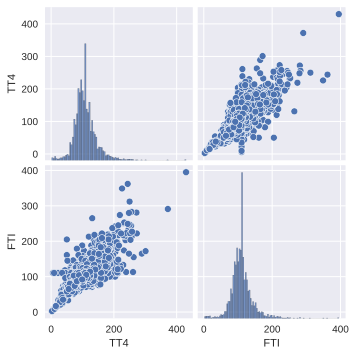

In [ ]:
sns.pairplot(df.loc[:, ['TT4', 'FTI']])
plt.show()

* We can observe the dependence between the variables.

**'T3' & 'TT4'**

In [ ]:
np.corrcoef(df['T3'], df['TT4'])

array([[1.        , 0.50978885],
       [0.50978885, 1.        ]])

This correlation is 0.5, a positive correlation, let’s take a look at a scatter chart. It's not so strong.

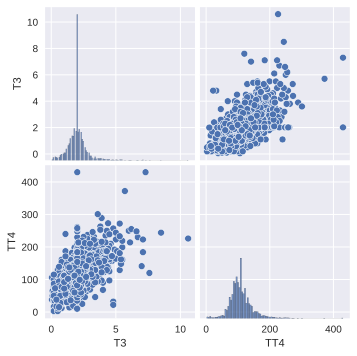

In [ ]:
sns.pairplot(df.loc[:, ['T3', 'TT4']])
plt.show()

* The dependence between the variables is not so high.

**'T3' & 'T4U'**

In [ ]:
np.corrcoef(df['T3'], df['T4U'])

array([[1.        , 0.40718505],
       [0.40718505, 1.        ]])

This correlation is 0.4, not a strong positive correlation, let’s take a look at a pair plot.

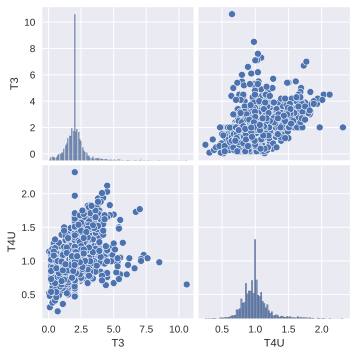

In [ ]:
sns.pairplot(df.loc[:, ['T3', 'T4U']])
plt.show()

**'T4U' & 'TT4'**

In [ ]:
np.corrcoef(df['T4U'], df['TT4'])

array([[1.        , 0.42686625],
       [0.42686625, 1.        ]])

This correlation is 0.42, not a strong positive correlation, let’s take a look at a pair plot.

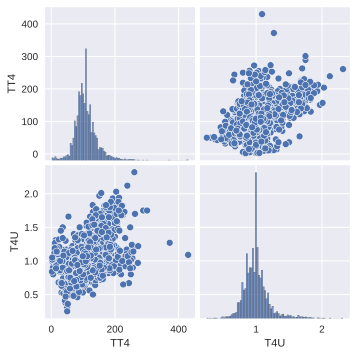

In [ ]:
sns.pairplot(df.loc[:, ['TT4', 'T4U']])
plt.show()

Dropping highly correlated variables:

In [ ]:
df.drop(['TT4', 'FTI'], axis=1, inplace=True)

**Conclusion**

* There are srting correlations between features, hence conclude the presence of multicollinearity in the data, so it's better to delete such features.

## **Transformation**

### **Target encoding**

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(new_df[TARGET])
label_encoder.classes_

array(['compensated_hypothyroid', 'negative', 'primary_hypothyroid'],
      dtype=object)

In [ ]:
X_lab = pd.DataFrame(y_encoded,
                 columns=['Class'], index=new_df.index)

In [ ]:
X_lab.head(5)

,Class
0,1
1,1
2,1
3,1
4,1


In [ ]:
new_df.drop('Class', axis=1, inplace=True)

In [ ]:
new_df = new_df.join(X_lab)

new_df.head(5)

,age,sex,on_thyroxine,query_on_thyroxine,on_antithyroid_medication,sick,pregnant,thyroid_surgery,I131_treatment,query_hypothyroid,query_hyperthyroid,lithium,goitre,tumor,psych,TSH_measured,TSH,T3_measured,T3,TT4_measured,T4U_measured,T4U,FTI_measured,referral_source,Class
0,41.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,t,1.30,t,2.500000,t,t,1.140000,t,SVHC,1
1,23.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,t,4.10,t,2.000000,t,f,0.994989,f,other,1
2,46.0,M,f,f,f,f,f,f,f,f,f,f,f,f,f,t,0.98,f,2.013504,t,t,0.910000,t,other,1
3,70.0,F,t,f,f,f,f,f,f,f,f,f,f,f,f,t,0.16,t,1.900000,t,f,0.994989,f,other,1
4,70.0,F,f,f,f,f,f,f,f,f,f,f,f,f,f,t,0.72,t,1.200000,t,t,0.870000,t,SVI,1


### **Split**

In [ ]:
trainData, testData, train_label, test_label = train_test_split(new_df.drop(TARGET, axis=1),
                                                                new_df[TARGET],
                                                                stratify = new_df[TARGET],
                                                                test_size=0.2,
                                                                random_state=42)

print('Size of train set:', trainData.shape)
print('Size of test set:', testData.shape)

print('\nClass distribution on train:',
      train_label.value_counts(normalize=True),
      '\nClass distribution on test:', 
      test_label.value_counts(normalize=True),
      sep='\n')

Size of train set: (2967, 24)
Size of test set: (742, 24)

Class distribution on train:
1    0.922144
0    0.052241
2    0.025615
Name: Class, dtype: float64

Class distribution on test:
1    0.921833
0    0.052561
2    0.025606
Name: Class, dtype: float64


In [ ]:
classes_names = ['negative', 'compensated_hypothyroid', 'primary_hypothyroid']
num_classes = 3

### **Pipeline**

In [ ]:
cat = ['referral_source']

numerical = ['age', 'TSH', 'T3', 'T4U']

binary = ['sex', 'on_thyroxine', 'query_on_thyroxine',
       'on_antithyroid_medication', 'sick', 'pregnant', 'thyroid_surgery',
       'I131_treatment', 'query_hypothyroid', 'query_hyperthyroid', 'lithium',
       'goitre', 'tumor', 'psych', 'TSH_measured', 'T3_measured',
       'TT4_measured', 'T4U_measured', 'FTI_measured']

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OrdinalEncoder 

cat_pipe = Pipeline([
    ('ohe', OneHotEncoder(sparse=False)), 
    ('scaler', StandardScaler())
])

bin_pipe = Pipeline([
    ('ohe', OrdinalEncoder())
    ,('scaler', StandardScaler())
])


log_pipe = Pipeline([
    ('ft', FunctionTransformer(np.log1p))
    ,('scaler', StandardScaler())
])

pipe = ColumnTransformer(transformers=[
    ('cat', cat_pipe, cat),
    ('bin', bin_pipe, binary),
    ('log', log_pipe, numerical)
])

In [ ]:
trainData = pd.DataFrame(pipe.fit_transform(trainData))
testData = pd.DataFrame(pipe.transform(testData))

### **SMOTE**
Improve problem of imbalanced classification dataset

In [ ]:
from collections import Counter
from imblearn.over_sampling import SMOTE

In [ ]:
smote = SMOTE(random_state = 11)
trainData, train_label = smote.fit_resample(trainData, train_label)

print('Resampled dataset shape %s' % Counter(train_label))

Resampled dataset shape Counter({1: 2736, 2: 2736, 0: 2736})


## **Models**

### **PyTorch**

**Device selection**  
Selecting device, whether to use CPU or GPU for model.

In [ ]:
# device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# # Assuming that we are on a CUDA machine, this should print a CUDA device:

# print(device)

cuda:0


* I decided not to use the GPU for training, since the datasets are small + I have a free google colab and rarely manage to get a GPU.

**Define train, test and validation dfs as a Pytorch Tensor**

In [ ]:
trainData.shape, train_label.shape, testData.shape, test_label.shape

((8208, 28), (8208,), (742, 28), (742,))

In [ ]:
inputs = torch.from_numpy( np.array(trainData, dtype='float32'))
targets = torch.from_numpy( np.array(train_label, dtype='int64'))

In [ ]:
dataset = TensorDataset(inputs, targets)

In [ ]:
num_rows = len(trainData)

val_percent = 0.1 # between 0.1 and 0.2
val_size = int(num_rows * val_percent)
print(val_size)
train_size = num_rows - val_size
print(train_size)

train_ds, val_ds = random_split(dataset,[train_size, val_size]) # Use the random_spli

820
7388


In [ ]:
batch_size = 64

In [ ]:
train_loader = DataLoader(train_ds, batch_size, shuffle=True)
val_loader = DataLoader(val_ds, batch_size)

**Build Model and train it**

* Build **softmax** Classifier
* Loss function - *cross_entropy*

In [ ]:
class ClassifNet(nn.Module):
    def __init__(self, D_in, H, D_out):
        super(ClassifNet,self).__init__()
        self.linear1=nn.Linear(D_in,H)
        self.linear2=nn.Linear(H,D_out)
        
        
    def forward(self,x):
        x=torch.sigmoid(self.linear1(x))  
        x=self.linear2(x)
        sm=nn.Softmax(dim=-1) #
        x = sm(x)
        return x

    def training_step(self, batch):
        inputs, targets = batch 
        # Generate predictions
        out = self(inputs)          
        # Calcuate loss
        loss = F.cross_entropy(out, targets)                
        return loss

    def validation_step(self, batch):
        inputs, targets = batch
        # Generate predictions
        out = self(inputs)
        # Calculate loss
        loss = F.cross_entropy(out, targets)                    
        return {'val_loss': loss.detach()}
        
    def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        return {'val_loss': epoch_loss.item()}
    
    def epoch_end(self, epoch, result, num_epochs):
        # Print result every 20th epoch
        if (epoch+1) % 50 == 0 or epoch == num_epochs-1:
            print("Epoch [{}], val_loss: {:.4f}".format(epoch+1, result['val_loss']))

In [ ]:
input_dim=28     # how many Variables are in the dataset
hidden_dim = 25 # hidden layers
output_dim=3    # number of classes

In [ ]:
def evaluate(model, val_loader):
    model.eval() #
    with torch.no_grad(): #
      outputs = [model.validation_step(batch) for batch in val_loader]
      return model.validation_epoch_end(outputs)

def train(epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.SGD):  # train
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train() #
        for batch in train_loader:
            loss = model.training_step(batch)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        model.epoch_end(epoch, result, epochs)
        history.append(result)
    return history

In [ ]:
# Instantiate model
clss_model=ClassifNet(input_dim,hidden_dim,output_dim)

In [ ]:
history = [evaluate(clss_model,val_loader)]
print(history)

[{'val_loss': 1.1111162900924683}]


In [ ]:
epochs = 1000
lr = 0.005
history += train(epochs, lr, clss_model, train_loader, val_loader)

Epoch [50], val_loss: 0.9037
Epoch [100], val_loss: 0.7941
Epoch [150], val_loss: 0.7343
Epoch [200], val_loss: 0.6993
Epoch [250], val_loss: 0.6770
Epoch [300], val_loss: 0.6616
Epoch [350], val_loss: 0.6505
Epoch [400], val_loss: 0.6422
Epoch [450], val_loss: 0.6360
Epoch [500], val_loss: 0.6311
Epoch [550], val_loss: 0.6271
Epoch [600], val_loss: 0.6239
Epoch [650], val_loss: 0.6212
Epoch [700], val_loss: 0.6189
Epoch [750], val_loss: 0.6170
Epoch [800], val_loss: 0.6153
Epoch [850], val_loss: 0.6138
Epoch [900], val_loss: 0.6124
Epoch [950], val_loss: 0.6113
Epoch [1000], val_loss: 0.6102


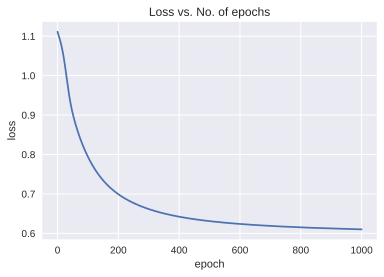

In [ ]:
losses = [x['val_loss'] for x in history]
plt.plot(losses, '-x')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.title('Loss vs. No. of epochs');

As we can see the loss value goes down, as it is needed

**Make predictions**

In [ ]:
input_x_test = torch.from_numpy(np.array(testData, dtype='float32'))

with torch.no_grad(): #
  test_predictions = clss_model(input_x_test.float()).data.numpy()

In [ ]:
test_predictions_df = pd.DataFrame(test_predictions, columns=['negative', 'compensated_hypothyroid', 'primary_hypothyroid'])

test_label.reset_index(drop=True, inplace=True)
test_predictions_df.reset_index(drop=True, inplace=True)

test_labels_with_predictions_df = pd.concat([test_label, test_predictions_df], axis=1)

In [ ]:
test_d = torch.from_numpy( np.array(testData, dtype='float32'))
with torch.no_grad(): #
  z=clss_model(test_d)

In [ ]:
yhat=torch.max(z.data,1)  # [1]
yhat[1]

tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
        0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0,
        1, 1, 1, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 2, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
        2, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1,

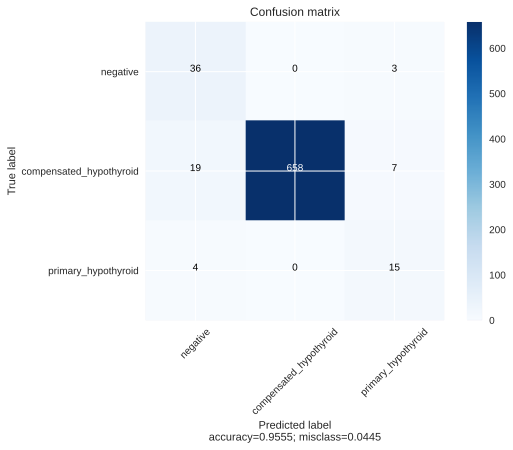

Accuracy: 0.95553 
Balanced accuracy: 0.89151 
Multiclass f1-score: 
    micro: 0.95553 
    macro: 0.79905 
    weighted: 0.96005


Classification report:

              precision    recall  f1-score   support

           0    0.61017   0.92308   0.73469        39
           1    1.00000   0.96199   0.98063       684
           2    0.60000   0.78947   0.68182        19

    accuracy                        0.95553       742
   macro avg    0.73672   0.89151   0.79905       742
weighted avg    0.96927   0.95553   0.96005       742



In [ ]:
calc_metrics(test_label, yhat[1])

**Conclusion** 

* Simple **accuracy** gives an excellent result-0.95, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.89, which is slightly lower, but still good.

* My classifier perfectly identifies the first class, almost one. The values of the other classes are 0.7+ and 0.7, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. These scores are explained by a strong imbalance of classes and even the *SMOTE* algorithm has not improved the situation.

**Comparison with ML models and with scores in the ML version of this work**  

* If we compare with ML regression models, then ML models coped better with an unbalanced dataset and predictions.


**ML classification model:**  

Accuracy: 0.96765   
Balanced accuracy: 0.942   
Multiclass f1-score:   
    * micro: 0.96765   
    * macro: 0.88402   
    * weighted: 0.97024  


*Classification report:*  

              precision    recall  f1-score   support

           0    0.67188   0.95556   0.78899        45
           1    1.00000   0.97046   0.98501       677
           2    0.85714   0.90000   0.87805        20

    accuracy                          0.96765       742
    macro avg      0.84301  0.94200   0.88402       742
    weighted avg   0.97625  0.96765   0.97024       742

 



### **TensorFlow**

**Prepare train, test, val ds**

In [ ]:
trainData.shape, train_label.shape, testData.shape, test_label.shape

((8208, 28), (8208,), (742, 28), (742,))

In [ ]:
trainData, valData, train_label, val_label = train_test_split(trainData,
                                                              train_label, 
                                                              stratify=train_label,
                                                              test_size=0.2, 
                                                              random_state=42)

In [ ]:
trainData.shape, valData.shape, train_label.shape, val_label.shape

((6566, 28), (1642, 28), (6566,), (1642,))

In [ ]:
train_label = pd.get_dummies(train_label)
val_label = pd.get_dummies(val_label)
train_label.shape, val_label.shape

((6566, 3), (1642, 3))

In [ ]:
val_label.value_counts()

0  1  2
0  0  1    548
1  0  0    547
0  1  0    547
dtype: int64

In [ ]:
print(len(trainData), 'train examples')
print(len(valData), 'validation examples')
print(len(testData), 'test examples')

6566 train examples
1642 validation examples
742 test examples


**Train model**

In [ ]:
model = Sequential()
model.add(Dense(15, input_dim = 28, activation = 'relu')) # Rectified Linear Unit Activation Function
model.add(Dense(15, activation = 'relu'))
model.add(Dense(3, activation = 'softmax')) # Softmax for multi-class classification
# Compile model here
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

history = model.fit(trainData, train_label,batch_size=64, validation_data=(valData, val_label), epochs=100, verbose=0)

# evaluate the model
_, train_acc = model.evaluate(trainData, train_label, verbose=0)
_, val_acc = model.evaluate(valData, val_label, verbose=0)
print('Train: %.3f, Val: %.3f' % (train_acc, val_acc))

Train: 0.990, Val: 0.988


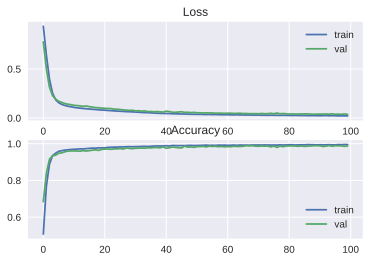

In [ ]:
# plot loss during training
plt.subplot(211)
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.legend()
# plot accuracy during training
plt.subplot(212)
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='val')
plt.legend()
plt.show()

**Make prediction**

In [ ]:
test_predictions = model.predict(testData)

y_classes = test_predictions.argmax(axis=-1)
y_classes

array([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 2, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       2, 1, 0, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 2, 1, 1, 1, 1,

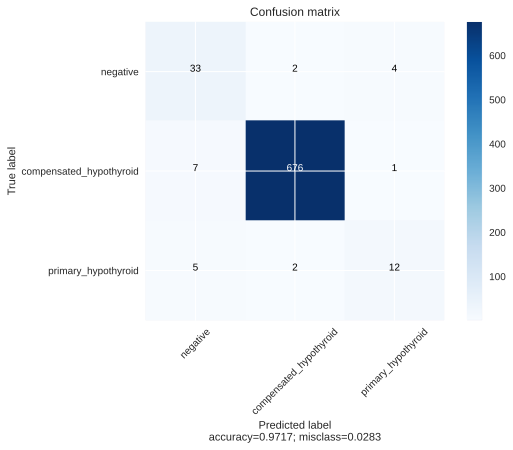

Accuracy: 0.9717 
Balanced accuracy: 0.82201 
Multiclass f1-score: 
    micro: 0.9717 
    macro: 0.81453 
    weighted: 0.97209


Classification report:

              precision    recall  f1-score   support

           0    0.73333   0.84615   0.78571        39
           1    0.99412   0.98830   0.99120       684
           2    0.70588   0.63158   0.66667        19

    accuracy                        0.97170       742
   macro avg    0.81111   0.82201   0.81453       742
weighted avg    0.97303   0.97170   0.97209       742



In [ ]:
calc_metrics(test_label, y_classes)

**Conclusion** 

* Simple **accuracy** gives an excellent result-0.97, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.82, which is slightly lower, but still good.

* My classifier perfectly identifies the first class, almost one. The values of the other classes are 0.8 and 0.66, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. These scores are explained by a strong imbalance of classes and even the *SMOTE* algorithm has not improved the situation.

**Comparison with ML models and with scores in the ML version of this work**  

* If we compare with ML regression models, then ML models coped better with an unbalanced dataset and predictions.

* If we compare the work of the TenserFlow model with the Pwtorch model, then they worked about the same.

**ML classification model:**  

Accuracy: 0.96765   
Balanced accuracy: 0.942   
Multiclass f1-score:   
    * micro: 0.96765   
    * macro: 0.88402   
    * weighted: 0.97024  


*Classification report:*  

              precision    recall  f1-score   support

           0    0.67188   0.95556   0.78899        45
           1    1.00000   0.97046   0.98501       677
           2    0.85714   0.90000   0.87805        20

    accuracy                          0.96765       742
    macro avg      0.84301  0.94200   0.88402       742
    weighted avg   0.97625  0.96765   0.97024       742

 



# <center> **CV**

## <center> **Hot-Dog/Not Hot-Dog Data Set**

## Table of Contents

1. **[Preprocessing](#1)**
2. **[PyTorch](#2)**
	* [Dataset Loader](#sub-heading1)
	* [Augmentation](#sub-heading2)
	* [Baseline model](#sub-heading3)
	* [Pre-trained models](#sub-heading3)
		* [Utils](#sub-sub-heading3)
		* [ResNet18](#sub-sub-heading3)
			* [Freezed layers](#sub-sub-sub-heading3)
			* [Fine tune](#sub-sub-sub-heading3)
		* [MobileNet v3](#sub-sub-heading3)
			* [Freezed layers](#sub-sub-sub-heading3)
			* [Fine tune](#sub-sub-sub-heading3)
3. **[TensorFlow](#3)**
	* [Dataset Loader](#sub-heading1)
	* [Augmentation](#sub-heading2)
	* [Baseline model](#sub-heading3)
	* [Pre-trained models](#sub-heading3)
		* [Densenet](#sub-sub-heading3)
			* [Freezed layers](#sub-sub-sub-heading3)
4. **[General conclusion](#4)**





## **Functions**

**Save models (PyTorch)**

In [ ]:
# for PyTorch
def save_checkpoint(model, optimizer, learning_rate, iteration, filepath):
    print("Saving model and optimizer state at iteration {} to {}".format(
        iteration, filepath))

    model_state_dict = model.state_dict().copy()

    torch.save({'iteration': iteration,
                'state_dict': model_state_dict,
                'optimizer': optimizer.state_dict(),
                'learning_rate': learning_rate}, filepath)

In [ ]:
# for PyTorch
def load_checkpoint(checkpoint_path, model, optimizer):
    assert os.path.isfile(checkpoint_path)
    print("Loading checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')

    model.load_state_dict(checkpoint_dict['state_dict'])
    optimizer.load_state_dict(checkpoint_dict['optimizer'])
    learning_rate = checkpoint_dict['learning_rate']
    iteration = checkpoint_dict['iteration']
    print("Loaded checkpoint '{}' from iteration {}" .format(
        checkpoint_path, iteration))
    return model, optimizer, learning_rate, iteration

**Resize and crop to square**

In [ ]:
def preproc_imgs(path, s, save_path, class_name):
    for _,_, files in os.walk(path):
      count = 0
      for f_name in files:
        img = Image.open(path + f_name)
        # crop to square
        width, height = img.size 

        new_size = 0
        if width <= height:
          new_size = width
        else:
          new_size = height

        if  width < s or height < s:
          continue

        left = (width - new_size)/2
        top = (height - new_size)/2
        right = (width + new_size)/2
        bottom = (height + new_size)/2

        # Crop the center of the image
        img = img.crop((left, top, right, bottom))

        # reduce size
        size = s, s

        img.thumbnail(size, Image.ANTIALIAS)
        img.save(save_path + class_name + '_' + f_name)
        count += 1
    print('DONE!')
    print('Size: ', count)

**Show imgs**

In [ ]:
def img_display(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    npimg = np.transpose(npimg, (1, 2, 0))
    return npimg

**Metrics**

In [ ]:
def calc_metrics(test_label, preds):
    classes_names = ['NOT HD', 'HD']
    num_classes = 2

    plot_confusion_matrix(cm=metrics.confusion_matrix(test_label, preds),
                          target_names=classes_names,
                          normalize=False)
    
    print("Accuracy:",
          round(metrics.accuracy_score(test_label, preds), 5),
        '\nBalanced accuracy:',
        round(metrics.balanced_accuracy_score(test_label, preds), 5), 
        '\nMulticlass f1-score:',
        '\n    micro:', round(metrics.f1_score(test_label, preds, average='micro'), 5),
        '\n    macro:', round(metrics.f1_score(test_label, preds, average='macro'), 5),
        '\n    weighted:', round(metrics.f1_score(test_label, preds, average='weighted'), 5))

    print('\n\nClassification report:\n')
    print(metrics.classification_report(test_label, preds, digits=5))

## **Preprocessing**

In [ ]:
train_data_dir_1 = '/content/drive/My Drive/DA/HW11/train/hot_dog/'  
train_data_dir_0 = '/content/drive/My Drive/DA/HW11/train/not_hot_dog/'  

test_data_dir_1 = '/content/drive/My Drive/DA/HW11/test/hot_dog/' 
test_data_dir_0 = '/content/drive/My Drive/DA/HW11/test/not_hot_dog/' 

train_path = '/content/drive/My Drive/DA/HW11/Data/train_folder/'
test_path = '/content/drive/My Drive/DA/HW11/Data/test_folder/'


In [ ]:
img_size = 64

* Before working with photos, we need to make them the same size, since the photos are all of different shapes and sizes in the presented dataset (square img_size*img_size).

* I chose the size **64*64** so that the models learn faster, perhaps this may affect the quality of predictions and accuracy of models, but wider photo formats should be used when training on more powerful machines. According to my preliminary assessment, this permission would be enough to solve such a problem

* I save the processed photos separately (train_path, test_path). Since the photos of Hot dogs and non-hot dogs were in different folders, now I don't divide them, and assign a class to the file name (0-not hd, 1 - hd).

**Train**

In [ ]:
preproc_imgs(train_data_dir_1, img_size, train_path, '1')

DONE!
Size:  249


In [ ]:
preproc_imgs(train_data_dir_0, img_size, train_path, '0')

DONE!
Size:  249


**Test**

In [ ]:
preproc_imgs(test_data_dir_1, img_size, test_path, '1')

DONE!
Size:  250


In [ ]:
preproc_imgs(test_data_dir_0, img_size, test_path, '0')

DONE!
Size:  250


# **PyTorch**

### **Dataset Loader**

We need to have access to the photos, I prescribe an iterator class that will load each image during iterations, since the dataset is small, I think this method is the most convenient and it is not worth saving pre-processed (augmentation, transformation into tensors, normalization) images in a separate place.

In [ ]:
class LoadHotDogDataset(Dataset):
    def __init__(self, file_list, dir, transform = None):
        self.file_list = file_list
        self.dir = dir
        self.transform = transform
            
    def __len__(self):
        return len(self.file_list)
    
    def __getitem__(self, idx):
        img = Image.open(os.path.join(self.dir, self.file_list[idx]))
        
        if self.transform:
            img = self.transform(img)

        if self.file_list[idx][0] == '0':
          label = 0
          return img, label
        else:
          label = 1
          return img, label
     
data_transform = transforms.Compose([
    transforms.ToTensor(),
    # Normalize the pixel values (in R, G, and B channels)
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

**Train**

In [ ]:
train_files = [f for f in listdir(train_path) if isfile(join(train_path, f))]
train_df = LoadHotDogDataset(train_files, train_path, transform = data_transform)

In [ ]:
train_size = len(train_df)
train_size

498

**Test**

In [ ]:
test_files = [f for f in listdir(test_path) if isfile(join(test_path, f))]
test_df = LoadHotDogDataset(test_files, test_path, transform = data_transform)

In [ ]:
test_size = len(test_df)
test_size

500

**!** 
As you can see, the size of the test sample almost coincides with the train sample, which is not very good. The size of the test should be smaller, so despite the fact that I will do data augmentation on the train, I will take some samples from the test sample for validation.

**Val**

In [ ]:
train_additional, test_df, val_df = torch.utils.data.random_split(test_df, [300, 100, 100])
len(train_additional), len(test_df), len(val_df)

(300, 100, 100)

In [ ]:
train_df = ConcatDataset([train_df, train_additional])

train_size = len(train_df)
train_size

798

### **Augmentation**

Since the initial dataset is extremely small, it is worth expanding it by applying various types of image augmentation. I do this step only on the train dataset, I leave the validation and test "clean". As a result, it turned out about 3000 photos. I think that if the power of the machine allows, then you can take more photos. But it is not a fact that there will be no memory leaks during augmentation (duplicates).

**Transformations**

In [ ]:
transform1 = transforms.Compose([                                
    # transforms.ColorJitter(),
    # Random horizontal flip
    transforms.RandomHorizontalFlip(0.1),
    # Random vertical flip
    transforms.RandomVerticalFlip(0.8),
    # transform to tensors
    transforms.ToTensor(),
    # Normalize the pixel values (in R, G, and B channels)
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

transform2 = transforms.Compose([                              
    # transforms.ColorJitter(),
    transforms.RandomVerticalFlip(0.5),
    # transform to tensors
    transforms.ToTensor(),
    # Normalize the pixel values (in R, G, and B channels)
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

transform3 = transforms.Compose([
    # Random horizontal flip
    transforms.RandomHorizontalFlip(0.4),
    # Random vertical flip
    transforms.RandomVerticalFlip(0.4),
    # transform to tensors
    transforms.ToTensor(),
    # Normalize the pixel values (in R, G, and B channels)
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])


class AddGaussianNoise(object):
    def __init__(self, mean=0., std=1.):
        self.std = std
        self.mean = mean
        
    def __call__(self, tensor):
        return tensor + torch.randn(tensor.size()) * self.std + self.mean
    
    def __repr__(self):
        return self.__class__.__name__ + '(mean={0}, std={1})'.format(self.mean, self.std)


transform4 = transforms.Compose([
    transforms.ToTensor(),
    AddGaussianNoise(0.1, 0.08),
    # Normalize the pixel values (in R, G, and B channels)
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

transform5 = transforms.Compose([
    # transforms.RandomGrayscale(),
    
    transforms.RandomHorizontalFlip(0.3),
    transforms.RandomVerticalFlip(0.3),
    transforms.ToTensor(),
    # AddGaussianNoise(0.1, 0.08),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])


**Apply transform to train**

In [ ]:
aug_df_train_1 = LoadHotDogDataset(train_files, train_path, transform = transform1)

In [ ]:
aug_df_train_2 = LoadHotDogDataset(train_files, train_path, transform = transform2)

In [ ]:
aug_df_train_3 = LoadHotDogDataset(train_files, train_path, transform = transform3)

In [ ]:
aug_df_train_4 = LoadHotDogDataset(train_files, train_path, transform = transform4)

In [ ]:
aug_df_train_5 = LoadHotDogDataset(train_files, train_path, transform = transform5)

**Concatenate Train DF and all augmented DFs**

In [ ]:
train_df = ConcatDataset([train_df, aug_df_train_1, aug_df_train_2, aug_df_train_3, aug_df_train_4, aug_df_train_5])

train_size = len(train_df)
train_size

3288

**DataLoader**

In [ ]:
BATCH_SIZE = 32

In [ ]:
train_loader = DataLoader(
    train_df, 
    batch_size=BATCH_SIZE,
    shuffle=True
)

In [ ]:
val_loader = DataLoader(
    val_df, 
    batch_size=BATCH_SIZE,
    shuffle=True
)

In [ ]:
test_loader = DataLoader(
    test_df, 
    batch_size=BATCH_SIZE,
    shuffle=True
)

Load all test samples for finale prediction

In [ ]:
test_df_loaded = list(test_df)

In [ ]:
test_images = torch.stack([img for img, label in test_df_loaded])
print("Test images: ", test_images.shape)

Test images:  torch.Size([100, 3, 64, 64])


In [ ]:
test_labels = torch.tensor([label for img, label in test_df_loaded])
print("Test labels: ", test_labels.shape)

Test labels:  torch.Size([100])


**View IMGs (batch) (normal ds + augmentation)**

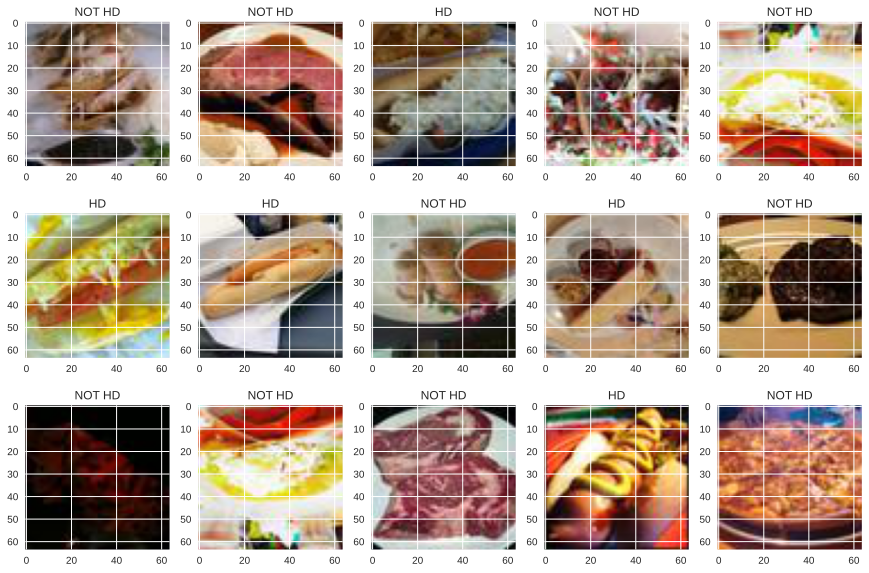

In [ ]:
#  get some random training images
images, labels = next(iter(train_loader))

arthopod_types = {0: 'NOT HD', 1: 'HD'}
# Viewing data examples used for training
fig, axis = plt.subplots(3, 5, figsize=(15, 10))
for i, ax in enumerate(axis.flat):
    with torch.no_grad():
        image, label = images[i], labels[i]
        ax.imshow(img_display(image)) # add image
        ax.set(title = f"{arthopod_types[label.item()]}") # add label

### **Baseline model**

In [ ]:
# Create CNN Model
class CNNModel(nn.Module):
    def __init__(self):
        super(CNNModel, self).__init__()
        
        # Convolution 1
        self.cnn1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=5, stride=1, padding=0)
        self.relu1 = nn.ReLU()
        
        # Max pool 1
        self.maxpool1 = nn.MaxPool2d(kernel_size=2)
     
        # Convolution 2
        self.cnn2 = nn.Conv2d(in_channels=16, out_channels=2, kernel_size=5, stride=1, padding=0)
        self.relu2 = nn.ReLU()
        
        # Max pool 2
        self.maxpool2 = nn.MaxPool2d(kernel_size=2)
        
        # Fully connected 1
        self.fc1 = nn.Linear(13 * 13 * 2, 128) 

        self.relu2 = nn.ReLU()   
        self.fc2 = nn.Linear(128, 2)
    
        self.sm = nn.Softmax(dim=-1) 

    def forward(self, x):
        # Convolution 1
        out = self.cnn1(x)
        out = self.relu1(out)
        
        # Max pool 1
        out = self.maxpool1(out)
        
        # Convolution 2 
        out = self.cnn2(out)
        out = self.relu2(out)
        
        # Max pool 2 
        out = self.maxpool2(out)
        
        # flatten
        out = out.view(out.size(0), -1)

        # Linear function 1
        out = self.fc1(out)
        out = self.relu2(out)

        # Linear function (readout)
        out = self.fc2(out)

        out = self.sm(out)

        return out

I picked *learning rate* up by a small search method and stopped at 0.01.

In [ ]:
# Create CNN
model = CNNModel()

# Cross Entropy Loss 
error = nn.CrossEntropyLoss()

# SGD Optimizer
learning_rate = 0.01  
num_epochs = 80
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)

In [ ]:
# CNN model training
count = 0
loss_list = []
iteration_list = []
accuracy_list = []

for epoch in range(num_epochs):
    for i, (images, labels) in enumerate(train_loader):
        
        model.train()
        # Clear gradients
        optimizer.zero_grad()
        
        # Forward propagation
        outputs = model(images)
        
        # Calculate softmax and ross entropy loss
        loss = error(outputs, labels)
        
        # Calculating gradients
        loss.backward()
        
        # Update parameters
        optimizer.step()
        
        count += 1
        
        if count % 50 == 0:
            model.eval()
            with torch.no_grad():
                # Calculate Accuracy         
                correct = 0
                total = 0
                # Iterate through test dataset
                for images, labels in val_loader:
                    
                    # Forward propagation
                    outputs = model(images)
                    
                    # Get predictions from the maximum value
                    predicted = torch.max(outputs.data, 1)[1]
                    
                    # Total number of labels
                    total += len(labels)
                    
                    correct += (predicted == labels).sum()
                
                accuracy = 100 * correct / float(total)
                
                # store loss and iteration
                loss_list.append(loss.data)
                iteration_list.append(count)
                accuracy_list.append(accuracy)
                print('Iteration: {}  Loss: {}  Accuracy: {} %'.format(count, loss.data, accuracy))

Iteration: 50  Loss: 0.6952096223831177  Accuracy: 49.0 %
Iteration: 100  Loss: 0.6947986483573914  Accuracy: 49.0 %
Iteration: 150  Loss: 0.6870920658111572  Accuracy: 63.0 %
Iteration: 200  Loss: 0.6920034289360046  Accuracy: 64.0 %
Iteration: 250  Loss: 0.6950594782829285  Accuracy: 66.0 %
Iteration: 300  Loss: 0.6938706040382385  Accuracy: 56.0 %
Iteration: 350  Loss: 0.6781710386276245  Accuracy: 55.0 %
Iteration: 400  Loss: 0.6837865114212036  Accuracy: 64.0 %
Iteration: 450  Loss: 0.6837040781974792  Accuracy: 63.0 %
Iteration: 500  Loss: 0.6664125323295593  Accuracy: 59.0 %
Iteration: 550  Loss: 0.7033604979515076  Accuracy: 60.0 %
Iteration: 600  Loss: 0.6882278323173523  Accuracy: 63.0 %
Iteration: 650  Loss: 0.6598154306411743  Accuracy: 64.0 %
Iteration: 700  Loss: 0.6440920829772949  Accuracy: 62.0 %
Iteration: 750  Loss: 0.6797584295272827  Accuracy: 62.0 %
Iteration: 800  Loss: 0.6420802474021912  Accuracy: 65.0 %
Iteration: 850  Loss: 0.6307007670402527  Accuracy: 61.0 

 **Visualization**

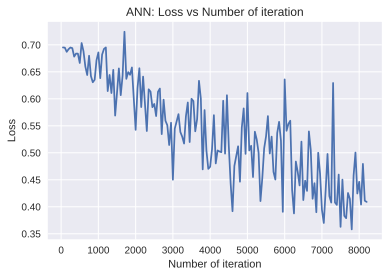

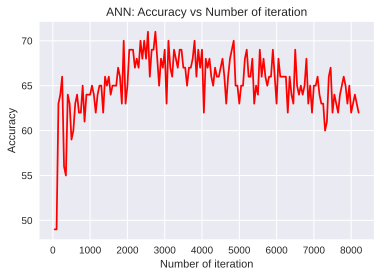

In [ ]:
# visualization loss 
plt.plot(iteration_list,loss_list)
plt.xlabel("Number of iteration")
plt.ylabel("Loss")
plt.title("ANN: Loss vs Number of iteration")
plt.show()

# visualization accuracy 
plt.plot(iteration_list,accuracy_list,color = "red")
plt.xlabel("Number of iteration")
plt.ylabel("Accuracy")
plt.title("ANN: Accuracy vs Number of iteration")
plt.show()

**Save model**

In [ ]:
model_path = '/content/drive/My Drive/DA/HW11/Data/Models/cnn_model_hd_classif'

save_checkpoint(model, optimizer, learning_rate, num_epochs, model_path)

Saving model and optimizer state at iteration 80 to /content/drive/My Drive/DA/HW11/Data/Models/cnn_model_hd_classif


Function for loading model

In [ ]:
# load_checkpoint(model_path, model, optimizer)

**Prediction**

In [ ]:
test_loader = DataLoader(
    test_df, 
    batch_size=len(test_df),
    shuffle=False
)

In [ ]:
test_imgs, test_lbls = next(iter(test_loader))

with torch.no_grad(): 
  z = model(test_imgs)

In [ ]:
yhat=torch.max(z.data,1)  # [1]
yhat[1]

tensor([0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1,
        0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1,
        0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0,
        1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1,
        0, 0, 0, 1])

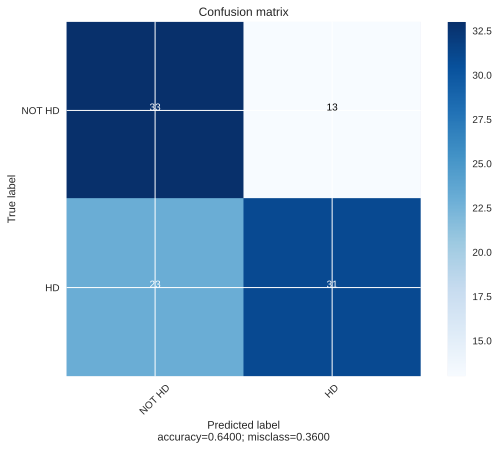

Accuracy: 0.64 
Balanced accuracy: 0.64573 
Multiclass f1-score: 
    micro: 0.64 
    macro: 0.63986 
    weighted: 0.63928


Classification report:

              precision    recall  f1-score   support

           0    0.58929   0.71739   0.64706        46
           1    0.70455   0.57407   0.63265        54

    accuracy                        0.64000       100
   macro avg    0.64692   0.64573   0.63986       100
weighted avg    0.65153   0.64000   0.63928       100



In [ ]:
calc_metrics(test_lbls, yhat[1])

**Conclusion** 

* Simple **accuracy** gives poor result-0.64, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.64, which still bad.

* My classifier identifies both classes a little bit better than random model. The values of classes are 0.65 and 0.6, which is not so good. This fact is also confirmed by the **f1-score** metric. 

### **Pre-trained model**

In [ ]:
import torchvision.models as models
from torchsummary import summary

I would like to try 2 pretrained models with Pytorch:
* Resnet18
* Mobilenet V3 Large

And 2 pretrained models with Tensorflow:
* Xception
* DenseNet

### **Utils**

This method will freeze all layers to stop gradient flow:

In [ ]:
def save_checkpoint(model, optimizer, learning_rate, iteration, filepath):
    print("Saving model and optimizer state at iteration {} to {}".format(
        iteration, filepath))

    model_state_dict = model.state_dict().copy()

    torch.save({'iteration': iteration,
                'state_dict': model_state_dict,
                'optimizer': optimizer.state_dict(),
                'learning_rate': learning_rate}, filepath)

In [ ]:
def load_checkpoint(checkpoint_path, model, optimizer):
    assert os.path.isfile(checkpoint_path)
    print("Loading checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')

    model.load_state_dict(checkpoint_dict['state_dict'])
    optimizer.load_state_dict(checkpoint_dict['optimizer'])
    learning_rate = checkpoint_dict['learning_rate']
    iteration = checkpoint_dict['iteration']
    print("Loaded checkpoint '{}' from iteration {}" .format(
        checkpoint_path, iteration))
    return model, optimizer, learning_rate, iteration

In [ ]:
def set_parameter_requires_grad(model, freeze=False):
  for param in model.parameters():
    param.requires_grad = not freeze

In [ ]:
def train(model, optimizer, criterion, 
          train_loader, val_loader, 
          epochs=100, iter_per_validation=50,
          checkpoint_path="./best_checkpoint",
          save_by="accuracy"):
  iteration = 0
  loss_list = []
  iteration_list = []
  accuracy_list = []
  best_score = None

  for epoch in range(epochs):
      print(f"Epoch {epoch}")
      for images, labels in train_loader:
          model.train()
          # Clear gradients
          optimizer.zero_grad()
          
          # Forward propagation
          outputs = model(images)
          
          # Calculate softmax and ross entropy loss
          loss = criterion(outputs, labels)
          
          # Calculating gradients
          loss.backward()
          
          # Update parameters
          optimizer.step()
          
          iteration += 1
          
          if iteration % iter_per_validation == 0:
              model.eval()
              with torch.no_grad():
                # Calculate Accuracy         
                correct = 0
                total = 0
                # Iterate through test dataset
                for images, labels in val_loader:
                    
                    # Forward propagation
                    outputs = model(images)

                    # Get predictions from the maximum value
                    predicted = torch.max(outputs.data, 1)[1]
                    
                    # Total number of labels
                    total += len(labels)
                    
                    correct += (predicted == labels).sum()
                
                accuracy = 100 * correct / float(total)
            
                # store loss and iteration
                loss_list.append(loss.data)
                iteration_list.append(iteration)
                accuracy_list.append(accuracy)
                print('Iteration: {}  Loss: {}  Accuracy: {} %'.format(iteration, loss.data, accuracy))

                # save if we have best model state
                ref_score = accuracy if save_by == "accuracy" else loss.data
                compare = (lambda x, y: x > y) if save_by == "accuracy" else (lambda x, y: x < y)
                if best_score is None or compare(ref_score, best_score):
                    best_score = ref_score
                    save_checkpoint(model, optimizer, 
                                    optimizer.state_dict()['param_groups'][0]['lr'], 
                                    iteration, checkpoint_path)

  return iteration_list, loss_list, accuracy_list

In [ ]:
def draw_visualization(iteration_list, loss_list, accuracy_list):
    # visualization loss 
    plt.plot(iteration_list,loss_list)
    plt.xlabel("Number of iteration")
    plt.ylabel("Loss")
    plt.title("ANN: Loss vs Number of iteration")
    plt.show()

    # visualization accuracy 
    plt.plot(iteration_list,accuracy_list,color = "red")
    plt.xlabel("Number of iteration")
    plt.ylabel("Accuracy")
    plt.title("ANN: Accuracy vs Number of iteration")
    plt.show()

## **ResNet18**

In [ ]:
resnet18 = models.resnet18(pretrained=True)

In [ ]:
summary(resnet18, (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           9,408
       BatchNorm2d-2           [-1, 64, 32, 32]             128
              ReLU-3           [-1, 64, 32, 32]               0
         MaxPool2d-4           [-1, 64, 16, 16]               0
            Conv2d-5           [-1, 64, 16, 16]          36,864
       BatchNorm2d-6           [-1, 64, 16, 16]             128
              ReLU-7           [-1, 64, 16, 16]               0
            Conv2d-8           [-1, 64, 16, 16]          36,864
       BatchNorm2d-9           [-1, 64, 16, 16]             128
             ReLU-10           [-1, 64, 16, 16]               0
       BasicBlock-11           [-1, 64, 16, 16]               0
           Conv2d-12           [-1, 64, 16, 16]          36,864
      BatchNorm2d-13           [-1, 64, 16, 16]             128
             ReLU-14           [-1, 64,

### **Freezed layers**

In [ ]:
set_parameter_requires_grad(resnet18, freeze=True)

Change output layer

In [ ]:
classes_num = 2

In [ ]:
resnet18.fc = nn.Linear(in_features=512, out_features=classes_num)
resnet18.fc.requires_grad_(True)

Linear(in_features=512, out_features=2, bias=True)

In [ ]:
summary(resnet18, (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           9,408
       BatchNorm2d-2           [-1, 64, 32, 32]             128
              ReLU-3           [-1, 64, 32, 32]               0
         MaxPool2d-4           [-1, 64, 16, 16]               0
            Conv2d-5           [-1, 64, 16, 16]          36,864
       BatchNorm2d-6           [-1, 64, 16, 16]             128
              ReLU-7           [-1, 64, 16, 16]               0
            Conv2d-8           [-1, 64, 16, 16]          36,864
       BatchNorm2d-9           [-1, 64, 16, 16]             128
             ReLU-10           [-1, 64, 16, 16]               0
       BasicBlock-11           [-1, 64, 16, 16]               0
           Conv2d-12           [-1, 64, 16, 16]          36,864
      BatchNorm2d-13           [-1, 64, 16, 16]             128
             ReLU-14           [-1, 64,

**Train**

In [ ]:
# Cross Entropy Loss 
criterion = nn.CrossEntropyLoss()

# Hyper parameters
learning_rate = 0.001 
epochs = 5

# Adam Optimizer
optimizer = torch.optim.Adam(resnet18.parameters(), lr=learning_rate)

In [ ]:
it, losses, acs = train(resnet18, optimizer, criterion, train_loader, val_loader, epochs, checkpoint_path='./resnet18_best_checkpoint')

Epoch 0
Iteration: 50  Loss: 0.6392677426338196  Accuracy: 70.0 %
Saving model and optimizer state at iteration 50 to ./resnet18_best_checkpoint
Iteration: 100  Loss: 0.4498542845249176  Accuracy: 72.0 %
Saving model and optimizer state at iteration 100 to ./resnet18_best_checkpoint
Epoch 1
Iteration: 150  Loss: 0.6180925965309143  Accuracy: 73.0 %
Saving model and optimizer state at iteration 150 to ./resnet18_best_checkpoint
Iteration: 200  Loss: 0.7130804061889648  Accuracy: 79.0 %
Saving model and optimizer state at iteration 200 to ./resnet18_best_checkpoint
Epoch 2
Iteration: 250  Loss: 0.46341800689697266  Accuracy: 78.0 %
Iteration: 300  Loss: 0.5502260327339172  Accuracy: 75.0 %
Epoch 3
Iteration: 350  Loss: 0.6928947567939758  Accuracy: 74.0 %
Iteration: 400  Loss: 0.3697885274887085  Accuracy: 77.0 %
Epoch 4
Iteration: 450  Loss: 0.3126477599143982  Accuracy: 73.0 %
Iteration: 500  Loss: 0.40086179971694946  Accuracy: 74.0 %


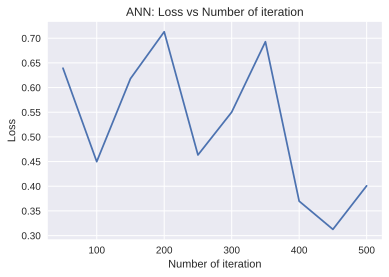

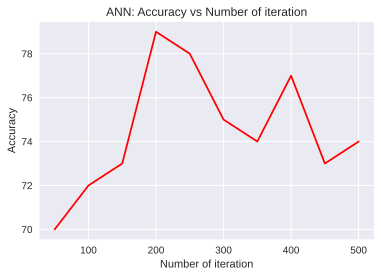

In [ ]:
draw_visualization(it, losses, acs)

**Test**

In [ ]:
_ = load_checkpoint('./resnet18_best_checkpoint', resnet18, optimizer)

Loading checkpoint './resnet18_best_checkpoint'
Loaded checkpoint './resnet18_best_checkpoint' from iteration 200


In [ ]:
with torch.no_grad(): 
  test_outputs = resnet18(test_images)

In [ ]:
predicted = torch.max(test_outputs.data,1)[1]  # [1]
predicted

tensor([0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1,
        0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1])

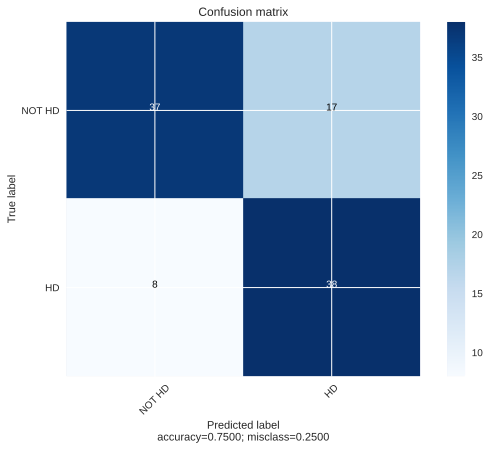

Accuracy: 0.75 
Balanced accuracy: 0.75564 
Multiclass f1-score: 
    micro: 0.75 
    macro: 0.74997 
    weighted: 0.74977


Classification report:

              precision    recall  f1-score   support

           0    0.82222   0.68519   0.74747        54
           1    0.69091   0.82609   0.75248        46

    accuracy                        0.75000       100
   macro avg    0.75657   0.75564   0.74997       100
weighted avg    0.76182   0.75000   0.74977       100



In [ ]:
calc_metrics(test_labels, predicted)

**Conclusion** 

* The ResNet18 model copes much better with this task than the prev. model.

* Simple **accuracy** gives an excellent result-0.75, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.75, which is still good.

* My classifier perfectly identifies the classes pretty good -  0.74 and 0.75, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. 



### **Fine tune**

In [ ]:
resnet18_ft = models.resnet18(pretrained=True)
resnet18_ft.fc = nn.Linear(in_features=512, out_features=classes_num)

**Train**

In [ ]:
# Cross Entropy Loss 
criterion = nn.CrossEntropyLoss()

# Hyper parameters
learning_rate = 0.001 
epochs = 5

# Adam Optimizer
optimizer = torch.optim.Adam(resnet18_ft.parameters(), lr=learning_rate)

In [ ]:
it, losses, acs = train(resnet18_ft, optimizer, criterion,
                        train_loader, val_loader, epochs,
                         checkpoint_path='./resnet18_ft_best_checkpoint')

Epoch 0
Iteration: 50  Loss: 0.6384262442588806  Accuracy: 73.0 %
Saving model and optimizer state at iteration 50 to ./resnet18_ft_best_checkpoint
Iteration: 100  Loss: 0.35629984736442566  Accuracy: 80.0 %
Saving model and optimizer state at iteration 100 to ./resnet18_ft_best_checkpoint
Epoch 1
Iteration: 150  Loss: 0.14041562378406525  Accuracy: 74.0 %
Iteration: 200  Loss: 0.1530560702085495  Accuracy: 84.0 %
Saving model and optimizer state at iteration 200 to ./resnet18_ft_best_checkpoint
Epoch 2
Iteration: 250  Loss: 0.07831572741270065  Accuracy: 78.0 %
Iteration: 300  Loss: 0.10627862811088562  Accuracy: 82.0 %
Epoch 3
Iteration: 350  Loss: 0.03430783003568649  Accuracy: 87.0 %
Saving model and optimizer state at iteration 350 to ./resnet18_ft_best_checkpoint
Iteration: 400  Loss: 0.04618030786514282  Accuracy: 82.0 %
Epoch 4
Iteration: 450  Loss: 0.09132767468690872  Accuracy: 86.0 %
Iteration: 500  Loss: 0.009963569231331348  Accuracy: 86.0 %


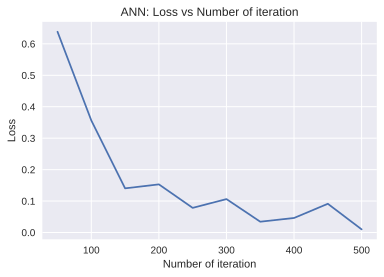

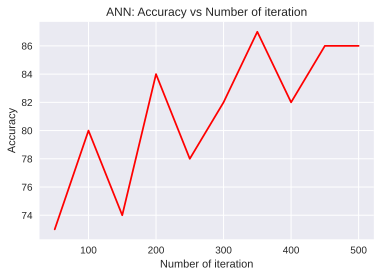

In [ ]:
draw_visualization(it, losses, acs)

**Test**

In [ ]:
_ = load_checkpoint('./resnet18_ft_best_checkpoint', resnet18_ft, optimizer)

Loading checkpoint './resnet18_ft_best_checkpoint'
Loaded checkpoint './resnet18_ft_best_checkpoint' from iteration 350


In [ ]:
with torch.no_grad(): 
  test_outputs = resnet18_ft(test_images)

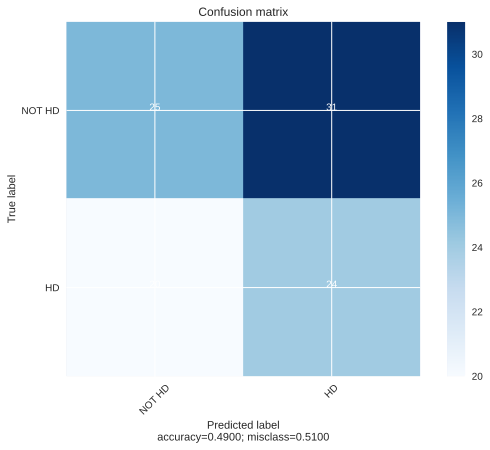

Accuracy: 0.49 
Balanced accuracy: 0.49594 
Multiclass f1-score: 
    micro: 0.49 
    macro: 0.48995 
    weighted: 0.49056


Classification report:

              precision    recall  f1-score   support

           0    0.55556   0.44643   0.49505        56
           1    0.43636   0.54545   0.48485        44

    accuracy                        0.49000       100
   macro avg    0.49596   0.49594   0.48995       100
weighted avg    0.50311   0.49000   0.49056       100



In [ ]:
calc_metrics(test_labels, predicted)

**Conclusion** 

* This model works extrimelly bad, thus I think that we need to tune learning rate more and set more iterations.

* Simple **accuracy** gives poor result-0.49, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.49, which still bad.

* My classifier identifies both classes a little bit better than random model. The values of classes are 0.49 and 0.48, which is not so good. This fact is also confirmed by the **f1-score** metric. 

* This is the worst model in prediction amoung CV models in this notebook. 

## **MobileNet v3**

In [ ]:
mobilenet = models.mobilenet_v3_large(pretrained=True)

Downloading: "https://download.pytorch.org/models/mobilenet_v3_large-8738ca79.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v3_large-8738ca79.pth


  0%|          | 0.00/21.1M [00:00<?, ?B/s]

In [ ]:
summary(mobilenet, (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 32, 32]             432
       BatchNorm2d-2           [-1, 16, 32, 32]              32
         Hardswish-3           [-1, 16, 32, 32]               0
            Conv2d-4           [-1, 16, 32, 32]             144
       BatchNorm2d-5           [-1, 16, 32, 32]              32
              ReLU-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 16, 32, 32]             256
       BatchNorm2d-8           [-1, 16, 32, 32]              32
          Identity-9           [-1, 16, 32, 32]               0
 InvertedResidual-10           [-1, 16, 32, 32]               0
           Conv2d-11           [-1, 64, 32, 32]           1,024
      BatchNorm2d-12           [-1, 64, 32, 32]             128
             ReLU-13           [-1, 64, 32, 32]               0
           Conv2d-14           [-1, 64,

### **Freezed layers**

In [ ]:
set_parameter_requires_grad(mobilenet, freeze=True)

Change output layer

In [ ]:
classes_num = 2

In [ ]:
in_features = mobilenet.classifier[0].out_features
mobilenet.classifier[-1] = nn.Linear(in_features, 2)

In [ ]:
summary(mobilenet, (3, 64, 64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 16, 32, 32]             432
       BatchNorm2d-2           [-1, 16, 32, 32]              32
         Hardswish-3           [-1, 16, 32, 32]               0
            Conv2d-4           [-1, 16, 32, 32]             144
       BatchNorm2d-5           [-1, 16, 32, 32]              32
              ReLU-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 16, 32, 32]             256
       BatchNorm2d-8           [-1, 16, 32, 32]              32
          Identity-9           [-1, 16, 32, 32]               0
 InvertedResidual-10           [-1, 16, 32, 32]               0
           Conv2d-11           [-1, 64, 32, 32]           1,024
      BatchNorm2d-12           [-1, 64, 32, 32]             128
             ReLU-13           [-1, 64, 32, 32]               0
           Conv2d-14           [-1, 64,

**Train**

In [ ]:
# Cross Entropy Loss 
criterion = nn.CrossEntropyLoss()

# Hyper parameters
learning_rate = 0.001 
epochs = 5

# Adam Optimizer
optimizer = torch.optim.Adam(mobilenet.parameters(), lr=learning_rate)

In [ ]:
it, losses, acs =  train(mobilenet, optimizer, criterion, 
                          train_loader, val_loader, 
                          epochs, iter_per_validation=10, 
                          checkpoint_path="./mobilenet_best")

Epoch 0
Iteration: 10  Loss: 0.5409418940544128  Accuracy: 57.0 %
Saving model and optimizer state at iteration 10 to ./mobilenet_best
Iteration: 20  Loss: 0.5432493090629578  Accuracy: 67.0 %
Saving model and optimizer state at iteration 20 to ./mobilenet_best
Iteration: 30  Loss: 0.6368653774261475  Accuracy: 76.0 %
Saving model and optimizer state at iteration 30 to ./mobilenet_best
Iteration: 40  Loss: 0.7581682205200195  Accuracy: 73.0 %
Iteration: 50  Loss: 0.5642757415771484  Accuracy: 73.0 %
Iteration: 60  Loss: 0.4838047921657562  Accuracy: 71.0 %
Iteration: 70  Loss: 0.6061146259307861  Accuracy: 73.0 %
Iteration: 80  Loss: 0.37721195816993713  Accuracy: 71.0 %
Iteration: 90  Loss: 0.6572742462158203  Accuracy: 75.0 %
Iteration: 100  Loss: 0.5549333691596985  Accuracy: 67.0 %
Epoch 1
Iteration: 110  Loss: 0.6558956503868103  Accuracy: 71.0 %
Iteration: 120  Loss: 0.5877552032470703  Accuracy: 68.0 %
Iteration: 130  Loss: 0.43084216117858887  Accuracy: 71.0 %
Iteration: 140  L

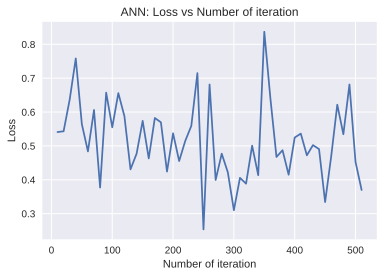

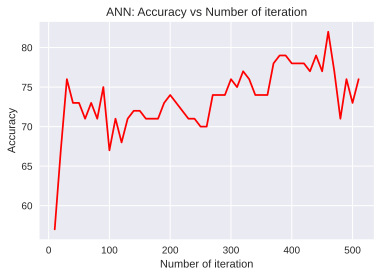

In [ ]:
draw_visualization(it, losses, acs)

**Test**

In [ ]:
_ = load_checkpoint('./mobilenet_best', mobilenet, optimizer)

Loading checkpoint './mobilenet_best'
Loaded checkpoint './mobilenet_best' from iteration 460


In [ ]:
with torch.no_grad(): 
  test_outputs = mobilenet(test_images)

In [ ]:
predicted = torch.max(test_outputs.data,1)[1]  # [1]
predicted

tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0,
        0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0,
        0, 1, 1, 1])

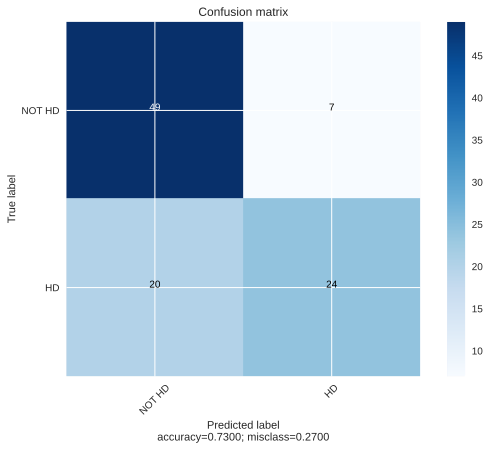

Accuracy: 0.73 
Balanced accuracy: 0.71023 
Multiclass f1-score: 
    micro: 0.73 
    macro: 0.712 
    weighted: 0.72064


Classification report:

              precision    recall  f1-score   support

           0    0.71014   0.87500   0.78400        56
           1    0.77419   0.54545   0.64000        44

    accuracy                        0.73000       100
   macro avg    0.74217   0.71023   0.71200       100
weighted avg    0.73833   0.73000   0.72064       100



In [ ]:
calc_metrics(test_labels, predicted)

**Conclusion** 

* This model copes much better with this task than the prev. one.

* Simple **accuracy** gives an excellent result-0.73, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.71, which is still good.

* My classifier perfectly identifies the classes pretty good -  0.78 and 0.64, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. 



### **Fine tune**

In [ ]:
mobilenet_ft = models.mobilenet_v3_large(pretrained=True)

Change classifier output suitable for our task

In [ ]:
in_features = mobilenet_ft.classifier[0].out_features
mobilenet_ft.classifier[-1] = nn.Linear(in_features, 2)

**Train**

In [ ]:
# Cross Entropy Loss 
criterion = nn.CrossEntropyLoss()

# Hyper parameters
learning_rate = 0.001 
epochs = 5

# Adam Optimizer
optimizer = torch.optim.Adam(mobilenet_ft.parameters(), lr=learning_rate)

In [ ]:
it, losses, acs = train(mobilenet_ft, optimizer, criterion, 
                        train_loader, val_loader, 
                        epochs, iter_per_validation=10,
                        checkpoint_path='./mobilenet_ft_best')

Epoch 0
Iteration: 10  Loss: 0.6633243560791016  Accuracy: 68.0 %
Saving model and optimizer state at iteration 10 to ./mobilenet_ft_best
Iteration: 20  Loss: 0.3891468942165375  Accuracy: 76.0 %
Saving model and optimizer state at iteration 20 to ./mobilenet_ft_best
Iteration: 30  Loss: 0.4651263952255249  Accuracy: 72.0 %
Iteration: 40  Loss: 0.7934346795082092  Accuracy: 72.0 %
Iteration: 50  Loss: 0.2467741221189499  Accuracy: 77.0 %
Saving model and optimizer state at iteration 50 to ./mobilenet_ft_best
Iteration: 60  Loss: 0.25143468379974365  Accuracy: 81.0 %
Saving model and optimizer state at iteration 60 to ./mobilenet_ft_best
Iteration: 70  Loss: 0.15275555849075317  Accuracy: 78.0 %
Iteration: 80  Loss: 0.13459861278533936  Accuracy: 80.0 %
Iteration: 90  Loss: 0.1416659653186798  Accuracy: 79.0 %
Iteration: 100  Loss: 0.2751103639602661  Accuracy: 80.0 %
Epoch 1
Iteration: 110  Loss: 0.19742871820926666  Accuracy: 81.0 %
Iteration: 120  Loss: 0.09027892351150513  Accuracy:

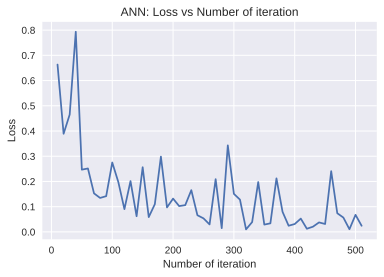

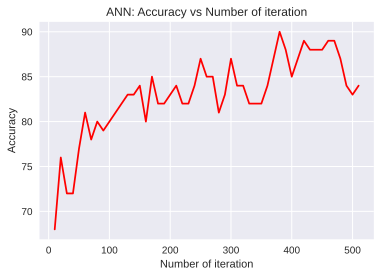

In [ ]:
draw_visualization(it, losses, acs)

**Test**

Load if needed

In [ ]:
_ = load_checkpoint('./mobilenet_ft_best', mobilenet, optimizer)

Loading checkpoint './mobilenet_ft_best'
Loaded checkpoint './mobilenet_ft_best' from iteration 380


In [ ]:
with torch.no_grad(): 
  test_outputs = mobilenet_ft(test_images)

In [ ]:
predicted = torch.max(test_outputs.data,1)[1]  # [1]
predicted

tensor([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0,
        0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0,
        0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0,
        1, 1, 1, 1])

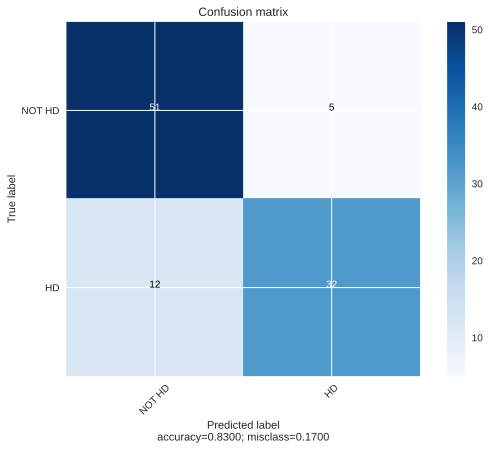

Accuracy: 0.83 
Balanced accuracy: 0.81899 
Multiclass f1-score: 
    micro: 0.83 
    macro: 0.82363 
    weighted: 0.82765


Classification report:

              precision    recall  f1-score   support

           0    0.80952   0.91071   0.85714        56
           1    0.86486   0.72727   0.79012        44

    accuracy                        0.83000       100
   macro avg    0.83719   0.81899   0.82363       100
weighted avg    0.83387   0.83000   0.82765       100



In [ ]:
calc_metrics(test_labels, predicted)

**Conclusion** 

* The fine tune model copes much better with this task than the freezed model.

* Simple **accuracy** gives an excellent result-0.83, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.81, which is still good.

* My classifier perfectly identifies the classes pretty good -  0.85 and 0.79, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. 



# **TensorFlow**

### **Data Loader**

We need to have access to the photos, I prescribe an iterator class that will load each image during iterations, since the dataset is small, I think this method is the most convenient and it is not worth saving pre-processed (augmentation, transformation into tensors, normalization) images in a separate place

In [ ]:
CLASSES_NUM = 2
BATCH_SIZE = 32
LEARNING_RATE = 0.01

In [ ]:
train_files = [f for f in listdir(train_path) if isfile(join(train_path, f))]

test_files = [f for f in listdir(test_path) if isfile(join(test_path, f))]

In [ ]:
class DataGenerator(tf.keras.utils.Sequence):
    def __init__(self, file_list, dir):
        self.file_list = file_list
        self.dir = dir
            
    def __len__(self):
        return len(self.file_list)
    
    def __getitem__(self, idx):
        img = Image.open(os.path.join(self.dir, self.file_list[idx]))
        
        # image_path = os.path.join(self.dir, self.file_list[idx])
        # image = cv2.imread(image_path)
        image = np.array(img)
        image = image.astype('float32')
        image /= 255

        if self.file_list[idx][0] == '0':
          label = 0
          return image, label
        else:
          label = 1
          return image, label
   

In [ ]:
train_df = DataGenerator(train_files, train_path)

test_df = DataGenerator(test_files, test_path)

In [ ]:
len(train_df), len(test_df)

(498, 500)

**Train, Test, Val**

In [ ]:
test_targets = []
test_data = []

for train_img, train_lbl in test_df:
    test_data.append(train_img)
    test_targets.append(train_lbl)

In [ ]:
len(test_data)

500

In [ ]:
from sklearn.model_selection import train_test_split


test_df, val_df, test_targets, val_targets = train_test_split(
    test_data, test_targets, test_size=0.2, stratify=test_targets, random_state=42)

In [ ]:
len(test_df), len(val_df), len(test_targets), len(val_targets)

(400, 100, 400, 100)

In [ ]:
train_add, test_df, train_targets_add, test_targets = train_test_split(
    test_df, test_targets, test_size=0.25, stratify=test_targets, random_state=42)

In [ ]:
len(train_add), len(test_df), len(train_targets_add), len(test_targets)

(300, 100, 300, 100)

**Expand train df**

In [ ]:
def get_df_lbls(df_iter):
  targets = []
  data = []

  for d, lbl in df_iter:
      data.append(d)
      targets.append(lbl)

  return data, targets

In [ ]:
train_df_imgs, train_df_lbls = get_df_lbls(train_df)

In [ ]:
train_add += train_df_imgs # train data
len(train_add)

798

In [ ]:
train_targets_add += train_df_lbls  # train targets
len(train_targets_add)

798

Show df

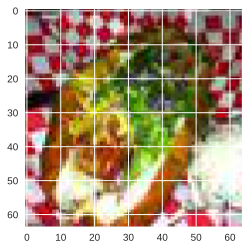

In [ ]:
for img_path in train_files:
    path = os.path.join(train_path,img_path) 
    image = plt.imread(path)
    # Creating a dataset which contains just one image.
    images = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    imshow(images[0])
    show()
    break

### **Augmentation**

Since the initial dataset is extremely small, it is worth expanding it by applying various types of image augmentation. I do this step only on the train dataset, I leave the validation and test "clean". As a result, it turned out about 3000 photos. I think that if the power of the machine allows, then you can take more photos. But it is not a fact that there will be no memory leaks during augmentation (duplicates).

It is just an example,then I used the most appropriate changes in my opinion.

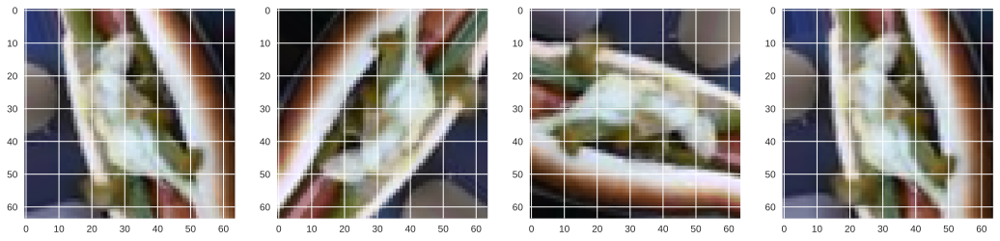

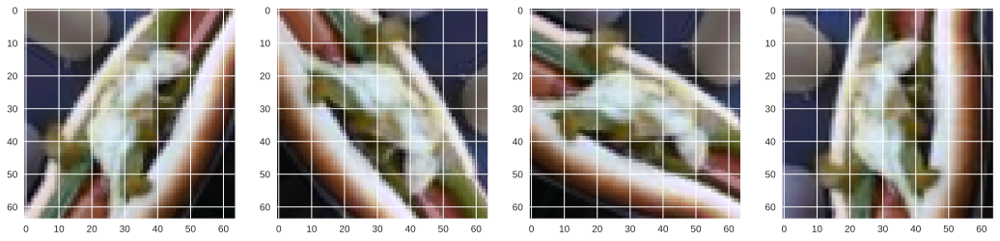

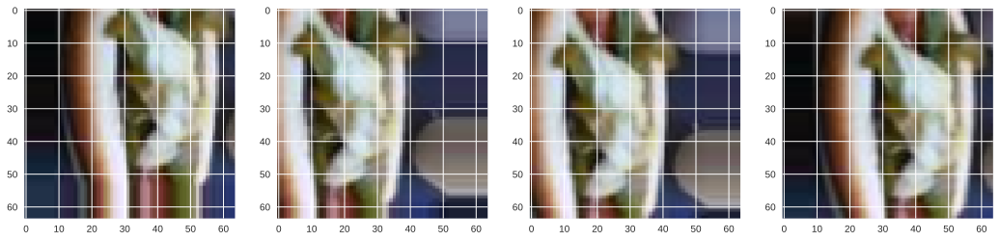

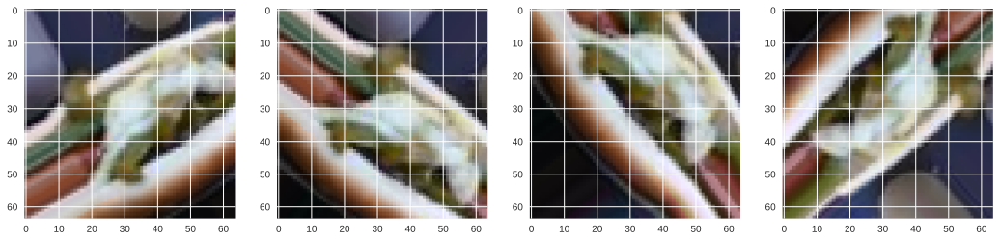

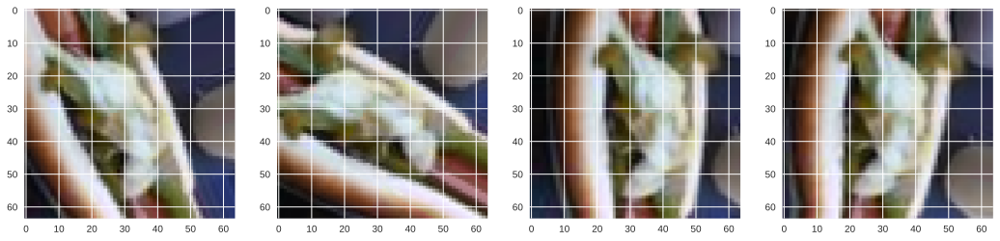

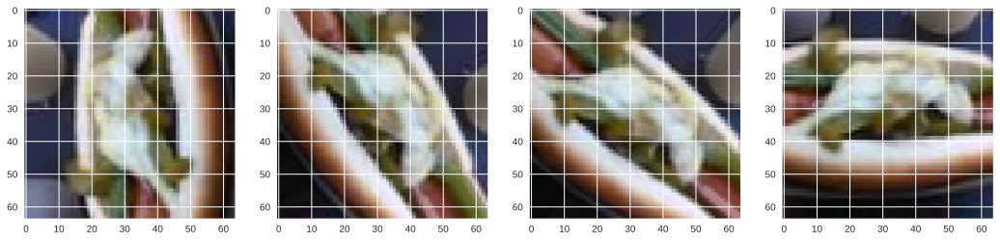

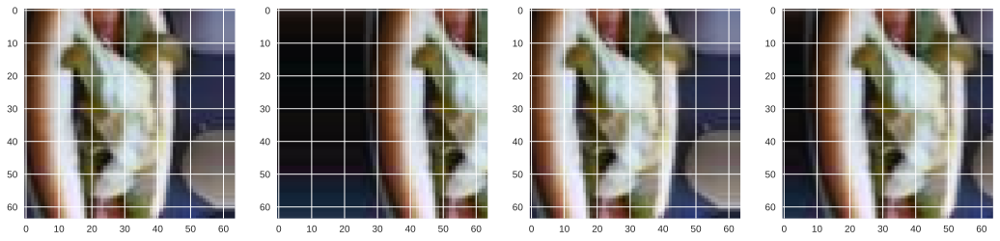

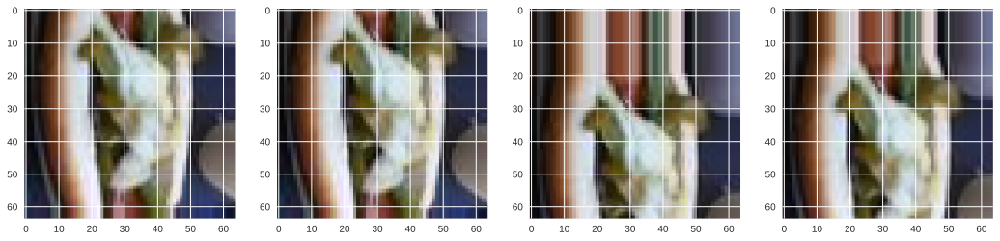

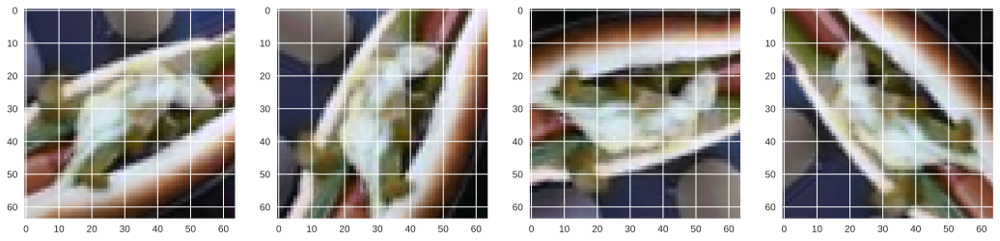

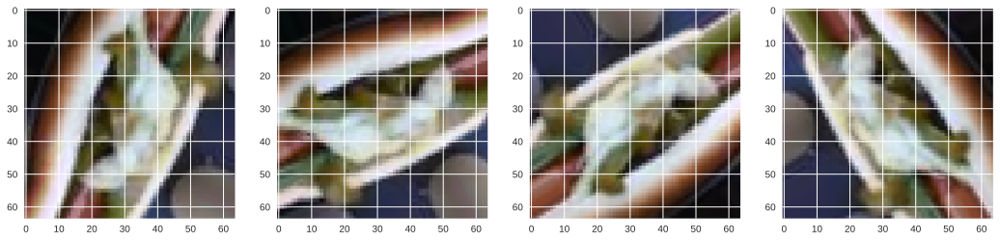

In [ ]:
imageAugmentor(images)

In [ ]:
# # dg_1 = ImageDataGenerator(rotation_range=180)
# dg_2 = ImageDataGenerator(rotation_range=180, zoom_range=0.05)
# dg_3 = ImageDataGenerator(shear_range=0.3, width_shift_range=0.2, height_shift_range=0.2)
# dg_4 = IageDataGenerator(rotation_range=180, width_shift_range=0.4, height_shift_range=0.4)
# dg_5 = ImageDataGenerator(rotation_range=180,  width_shift_range=0.1)
# dg_6 = ImageDataGenerator(rotation_range=180, height_shift_range=0.1)
# dg_7 = ImageDataGenerator(shear_range=0.3, width_shift_range=0.4)
# dg_8 = ImageDataGenerator(shear_range=0.3, height_shift_range=0.4)
# dg_9 = ImageDataGenerator(vertical_flip=True, rotation_range=180)
# dg_10 = ImageDataGenerator(horizontal_flip=True, rotation_range=180)

# # idg_arr = [dg_1, dg_2, dg_3, dg_4, dg_5, dg_6, dg_7, dg_8, dg_9, dg_10]
# # idg_arr = [dg_2, dg_4]

In [ ]:
data_aug_1 = tf.keras.Sequential([
   layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
   layers.experimental.preprocessing.RandomRotation(0.6),
 ]) 

In [ ]:
data_aug_2 = tf.keras.Sequential([
   layers.experimental.preprocessing.RandomZoom(0.3),
   layers.experimental.preprocessing.RandomRotation(0.2),
 ]) 

In [ ]:
data_aug_3 = tf.keras.Sequential([
   layers.experimental.preprocessing.RandomZoom(0.1),
   layers.experimental.preprocessing.RandomRotation(0.4)
 ]) 

In [ ]:
data_aug_4 = tf.keras.Sequential([
   layers.experimental.preprocessing.RandomFlip("horizontal"),
   layers.experimental.preprocessing.RandomRotation(0.5)
 ]) 

In [ ]:
data_aug_5 = tf.keras.Sequential([
   layers.experimental.preprocessing.RandomFlip("vertical"),
   layers.experimental.preprocessing.RandomRotation(0.5)
 ]) 

In [ ]:
def make_df_augmented(dir_path, file_names, aug):
    augm_df = []
    augm_lbls = []

    for f in file_names:
      image_path = os.path.join(dir_path, f)
      image = plt.imread(image_path)
      # augmentation
      aug_image = aug(image)

      image = np.array(image)
      image = image.astype('float32')
      image /= 255

      augm_df.append(image)

      if f[0] == '0':
        augm_lbls.append(0)
      else:
        augm_lbls.append(1)
    
    return augm_df, augm_lbls

In [ ]:
train_aug_1_imgs, train_aug_1_lbls = make_df_augmented(train_path, train_files, data_aug_1)

In [ ]:
train_aug_2_imgs, train_aug_2_lbls = make_df_augmented(train_path, train_files, data_aug_2)

In [ ]:
train_aug_3_imgs, train_aug_3_lbls = make_df_augmented(train_path, train_files, data_aug_3)

In [ ]:
train_aug_4_imgs, train_aug_4_lbls = make_df_augmented(train_path, train_files, data_aug_4)

In [ ]:
train_aug_5_imgs, train_aug_5_lbls = make_df_augmented(train_path, train_files, data_aug_5)

**Concatenate Train df and all augmented dfs**

In [ ]:
 # train data
train_add += train_aug_1_imgs + train_aug_2_imgs + train_aug_3_imgs + train_aug_4_imgs + train_aug_5_imgs
len(train_add)

3288

In [ ]:
# train targets
train_targets_add += train_aug_1_lbls + train_aug_2_lbls + train_aug_3_lbls + train_aug_4_lbls +  train_aug_5_lbls 
len(train_targets_add)

3288

One Hot Enc to target

In [ ]:
train_targets_add_ohe = pd.get_dummies(train_targets_add)
val_targets_ohe = pd.get_dummies(val_targets)
train_targets_add_ohe.shape, val_targets_ohe.shape

((3288, 2), (100, 2))

**Batching and shuffling**

In [ ]:
trainDataset = tf.data.Dataset.from_tensor_slices((train_add, train_targets_add_ohe)).shuffle(42).batch(32)
valDataset = tf.data.Dataset.from_tensor_slices((val_df, val_targets_ohe)).shuffle(42).batch(32)

For pretrained model without OHE (use sigmoid)

In [ ]:
trainDataset_ptm = tf.data.Dataset.from_tensor_slices((train_add, train_targets_add)).shuffle(42).batch(32)
valDataset_ptm = tf.data.Dataset.from_tensor_slices((val_df, val_targets)).shuffle(42).batch(32)

In [ ]:
print(trainDataset)

<BatchDataset shapes: ((None, 64, 64, 3), (None, 2)), types: (tf.float32, tf.uint8)>


In [ ]:
print(valDataset)

<BatchDataset shapes: ((None, 64, 64, 3), (None, 2)), types: (tf.float32, tf.uint8)>


In [ ]:
def img_display(img):
    img = img     # unnormalize
    npimg = img.numpy()
    npimg = np.transpose(npimg, (0,1 , 2))
    return npimg

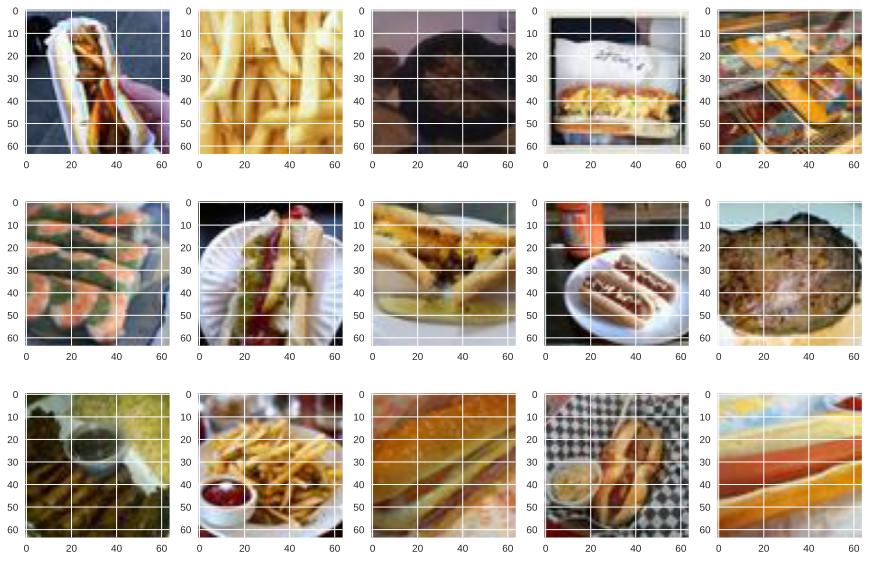

In [ ]:
#  get some random training images

images, labels = next(iter(trainDataset))

arthopod_types = {0: 'NOT HD', 1: 'HD'}
# Viewing data examples used for training
fig, axis = plt.subplots(3, 5, figsize=(15, 10))
for i, ax in enumerate(axis.flat):
    with torch.no_grad():
        image, label = images[i], labels[i]
        ax.imshow(img_display(image)) # add image

### **Baseline Model**

In [ ]:
def conv_block(filters):
    block = tf.keras.Sequential([
        tf.keras.layers.SeparableConv2D(filters, 3, activation='relu', padding='same'),
        tf.keras.layers.SeparableConv2D(filters, 3, activation='relu', padding='same'),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.MaxPool2D()
    ]
    )
    
    return block

In [ ]:
def dense_block(units, dropout_rate):
    block = tf.keras.Sequential([
        tf.keras.layers.Dense(units, activation='relu'),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Dropout(dropout_rate)
    ])
    
    return block

Model

In [ ]:
model_tf = tf.keras.Sequential([
      tf.keras.Input(shape=(64, 64, 3)),
      
      tf.keras.layers.Conv2D(16, 3, activation='relu', padding='same'),
      tf.keras.layers.MaxPool2D(),
      
      conv_block(32),
      conv_block(64),
      
      conv_block(128),
      tf.keras.layers.Dropout(0.2),
      
      conv_block(256),
      tf.keras.layers.Dropout(0.2),
      
      tf.keras.layers.Flatten(),
      # dense_block(512, 0.7),
      dense_block(128, 0.5),
      dense_block(64, 0.3),

      tf.keras.layers.Dense(2, activation='softmax')
  ])

In [ ]:
learning_rate = 0.005  
optimizer = tf.optimizers.Adam(learning_rate=learning_rate)

model_tf.compile(
    optimizer=optimizer, 
    loss='binary_crossentropy',
    metrics=tf.keras.metrics.AUC(name='auc'))

model_tf.summary()

Model: "sequential_86"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_29 (Conv2D)           (None, 64, 64, 16)        448       
_________________________________________________________________
max_pooling2d_58 (MaxPooling (None, 32, 32, 16)        0         
_________________________________________________________________
sequential_80 (Sequential)   (None, 16, 16, 32)        2160      
_________________________________________________________________
sequential_81 (Sequential)   (None, 8, 8, 64)          7392      
_________________________________________________________________
sequential_82 (Sequential)   (None, 4, 4, 128)         27072     
_________________________________________________________________
dropout_35 (Dropout)         (None, 4, 4, 128)         0         
_________________________________________________________________
sequential_83 (Sequential)   (None, 2, 2, 256)       

Tensorflow has a piece of functionality called callbacks that enable us to monitor the models metrcis during training and take some action as a result. Using this functionality I will implement the following:  

**Learning Rate Decay:** If the models loss does not reduce for 2 consecutive epochs, reduce the learning rate. This should stop the model stepping over the optimum too many times.  
**Early Stopping:** If the models loss does not reduce for 5 consecutive epochs then it's clear the model is not learning anything anymore. Save some computation and stop training.  

Note: the verbose parameter simply states whether a message should be printed in the console (1) or not (0) when a callback is made.

In [ ]:
callbacks = [
    tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', patience=2, verbose=1),
    tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5, verbose=1),
]

Train

In [ ]:
epochs_num = 50

history_1 = model_tf.fit(
    trainDataset,
    validation_data=valDataset,
    epochs=epochs_num)
    # ,callbacks=callbacks)

Epoch 1/50
103/103 [==============================] - 5s 25ms/step - loss: 0.5732 - auc: 0.7721 - val_loss: 0.6225 - val_auc: 0.7416
Epoch 2/50
103/103 [==============================] - 2s 20ms/step - loss: 0.5443 - auc: 0.7963 - val_loss: 0.7510 - val_auc: 0.6465
Epoch 3/50
103/103 [==============================] - 2s 19ms/step - loss: 0.5341 - auc: 0.8044 - val_loss: 0.6389 - val_auc: 0.7162
Epoch 4/50
103/103 [==============================] - 2s 19ms/step - loss: 0.5242 - auc: 0.8146 - val_loss: 0.7014 - val_auc: 0.7216
Epoch 5/50
103/103 [==============================] - 2s 20ms/step - loss: 0.5209 - auc: 0.8184 - val_loss: 0.6725 - val_auc: 0.7142
Epoch 6/50
103/103 [==============================] - 2s 20ms/step - loss: 0.5315 - auc: 0.8137 - val_loss: 0.6342 - val_auc: 0.7411
Epoch 7/50
103/103 [==============================] - 2s 19ms/step - loss: 0.5299 - auc: 0.8173 - val_loss: 0.7163 - val_auc: 0.6822
Epoch 8/50
103/103 [==============================] - 2s 19ms/step - 

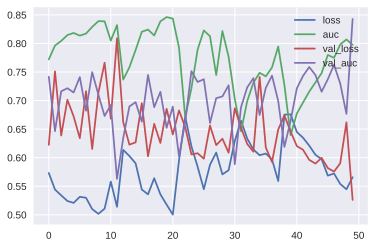

In [ ]:
pd.DataFrame(history_1.history).plot()

Training auc: 0.797600
Validation auc: 0.842800


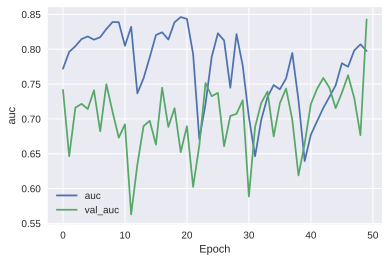

In [ ]:
plt.plot(history_1.history['auc'], label='auc')
plt.plot(history_1.history['val_auc'], label = 'val_auc')
plt.xlabel('Epoch')
plt.ylabel('auc')
plt.legend()

print('Training auc: %f' % history_1.history['auc'][-1])
print('Validation auc: %f' % history_1.history['val_auc'][-1])

**Prediction**

In [ ]:
t_lbls = test_targets.copy()

In [ ]:
test_targets = pd.get_dummies(test_targets)
test_targets.shape

(100, 2)

In [ ]:
testDataset = tf.data.Dataset.from_tensor_slices((test_df, test_targets)).batch(len(test_df))

In [ ]:
print(testDataset)

<BatchDataset shapes: ((None, 64, 64, 3), (None, 2)), types: (tf.float32, tf.uint8)>


In [ ]:
predictions = model_tf.predict(testDataset)
predictions = np.argmax(predictions, axis=1)

In [ ]:
predictions

array([1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0])

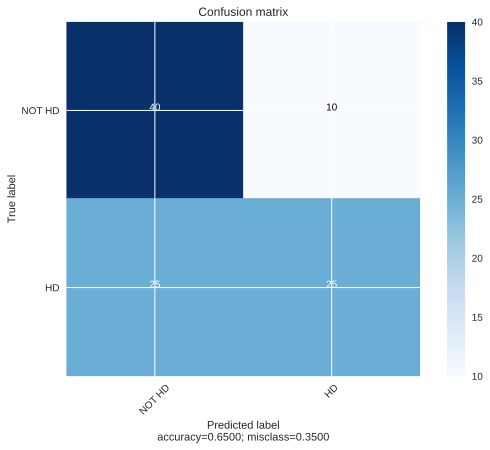

Accuracy: 0.65 
Balanced accuracy: 0.65 
Multiclass f1-score: 
    micro: 0.65 
    macro: 0.64194 
    weighted: 0.64194


Classification report:

              precision    recall  f1-score   support

           0    0.61538   0.80000   0.69565        50
           1    0.71429   0.50000   0.58824        50

    accuracy                        0.65000       100
   macro avg    0.66484   0.65000   0.64194       100
weighted avg    0.66484   0.65000   0.64194       100



In [ ]:
calc_metrics(t_lbls, predictions)

**Conclusion** 

* This model works extrimelly much worth then the prev one. 

* Simple **accuracy** gives poor result-0.65 (a little bit better than random), but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.65, which still not so good.

* My classifier identifies both classes a little bit better than random model. The values of classes are 0.69 and 0.58, which is not so good. This fact is also confirmed by the **f1-score** metric. 



### **Pre-trained model**

### **Densenet**

In [ ]:
from keras.models import Model,Sequential, Input, load_model

In [ ]:
def build_densenet():
    densenet = DenseNet121(weights='imagenet', include_top=False)

    input = Input(shape=(64, 64, 3))
    x = tf.keras.layers.Conv2D(3, (3, 3), padding='same')(input)
    
    x = densenet(x)
    
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Dropout(0.5)(x)
    x = tf.keras.layers.Dense(256, activation='relu')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Dropout(0.5)(x)

    # multi output
    output = tf.keras.layers.Dense(2,activation = 'softmax', name='root')(x)
 

    # model
    model = Model(input,output)
    
    optimizer = tf.optimizers.Adam(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=0.1, decay=0.0)
    model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
    model.summary()
    
    return model

In [ ]:
densenet = build_densenet()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 64, 64, 3)]       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 3)         84        
_________________________________________________________________
densenet121 (Functional)     (None, None, None, 1024)  7037504   
_________________________________________________________________
global_average_pooling2d_2 ( (None, 1024)              0         
_________________________________________________________________
batch_normalization_4 (Batch (None, 1024)              4096      
_________________________________________________________________
dropout_4 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 256)               2624

**Freezed layers**

In [ ]:
for layer in densenet.layers:
    layer.trainable = False

**Train**

In [ ]:
history = densenet.fit_generator(trainDataset, validation_data = valDataset, epochs = 10)

Epoch 1/10
103/103 [==============================] - 238s 2s/step - loss: 0.9959 - accuracy: 0.5243 - val_loss: 0.9903 - val_accuracy: 0.5000
Epoch 2/10
103/103 [==============================] - 224s 2s/step - loss: 0.9077 - accuracy: 0.5560 - val_loss: 0.7955 - val_accuracy: 0.6000
Epoch 3/10
103/103 [==============================] - 227s 2s/step - loss: 0.8422 - accuracy: 0.5733 - val_loss: 0.6608 - val_accuracy: 0.6400
Epoch 4/10
103/103 [==============================] - 230s 2s/step - loss: 0.7683 - accuracy: 0.6043 - val_loss: 0.6010 - val_accuracy: 0.7100
Epoch 5/10
103/103 [==============================] - 231s 2s/step - loss: 0.7300 - accuracy: 0.6335 - val_loss: 0.5466 - val_accuracy: 0.7600
Epoch 6/10
103/103 [==============================] - 236s 2s/step - loss: 0.6774 - accuracy: 0.6533 - val_loss: 0.4791 - val_accuracy: 0.7900
Epoch 7/10
103/103 [==============================] - 232s 2s/step - loss: 0.6514 - accuracy: 0.6585 - val_loss: 0.4535 - val_accuracy: 0.7700

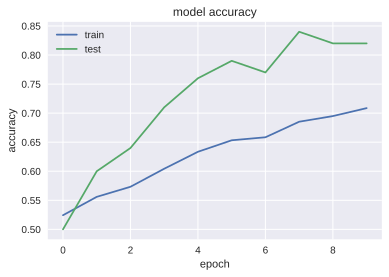

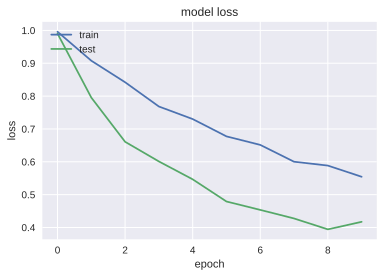

In [ ]:
# accuracy plot 
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# loss plot
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

**Test**

In [ ]:
predictions = densenet.predict(testDataset)
predictions = np.argmax(predictions, axis=1)

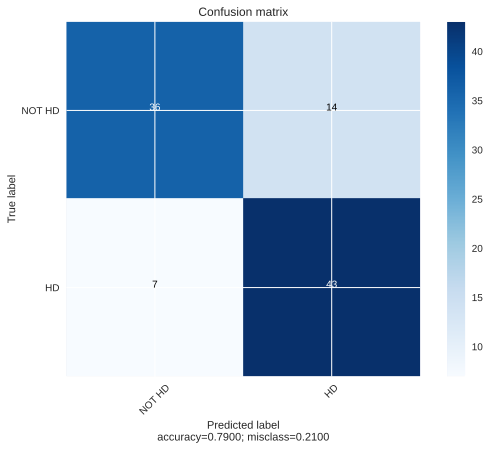

Accuracy: 0.79 
Balanced accuracy: 0.79 
Multiclass f1-score: 
    micro: 0.79 
    macro: 0.78897 
    weighted: 0.78897


Classification report:

              precision    recall  f1-score   support

           0    0.83721   0.72000   0.77419        50
           1    0.75439   0.86000   0.80374        50

    accuracy                        0.79000       100
   macro avg    0.79580   0.79000   0.78897       100
weighted avg    0.79580   0.79000   0.78897       100



In [ ]:
calc_metrics(t_lbls, predictions)

**Conclusion** 

* The freezed model copes much better with this task than the base model.

* Simple **accuracy** gives an excellent result-0.79, but you should not believe this estimate 100 percent, so it's worth looking at a balanced accuracy.

* **Balanced Accuracy** tries to account for the imbalance in the classes and outputs a value of - 0.79, which is still good.

* My classifier perfectly identifies the classes pretty good -  0.77 and 0.80, which is normal, but not so good. This fact is also confirmed by the **f1-score** metric. 


# **General conclusion**  

* The photos presented were of different sizes and very large for working with them (if there is no fast and powerful computer), so it was decided to scale the photos and make 64*64 in size to significantly speed up the training of the model. According to my preliminary assessment, this permission would be sufficient to solve the task.

* Since the train and the test were of the same size 498 and 500 (but we usually divide them to 80:20), I considered it necessary to give 300 samples from the test sample to the train, leave one hundred samples for validation, and one hundred for the test.

* Since the presented dataset is very small, various kinds of augmentation were performed on the photos (train) in order to increase the dataset.

* DatasetLoader classes were written for each library (PyTorch & TensorFlow) to load and pre-process, normalize photos.

* Turning to the evaluation of the results, the highest **accuracy** result of all the models was **0.83**. I think that if we increase the number of epochs, the result may improve, since the most suitable learning rate was selected (by the selection method).

* Speaking of baseline models, it is worth noting that more layers are probably needed for such data, as well as probably more samples in a resolution of 128*128, but this will also significantly increase the training time of the models.

* The best results were obtained by using the model **MobileNet v3 (freezed) - PyTorch**:

      accuracy: 0.83
      f1-score: 0 --> 0.85
                1 --> 0.79

* The worst result was given by the model **ResNet(fine tune) - PyTorch**: 

      accuracy: 0.49
      f1-score: 0 --> 0.49
                1 --> 0.48

* For the future, I would like to say that I can try to download heavier models (VGG16, etc.), also expand the dataset even more and present pictures in a resolution of 128 * 128, but it should be expected that the results will take a long time to wait.